In [ ]:
# mount individual google drive

from google.colab import drive
drive.mount('/content/drive')



Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# this is where the ct scans are
image_folder = '/content/drive/My Drive/CTScans/'
image_file   = image_folder + 'covidctimages.csv'

In [ ]:
# import some basic functionality
import base64
import io

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image

In [ ]:
# import the torch-part
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader



def show_tensor_images(image_tensor, num_images=4, size=(3, 128, 128)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    
    image_grid[image_grid < 0] = 0
    image_grid_abs = torch.abs(image_grid)

    plt.imshow(image_grid.permute(1, 2, 0).squeeze(), cmap="gray")
    plt.show()

# Helper for debugging

In [ ]:
class PrintBlock(nn.Module):
    def forward(self, x):
        print("printblockoutput {}".format(x.shape))
        return x

# Generator

In [ ]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=3, hidden_dim=32):

    #def __init__(self, z_dim=10, im_chan=1, hidden_dim=32):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            #PrintBlock(),
            self.make_gen_block(z_dim, hidden_dim * 8),
            #PrintBlock(),
            self.make_gen_block(hidden_dim * 8, hidden_dim * 4, kernel_size=8, stride=1),
            #PrintBlock(),
            self.make_gen_block(hidden_dim * 4, hidden_dim*2, kernel_size=12, stride=1),
            #PrintBlock(),
            self.make_gen_block(hidden_dim * 2, hidden_dim, kernel_size=10, stride=1),
            #PrintBlock(),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=6, final_layer=True),
            #PrintBlock()
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''

        x = noise.view(len(noise), self.z_dim, 1, 1)

        return self.gen(x)

In [ ]:
def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

# Critic

In [ ]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=3, hidden_dim=32):
    #def __init__(self, im_chan=1, hidden_dim=32):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            #PrintBlock(),
            self.make_crit_block(im_chan, hidden_dim),
            #PrintBlock(),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            #PrintBlock(),
            self.make_crit_block(hidden_dim * 2, hidden_dim * 4, kernel_size=6),
            #PrintBlock(),
            self.make_crit_block(hidden_dim * 4, 1, final_layer=True),
            #PrintBlock(),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        #print(len(image.shape), image.shape)
        #if len(image.shape) == 3:
         #   image = image[:, :, :, None]
          #  image = image.expand(image.shape[0], image.shape[1], image.shape[2], 3)
        

        #if image.shape[3] ==4:
         # print('for aenderung:', image.shape)
          #image = image[:,:,:3] 
          #print('geaendert', image.shape)          



            
        #if image.shape[1] != 3:
        if image.shape[3] !=64:
          #print('for:', image.shape)
          image = image.permute(0, 3, 1, 2)
          #print('after:', image.shape)

        if image.shape[1] == 4:
          image = image[:,:3,:,:]

        #print('vor uebergabe: ', image.shape)  
        image = image.float()

        crit_pred = self.crit(image)


        return crit_pred.view(len(crit_pred), -1)

# Hyperparameters

In [ ]:
n_epochs = 5000
z_dim = 100
display_step = 1000
batch_size = 8
lr = 0.0004
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 7
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

In [ ]:
import os
from torchvision.io import read_image
from torch.utils.data import Dataset
from torchvision import datasets
from torchvision.transforms import ToTensor
import matplotlib.pyplot as plt

class CustomImageDataset(Dataset):
    def __init__(self, metalDatasetPath, imageAmount = 337, transform=None, target_transform=None):
        self.metalDataset = pd.read_csv(metalDatasetPath, delimiter=',', quotechar='"', nrows = imageAmount)
        self.metalDataset = self.cleanDataset(self.metalDataset)
        self.transform = transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.metalDataset)

    def __getitem__(self, idx):
        
        # display an album image
        b64_cover = self.metalDataset['imagedata'].iloc[idx]
        cover_data = base64.b64decode(b64_cover)
        image = Image.open(io.BytesIO(cover_data)).convert('RGB')
        
        #Resize the image
        image = image.resize((64,64))
        
        img_array = np.array(image).astype(int)
        
        label = self.metalDataset['label'].iloc[idx]
        if self.transform:
            img_array = self.transform(img_array)
        if self.target_transform:
            label = self.target_transform(label)


        return img_array, label, self.metalDataset['identifier'].iloc[idx]
    
    def cleanDataset(self, metalDataset):
        '''
        Function for cleaning the NA values of artist_main_genre,artist_name and album_cover_image.
        Furthermore it one-hot-encodes the genre labels to make it readable for the GAN.
        Parameters:
                metalDataset: Dataset from https://www.kaggle.com/benjamnmachn/metal-album-artwork-dataset-intro/data as a df
            
        '''
        metalDatasetClean = self.metalDataset[self.metalDataset['identifier'].notna()]
        metalDatasetClean = metalDatasetClean[metalDatasetClean['imagedata'].notna()]
        metalDatasetClean = metalDatasetClean[metalDatasetClean['label'].notna()]
        
        
    
        #metalDatasetClean['artist_main_genre_label'] = metalDatasetClean['artist_main_genre']
        #metalDatasetClean.artist_main_genre_label = pd.Categorical(pd.factorize(metalDatasetClean.artist_main_genre_label)[0])
        
        #metalDatasetClean = metalDatasetClean[metalDatasetClean['artist_main_genre_label']==15]
        
        return metalDatasetClean

In [ ]:
from torch.utils.data import DataLoader

train_dataset = CustomImageDataset(image_file)
train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True, num_workers=0)

In [ ]:
# Display image and label.

for i in range(0,337):
  train_features, train_labels, train_id = next(iter(train_dataloader))
  #print(len(train_features.shape))
  if len(train_features.shape) == 3:
    print('found', train_id)
  if train_features.shape[2] == 3:
    print('found', train_id)
  if train_features.shape[0] == 1:
    print( train_features.shape,'found', train_id)
    




torch.Size([1, 64, 64, 3]) found ('2020.03.18.20038125-p16-56-2.png',)
torch.Size([1, 64, 64, 3]) found ('2020.03.22.20040782-p24-1533-6.png',)
torch.Size([1, 64, 64, 3]) found ('2020.02.25.20021568-p24-111%6.png',)
torch.Size([1, 64, 64, 3]) found ('2020.03.19.20038539-p10-59.png',)
torch.Size([1, 64, 64, 3]) found ('2020.02.27.20027557-p25-137%2.png',)
torch.Size([1, 64, 64, 3]) found ('2020.03.01.20029769-p21-73_3.png',)
torch.Size([1, 64, 64, 3]) found ('impact_of_covid19_infection_on_pregnancy_outcomes_and_the_risk_of_maternaltoneonatal_intrapartum_transmission_of_covid19_during_natural_birth-p8-41%1.png',)
torch.Size([1, 64, 64, 3]) found ('2020.03.04.20031039-p23-97_2%2.png',)
torch.Size([1, 64, 64, 3]) found ('1-s2.0-S0929664620300449-gr3_lrg-c.jpg',)
torch.Size([1, 64, 64, 3]) found ('2020.02.25.20021568-p24-111%1.png',)
torch.Size([1, 64, 64, 3]) found ('2020.02.25.20021568-p23-108%2.png',)
torch.Size([1, 64, 64, 3]) found ('ehaa254-p0-63%2.png',)
torch.Size([1, 64, 64, 3]) f

In [ ]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


In [ ]:
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together

    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad

        inputs=mixed_images,
        outputs=mixed_scores,

        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [ ]:
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.reshape(len(gradient), -1) #view

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1

    penalty = torch.mean((gradient_norm -1 )**2)

    return penalty

In [ ]:
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''

    gen_loss = -1*torch.mean(crit_fake_pred)

    return gen_loss

In [ ]:
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''

    crit_loss = torch.mean(crit_fake_pred)-torch.mean(crit_real_pred) + c_lambda * gp

    return crit_loss

# Train the model

In [ ]:
#PATHS where to save/load

PATH_GENERATOR = "/content/drive/My Drive/CTScans/covid_generator.pth"
PATH_CRITIC    = "/content/drive/My Drive/CTScans/covid_critic.pth"

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 2, step 1000: Generator loss: -0.6939782929392532, critic loss: 10.981567593785261
################FAKE#################


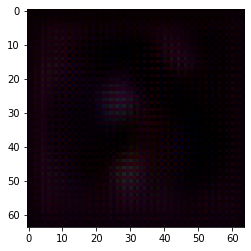

################REAL#################


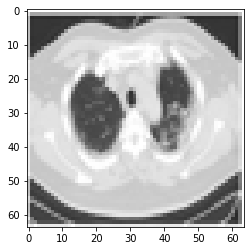

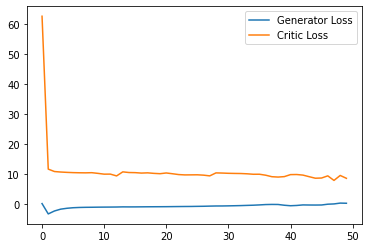

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 5, step 2000: Generator loss: -8.013847047438846, critic loss: -7.161403768122196
################FAKE#################


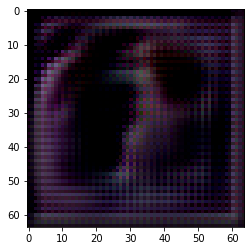

################REAL#################


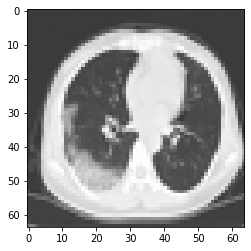

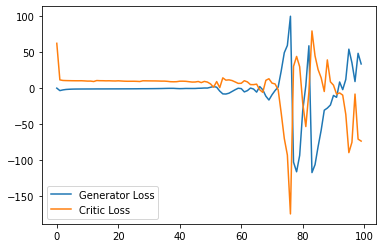

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 8, step 3000: Generator loss: -11.529038269871846, critic loss: -20.02815115471397
################FAKE#################


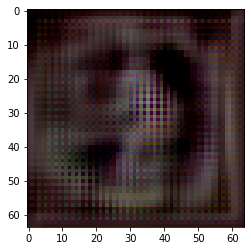

################REAL#################


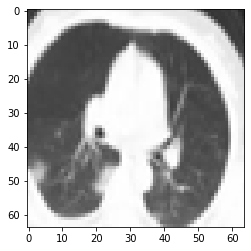

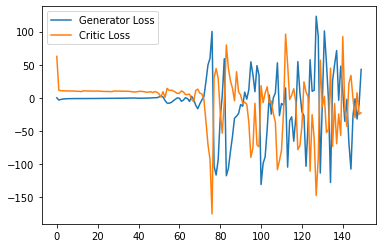

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 11, step 4000: Generator loss: -11.550875470667146, critic loss: -22.738669599290418
################FAKE#################


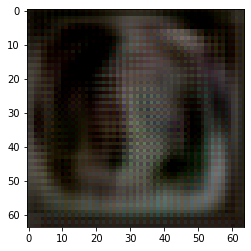

################REAL#################


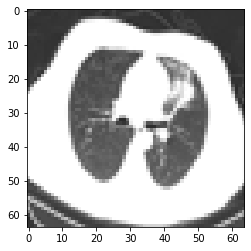

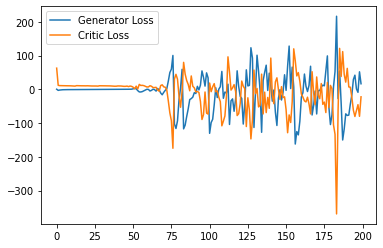

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 14, step 5000: Generator loss: -32.34298858509585, critic loss: -19.72573838012556
################FAKE#################


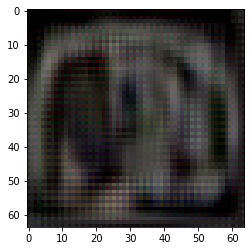

################REAL#################


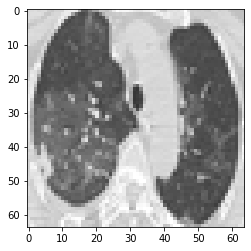

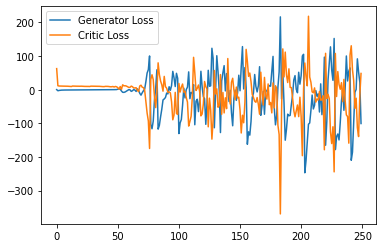

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 17, step 6000: Generator loss: -13.473025753974914, critic loss: -41.93760008046454
################FAKE#################


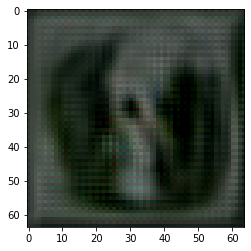

################REAL#################


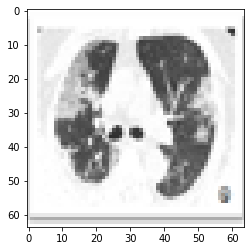

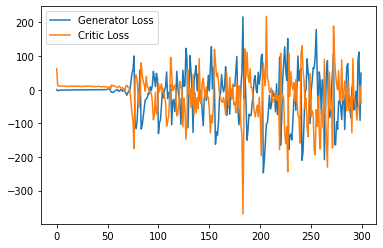

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 20, step 7000: Generator loss: -13.42286747893691, critic loss: -16.429404276941536
################FAKE#################


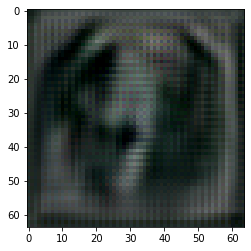

################REAL#################


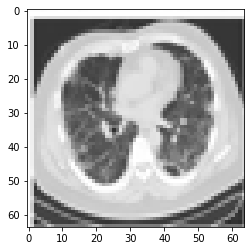

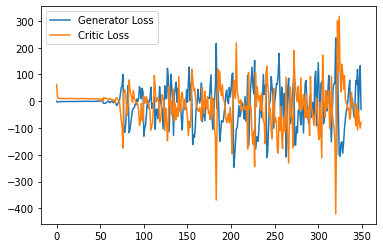

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 23, step 8000: Generator loss: -4.303561303377151, critic loss: -58.54160021902835
################FAKE#################


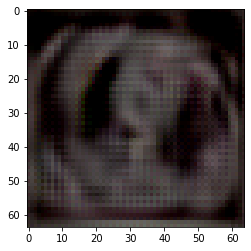

################REAL#################


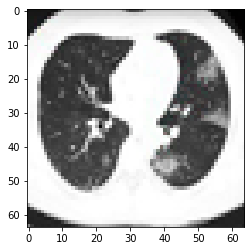

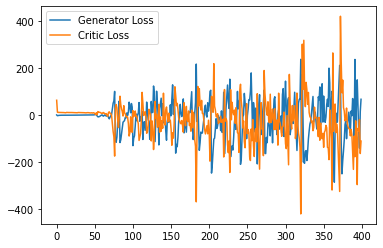

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 26, step 9000: Generator loss: -98.57269901236891, critic loss: -4.4066083723988045
################FAKE#################


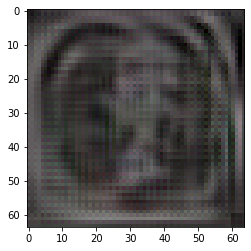

################REAL#################


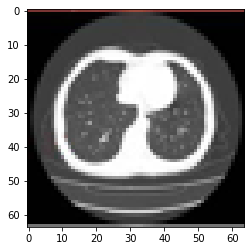

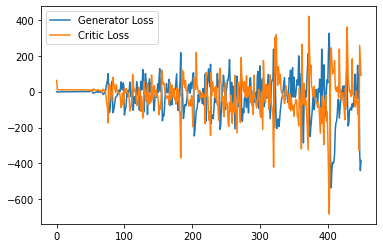

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 29, step 10000: Generator loss: -43.55320455303788, critic loss: -22.836505703249152
################FAKE#################


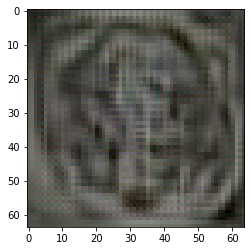

################REAL#################


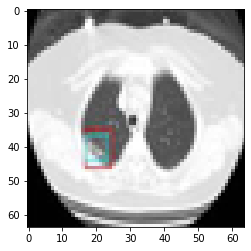

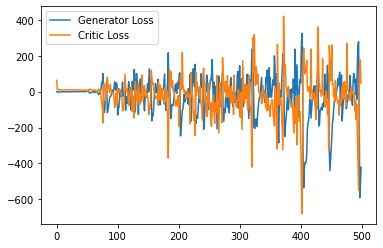

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 32, step 11000: Generator loss: -21.497897331990302, critic loss: -12.75683018178598
################FAKE#################


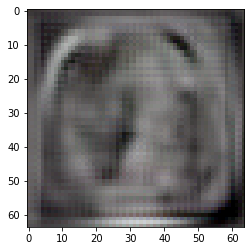

################REAL#################


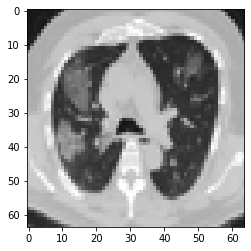

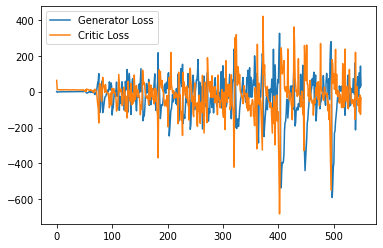

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 35, step 12000: Generator loss: -13.47329475518316, critic loss: -25.456559313075903
################FAKE#################


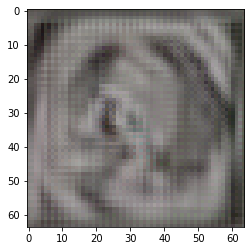

################REAL#################


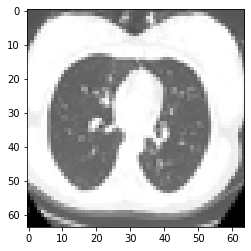

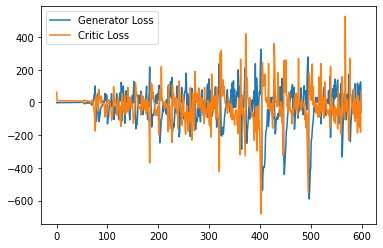

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 38, step 13000: Generator loss: -12.669234592378139, critic loss: -53.01769796723128
################FAKE#################


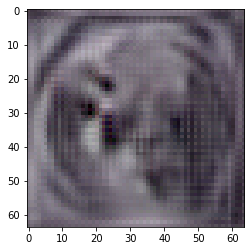

################REAL#################


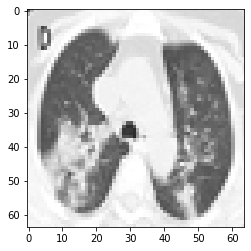

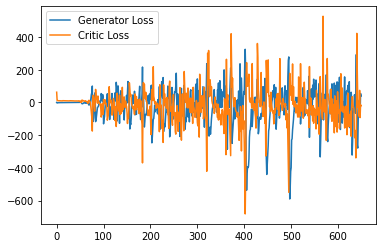

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 41, step 14000: Generator loss: 16.767444522060455, critic loss: -48.51593568156446
################FAKE#################


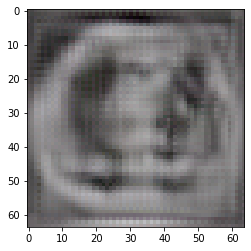

################REAL#################


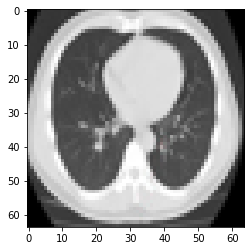

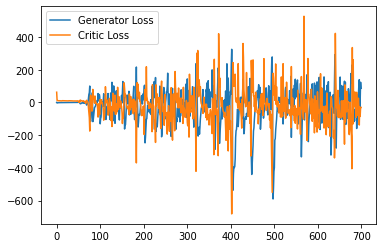

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 44, step 15000: Generator loss: 17.013155247300862, critic loss: -65.97241349794187
################FAKE#################


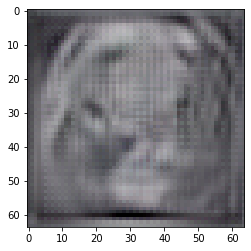

################REAL#################


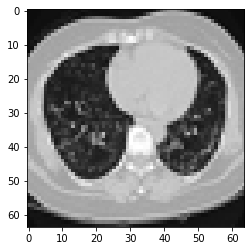

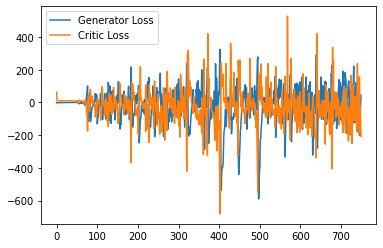

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 47, step 16000: Generator loss: 47.13371535989642, critic loss: -74.30728113374545
################FAKE#################


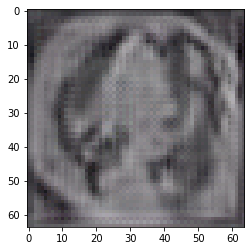

################REAL#################


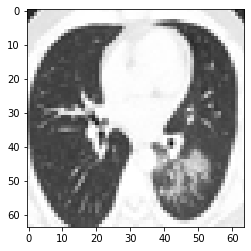

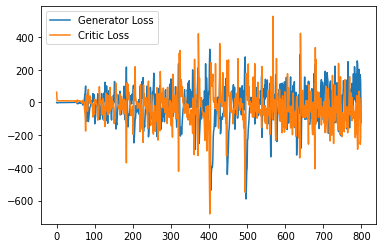

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 50, step 17000: Generator loss: 26.26311946645379, critic loss: -64.65478003209401
################FAKE#################


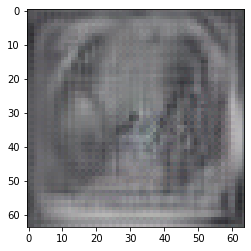

################REAL#################


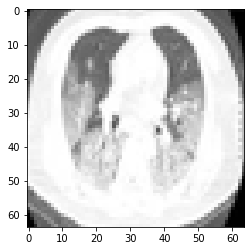

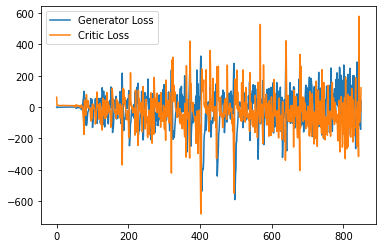

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 53, step 18000: Generator loss: 63.835857956022025, critic loss: -100.88748116614138
################FAKE#################


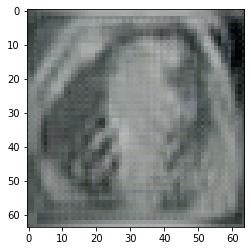

################REAL#################


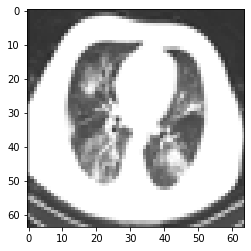

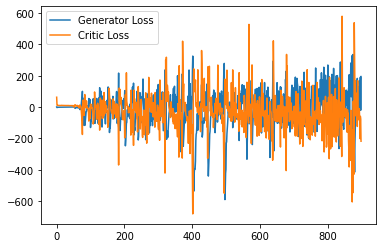

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 56, step 19000: Generator loss: 80.50099812502042, critic loss: -98.43022705445956
################FAKE#################


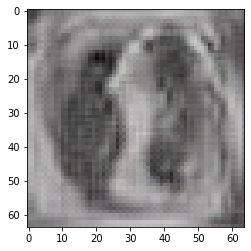

################REAL#################


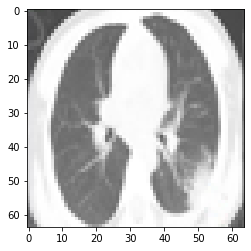

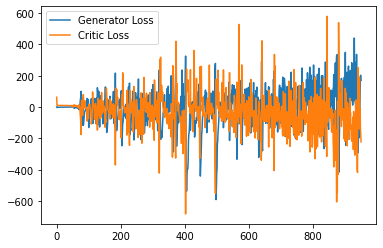

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 59, step 20000: Generator loss: -30.22892580071092, critic loss: -17.103637452644925
################FAKE#################


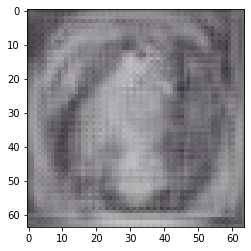

################REAL#################


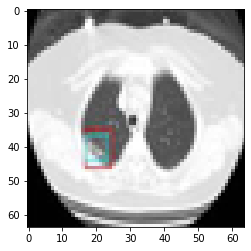

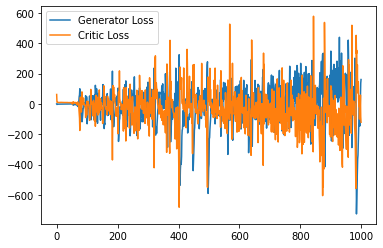

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 62, step 21000: Generator loss: 77.67354564505816, critic loss: -99.47844592829256
################FAKE#################


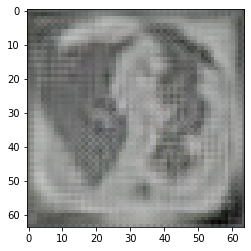

################REAL#################


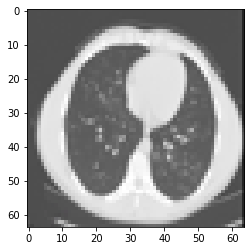

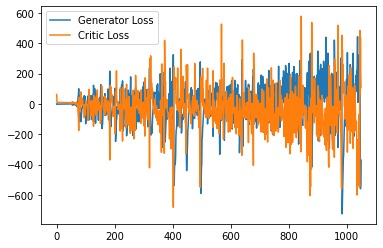

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 65, step 22000: Generator loss: 59.32003023168445, critic loss: -61.73545272978716
################FAKE#################


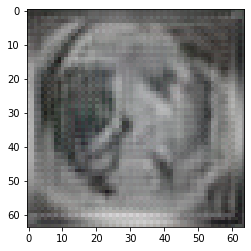

################REAL#################


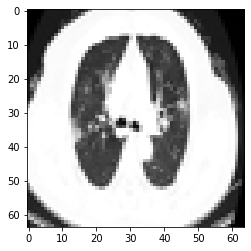

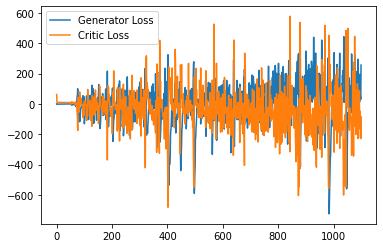

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 68, step 23000: Generator loss: 232.70994290781022, critic loss: -245.48324338388443
################FAKE#################


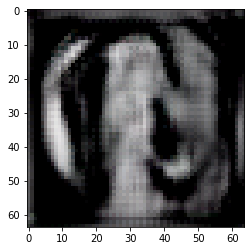

################REAL#################


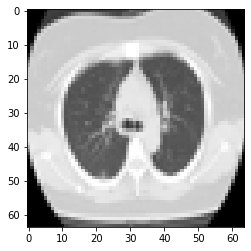

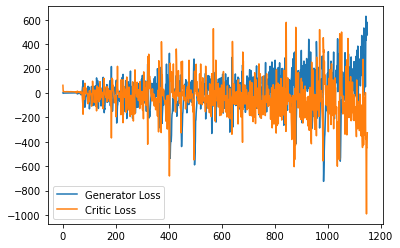

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 71, step 24000: Generator loss: 332.80959371194245, critic loss: -367.0551532225267
################FAKE#################


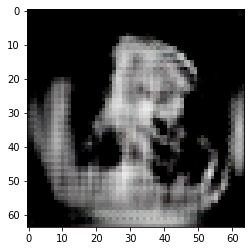

################REAL#################


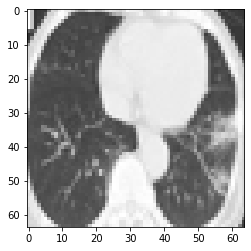

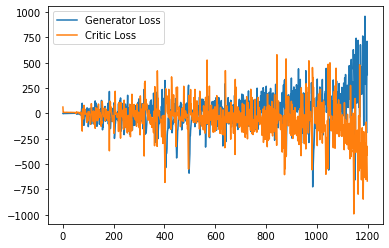

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 74, step 25000: Generator loss: 878.7489924592971, critic loss: -871.4590219552612
################FAKE#################


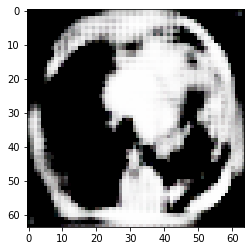

################REAL#################


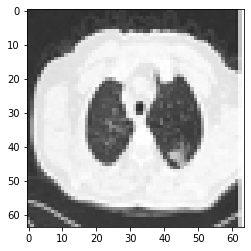

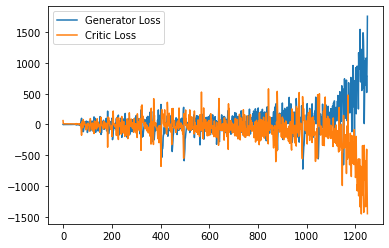

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 77, step 26000: Generator loss: 1592.6361506271362, critic loss: -1254.8768079385168
################FAKE#################


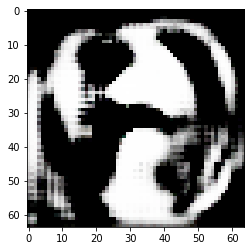

################REAL#################


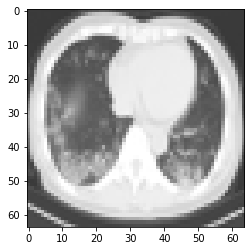

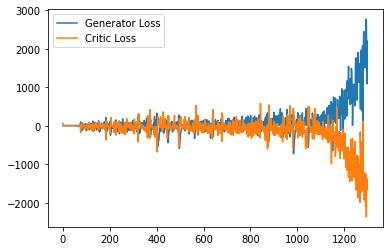

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 80, step 27000: Generator loss: 1927.2667128481864, critic loss: -1442.6546131434436
################FAKE#################


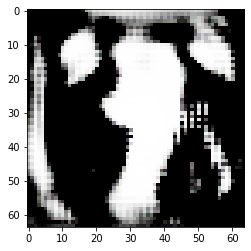

################REAL#################


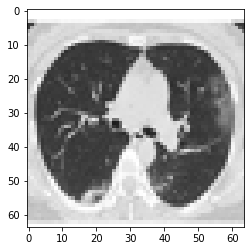

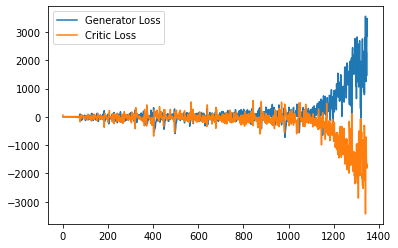

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 83, step 28000: Generator loss: 2421.446524045944, critic loss: -1536.9762466607779
################FAKE#################


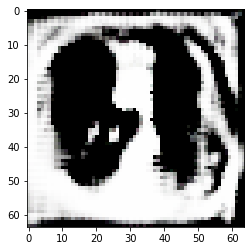

################REAL#################


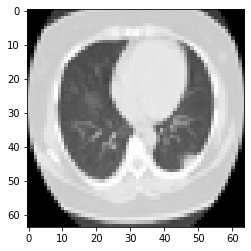

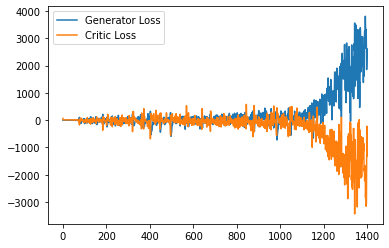

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 86, step 29000: Generator loss: 3155.9243046875, critic loss: -1801.4520676404409
################FAKE#################


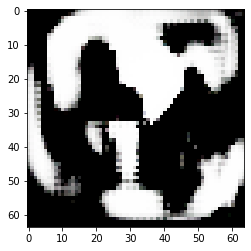

################REAL#################


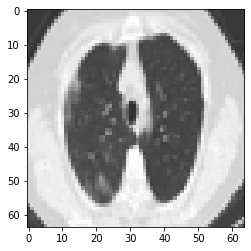

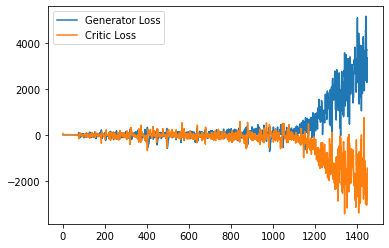

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 89, step 30000: Generator loss: 3259.0748557624815, critic loss: -1776.9912280153867
################FAKE#################


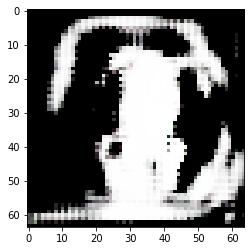

################REAL#################


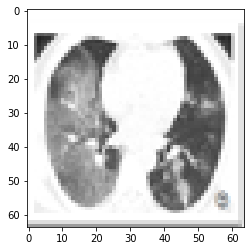

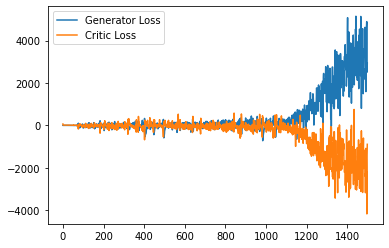

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 92, step 31000: Generator loss: 3081.3370472337006, critic loss: -1620.7171852817532
################FAKE#################


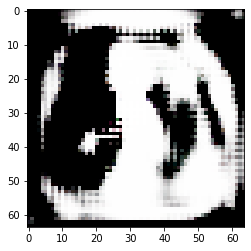

################REAL#################


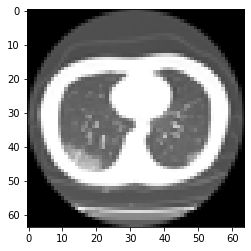

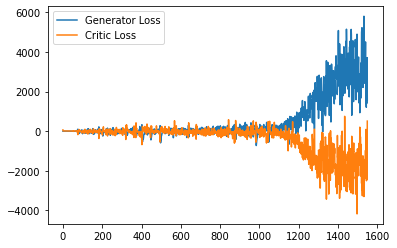

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 95, step 32000: Generator loss: 4022.5698819265367, critic loss: -2201.343438908509
################FAKE#################


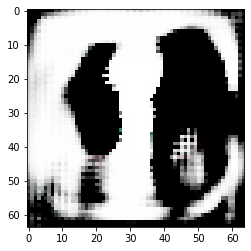

################REAL#################


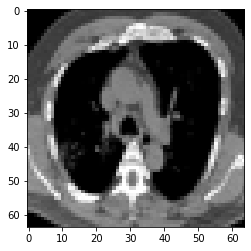

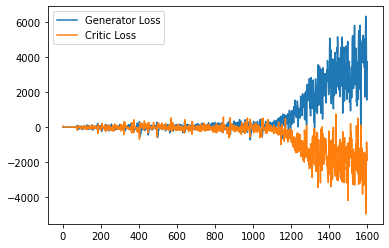

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 98, step 33000: Generator loss: 4227.138166625977, critic loss: -2065.2204169413003
################FAKE#################


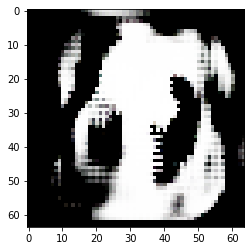

################REAL#################


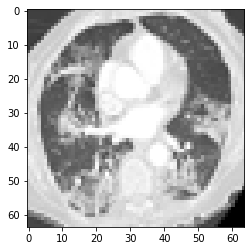

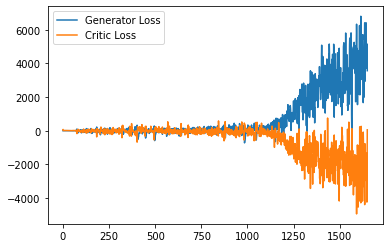

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 101, step 34000: Generator loss: 4519.214052490234, critic loss: -2020.9756984097626
################FAKE#################


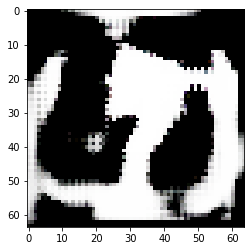

################REAL#################


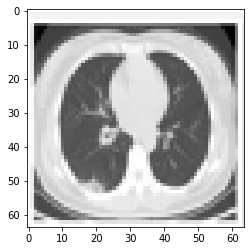

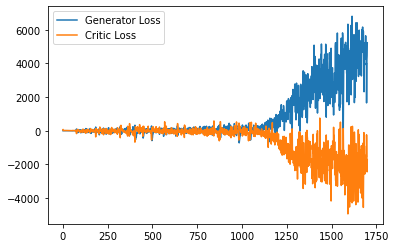

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 104, step 35000: Generator loss: 4760.383783752442, critic loss: -2120.7759392935895
################FAKE#################


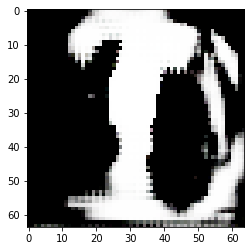

################REAL#################


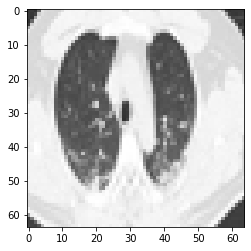

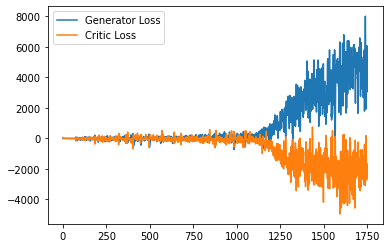

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 107, step 36000: Generator loss: 4837.691379760742, critic loss: -2247.5285799022386
################FAKE#################


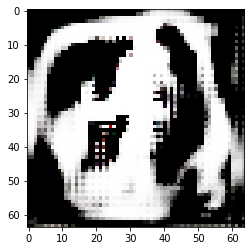

################REAL#################


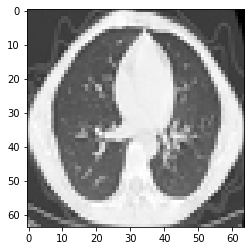

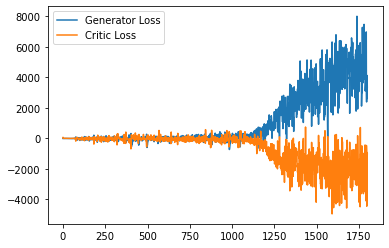

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 110, step 37000: Generator loss: 4647.406196899414, critic loss: -1723.306924334865
################FAKE#################


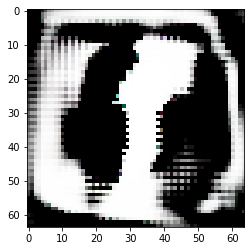

################REAL#################


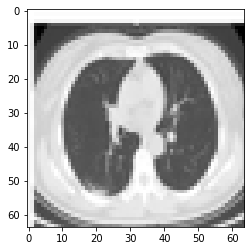

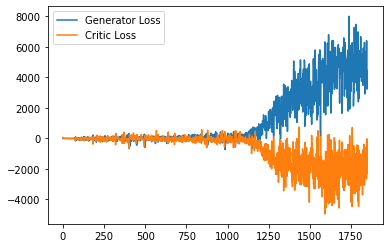

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 113, step 38000: Generator loss: 4998.602956888199, critic loss: -2106.305297002453
################FAKE#################


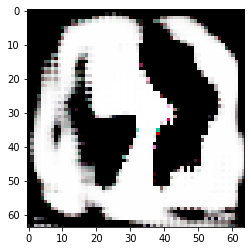

################REAL#################


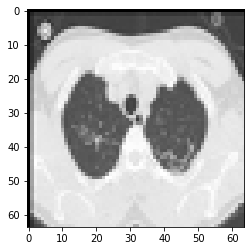

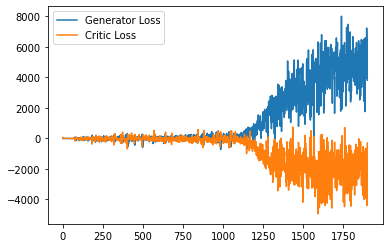

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 116, step 39000: Generator loss: 5277.253113830567, critic loss: -2296.4096842278072
################FAKE#################


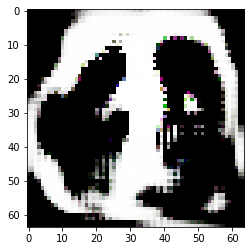

################REAL#################


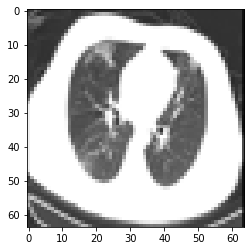

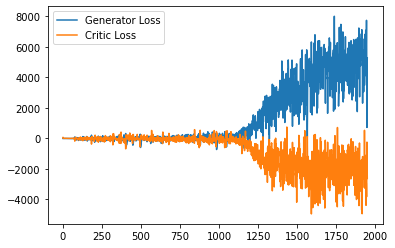

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 119, step 40000: Generator loss: 5392.665622802734, critic loss: -2072.9614748281933
################FAKE#################


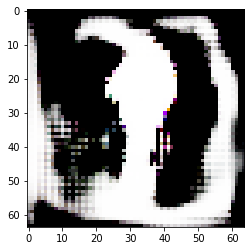

################REAL#################


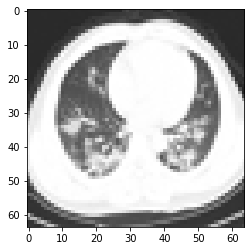

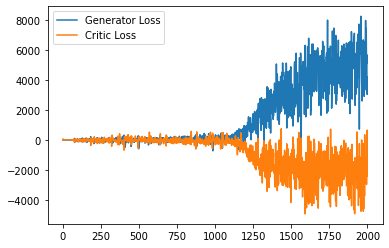

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 122, step 41000: Generator loss: 5506.385751556397, critic loss: -2169.231448415485
################FAKE#################


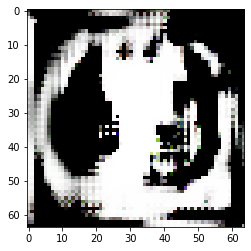

################REAL#################


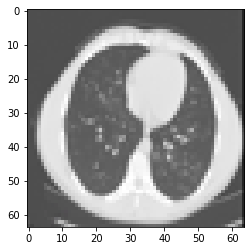

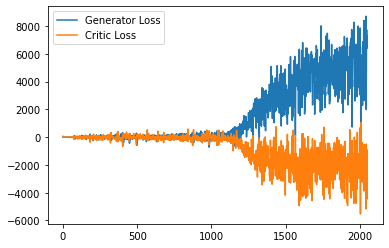

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 125, step 42000: Generator loss: 5742.445645301819, critic loss: -2178.972747732232
################FAKE#################


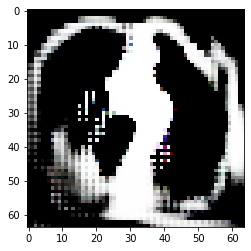

################REAL#################


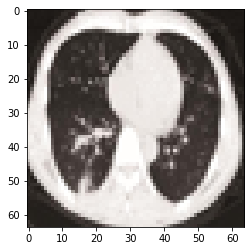

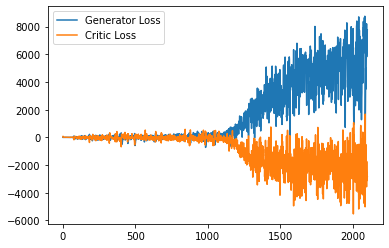

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 127, step 43000: Generator loss: 5661.118509643555, critic loss: -2165.1107198690706
################FAKE#################


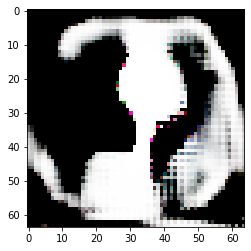

################REAL#################


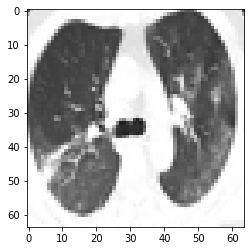

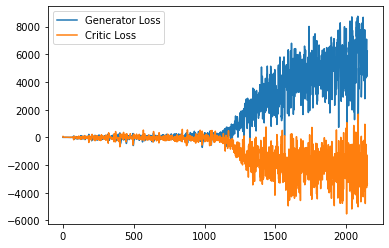

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 130, step 44000: Generator loss: 6308.152701660156, critic loss: -2523.9957487599527
################FAKE#################


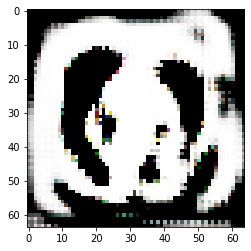

################REAL#################


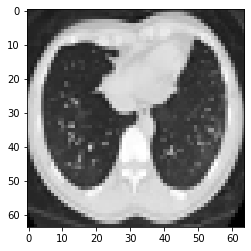

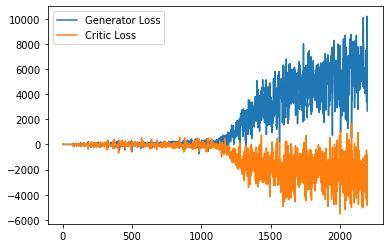

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 133, step 45000: Generator loss: 6390.36887109375, critic loss: -2306.600091249806
################FAKE#################


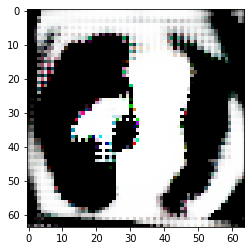

################REAL#################


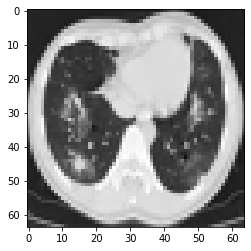

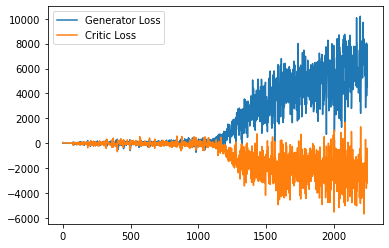

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 136, step 46000: Generator loss: 6135.777619628906, critic loss: -2226.499907302859
################FAKE#################


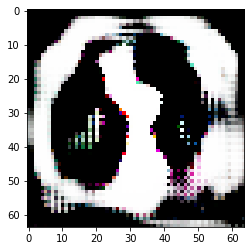

################REAL#################


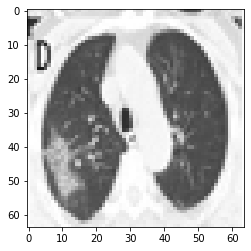

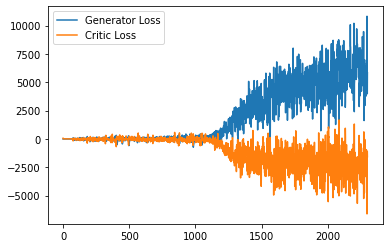

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 139, step 47000: Generator loss: 6806.6333930053715, critic loss: -2500.762384045804
################FAKE#################


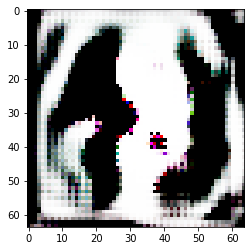

################REAL#################


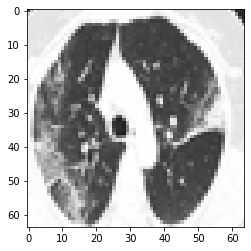

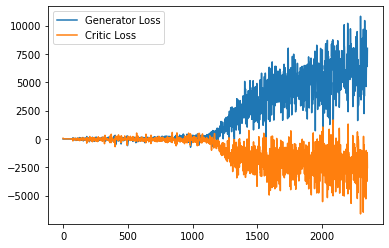

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 142, step 48000: Generator loss: 6956.1179479980465, critic loss: -2512.2068985026226
################FAKE#################


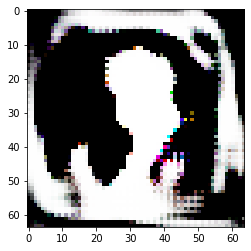

################REAL#################


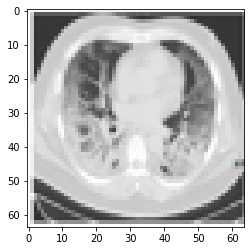

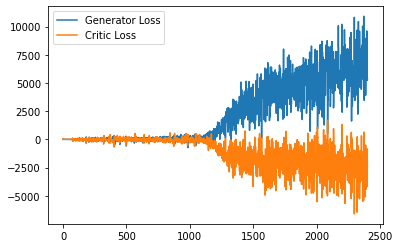

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 145, step 49000: Generator loss: 7259.1132978515625, critic loss: -2601.976610956737
################FAKE#################


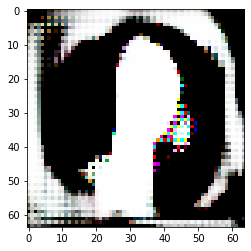

################REAL#################


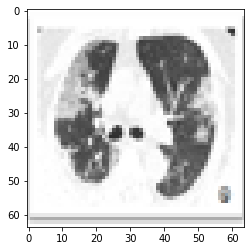

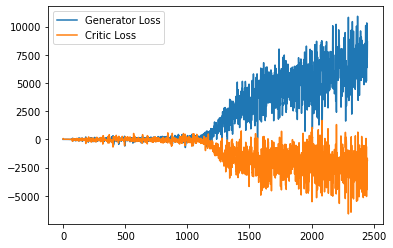

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 148, step 50000: Generator loss: 6803.746409667969, critic loss: -2512.0840135425797
################FAKE#################


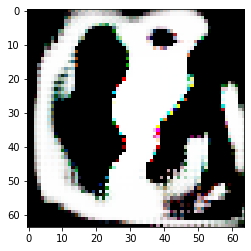

################REAL#################


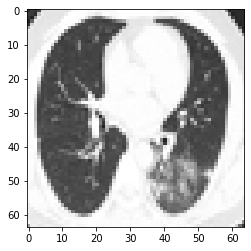

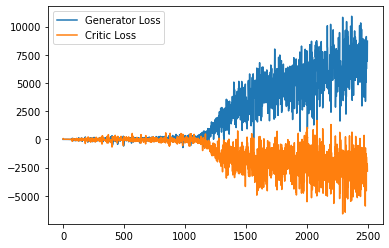

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 151, step 51000: Generator loss: 6723.393975585937, critic loss: -2086.317429804938
################FAKE#################


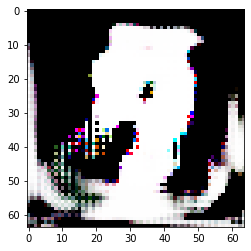

################REAL#################


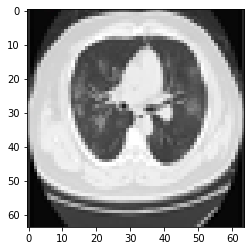

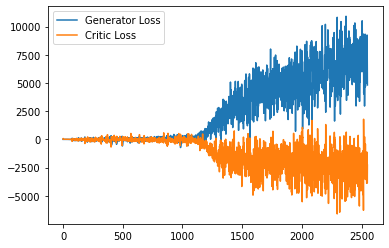

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 154, step 52000: Generator loss: 7260.36075, critic loss: -2414.0182333823604
################FAKE#################


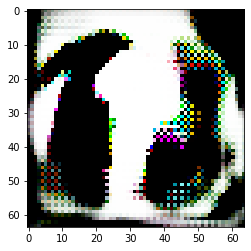

################REAL#################


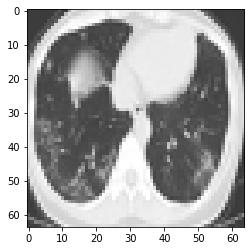

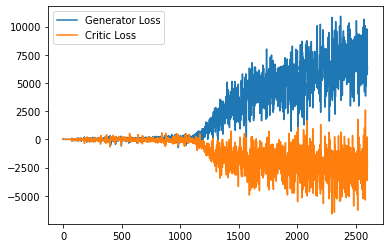

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 157, step 53000: Generator loss: 7593.5500863037105, critic loss: -2673.6390798602765
################FAKE#################


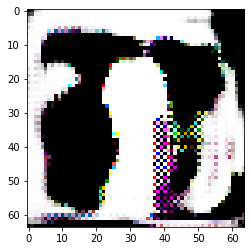

################REAL#################


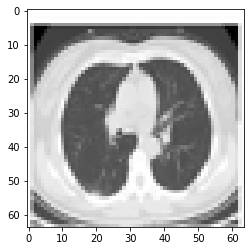

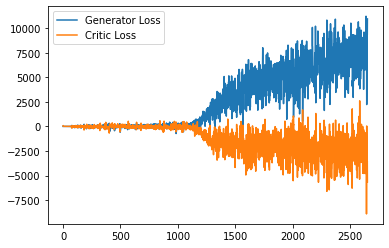

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 160, step 54000: Generator loss: 8207.092818603516, critic loss: -2805.842342317584
################FAKE#################


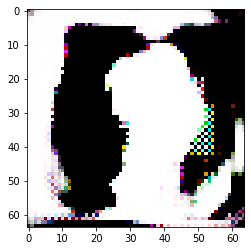

################REAL#################


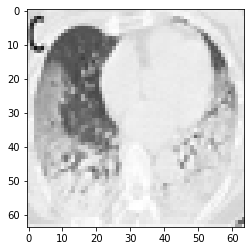

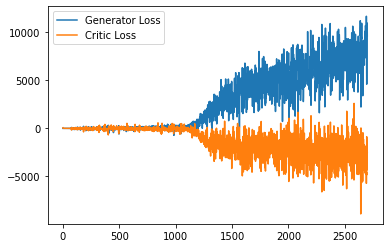

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 163, step 55000: Generator loss: 8423.736405517579, critic loss: -2956.489488366264
################FAKE#################


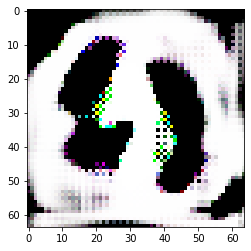

################REAL#################


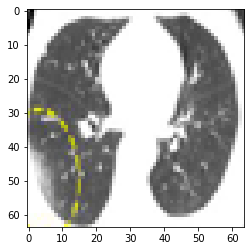

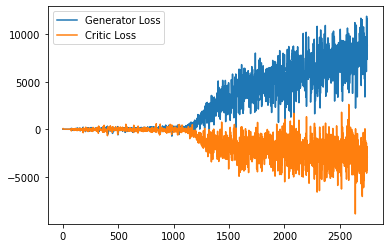

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 166, step 56000: Generator loss: 7739.687162231446, critic loss: -2342.6286692120716
################FAKE#################


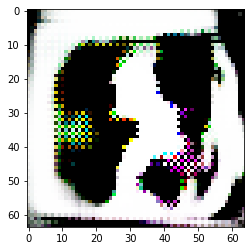

################REAL#################


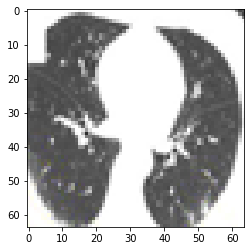

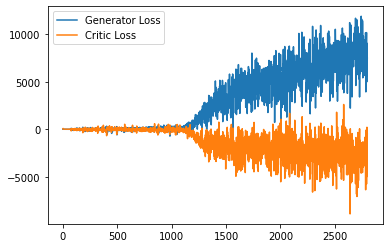

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 169, step 57000: Generator loss: 9134.156390625, critic loss: -2923.3708744942755
################FAKE#################


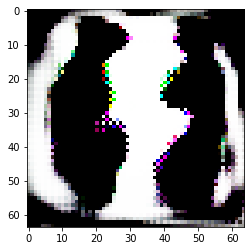

################REAL#################


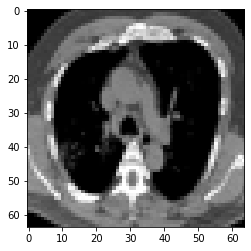

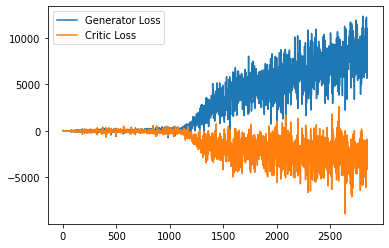

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 172, step 58000: Generator loss: 9105.320928466797, critic loss: -2903.961823543548
################FAKE#################


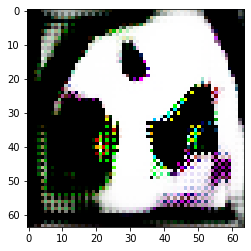

################REAL#################


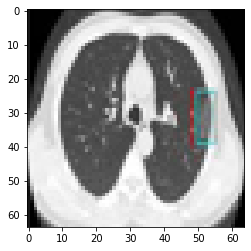

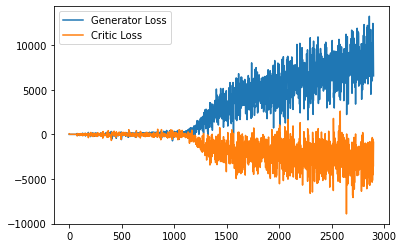

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 175, step 59000: Generator loss: 9274.779459960937, critic loss: -2841.2262896417897
################FAKE#################


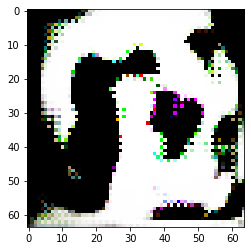

################REAL#################


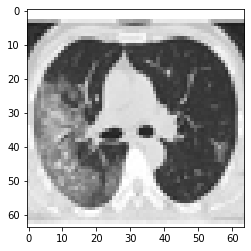

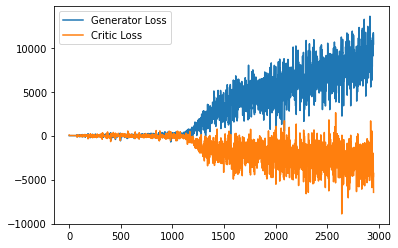

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 178, step 60000: Generator loss: 8865.287966552734, critic loss: -2630.656172407967
################FAKE#################


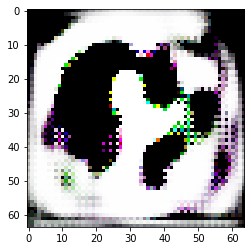

################REAL#################


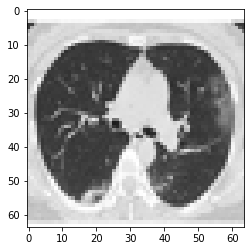

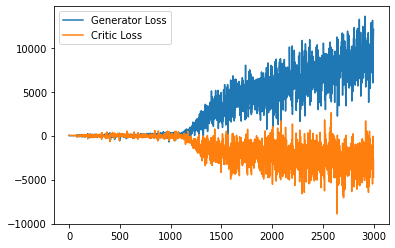

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 181, step 61000: Generator loss: 9606.87678466797, critic loss: -3031.1744994829705
################FAKE#################


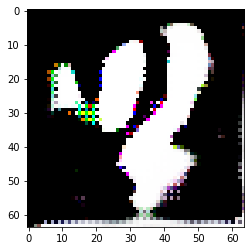

################REAL#################


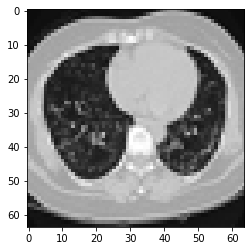

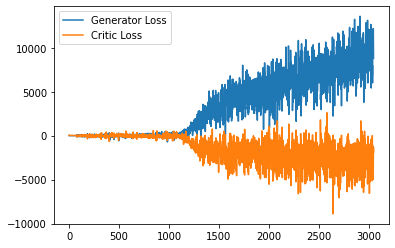

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 184, step 62000: Generator loss: 10032.457079101563, critic loss: -2879.266502996717
################FAKE#################


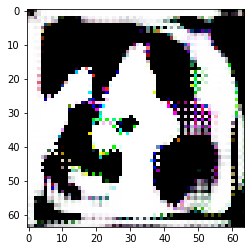

################REAL#################


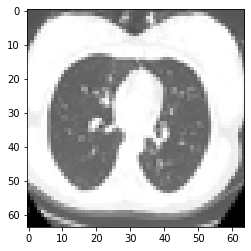

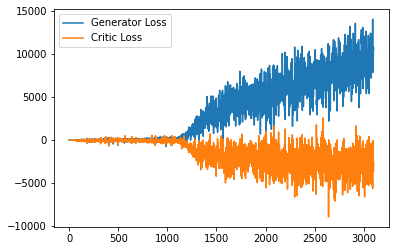

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 187, step 63000: Generator loss: 9564.570445556641, critic loss: -3068.4304020573773
################FAKE#################


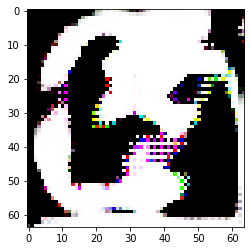

################REAL#################


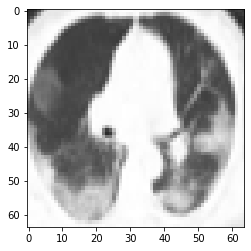

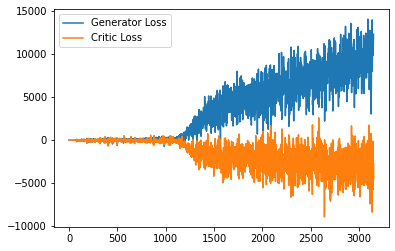

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 190, step 64000: Generator loss: 9297.889046630859, critic loss: -2550.943927527019
################FAKE#################


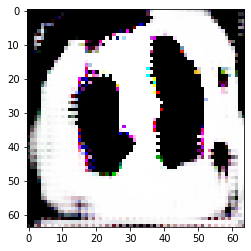

################REAL#################


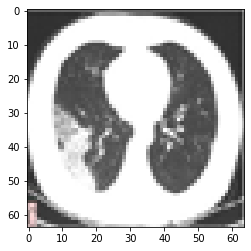

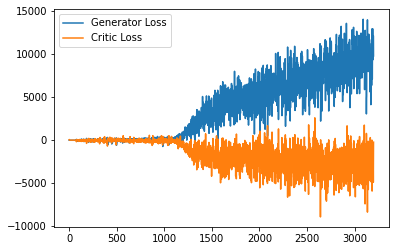

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 193, step 65000: Generator loss: 8730.028638244628, critic loss: -2427.803062954359
################FAKE#################


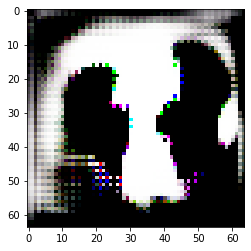

################REAL#################


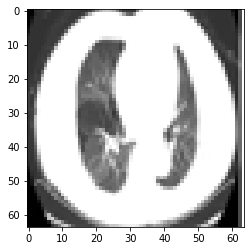

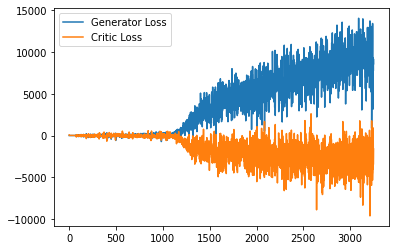

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 196, step 66000: Generator loss: 9979.863427490234, critic loss: -2771.472902910508
################FAKE#################


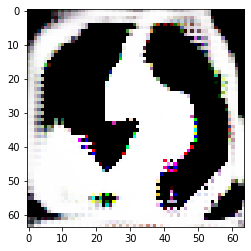

################REAL#################


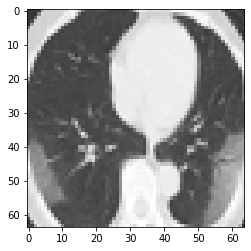

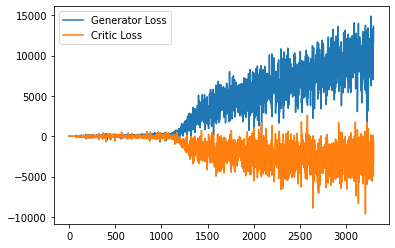

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 199, step 67000: Generator loss: 9614.059634033203, critic loss: -2816.3741940506497
################FAKE#################


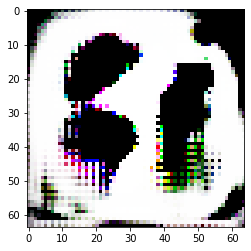

################REAL#################


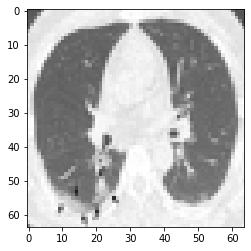

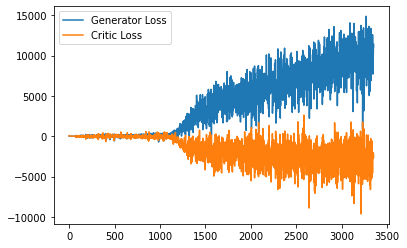

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 202, step 68000: Generator loss: 9748.328001464844, critic loss: -2616.065231741499
################FAKE#################


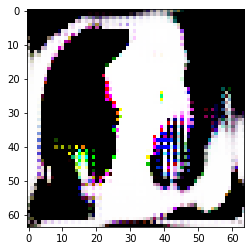

################REAL#################


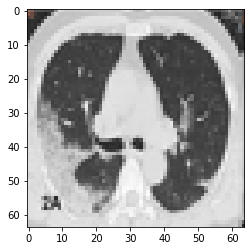

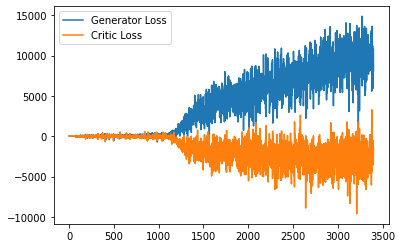

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 205, step 69000: Generator loss: 9892.9391328125, critic loss: -2868.486733301983
################FAKE#################


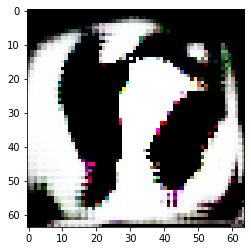

################REAL#################


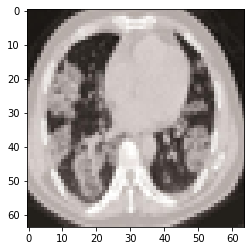

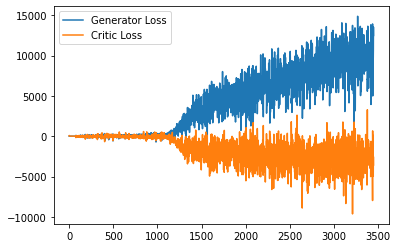

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 208, step 70000: Generator loss: 9908.15632055664, critic loss: -2856.6203743040887
################FAKE#################


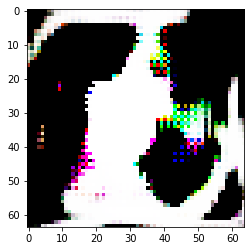

################REAL#################


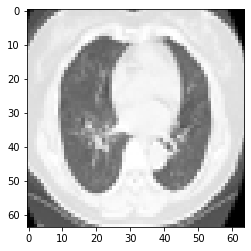

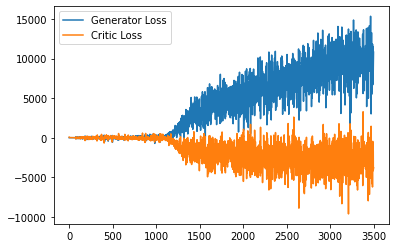

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 211, step 71000: Generator loss: 10105.65357861328, critic loss: -2702.5588450911405
################FAKE#################


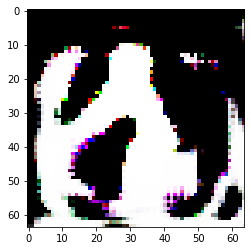

################REAL#################


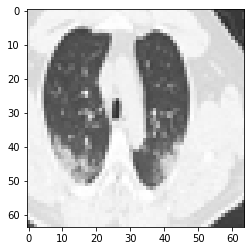

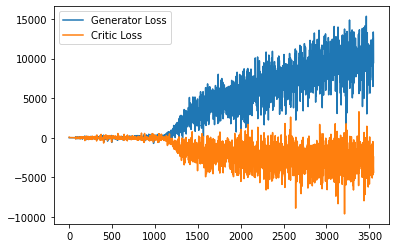

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 214, step 72000: Generator loss: 10446.677489746095, critic loss: -2850.5336197220945
################FAKE#################


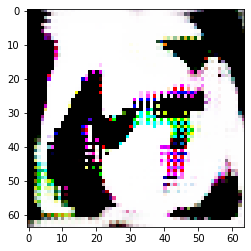

################REAL#################


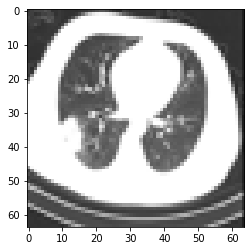

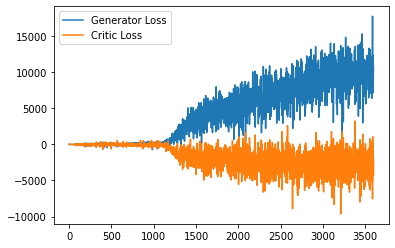

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 217, step 73000: Generator loss: 10850.687201660156, critic loss: -2905.636671126914
################FAKE#################


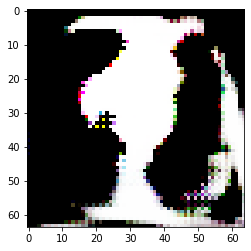

################REAL#################


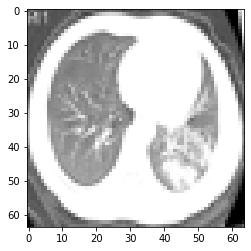

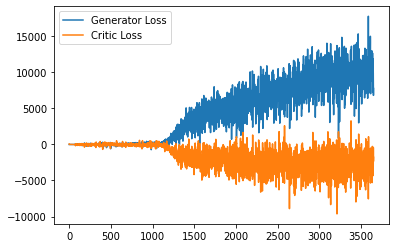

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 220, step 74000: Generator loss: 11260.888026367187, critic loss: -3170.154020829338
################FAKE#################


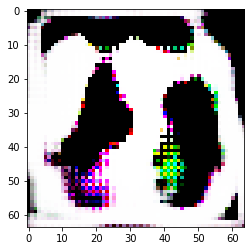

################REAL#################


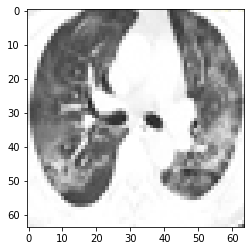

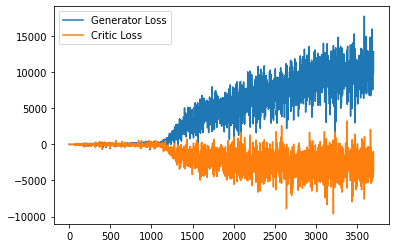

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 223, step 75000: Generator loss: 11382.230615234375, critic loss: -3207.292888668063
################FAKE#################


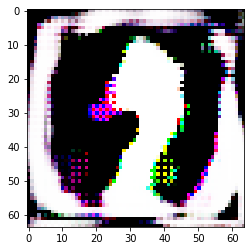

################REAL#################


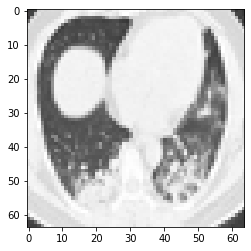

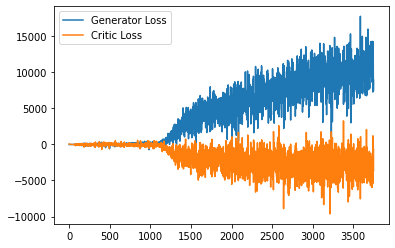

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 226, step 76000: Generator loss: 11079.67510107422, critic loss: -2704.309595838002
################FAKE#################


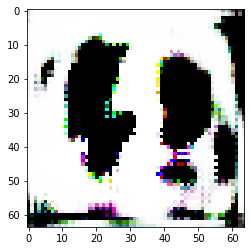

################REAL#################


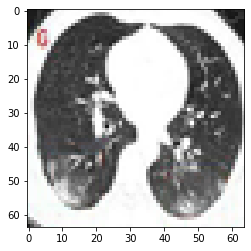

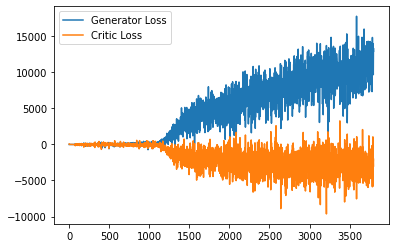

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 229, step 77000: Generator loss: 11214.071321289062, critic loss: -3249.4862180183964
################FAKE#################


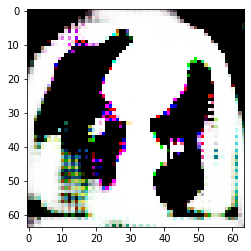

################REAL#################


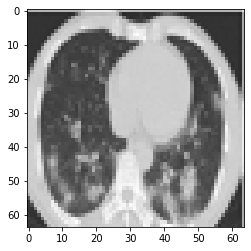

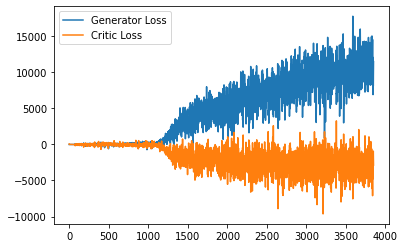

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 232, step 78000: Generator loss: 11477.035827636719, critic loss: -3512.488674969815
################FAKE#################


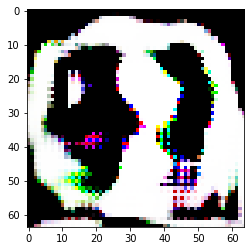

################REAL#################


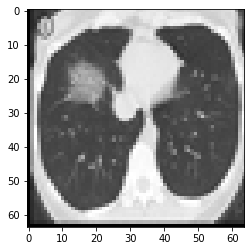

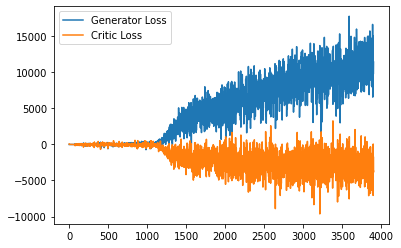

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 235, step 79000: Generator loss: 10914.908076660156, critic loss: -2708.347115601681
################FAKE#################


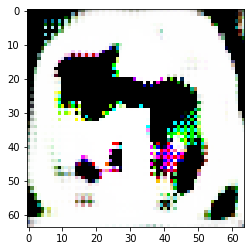

################REAL#################


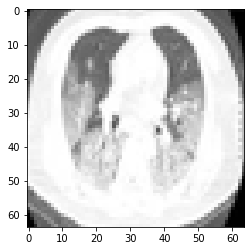

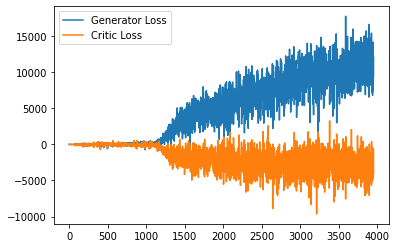

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 238, step 80000: Generator loss: 11547.382422363282, critic loss: -3202.811682593211
################FAKE#################


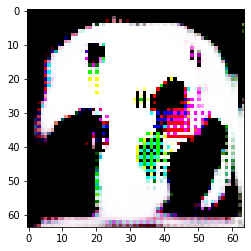

################REAL#################


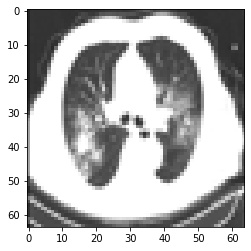

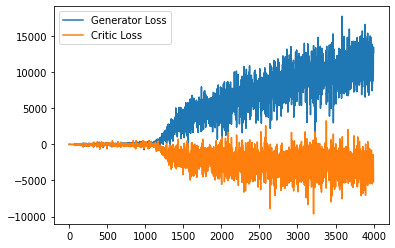

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 241, step 81000: Generator loss: 11059.434298339844, critic loss: -2619.6317398223846
################FAKE#################


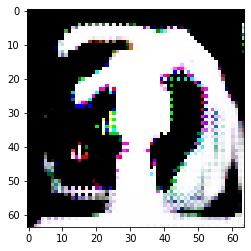

################REAL#################


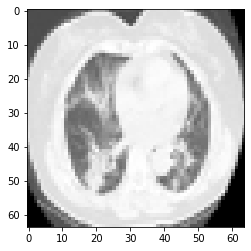

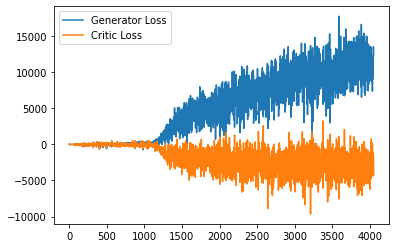

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 244, step 82000: Generator loss: 12030.50680029297, critic loss: -2989.5501326343015
################FAKE#################


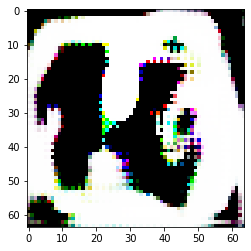

################REAL#################


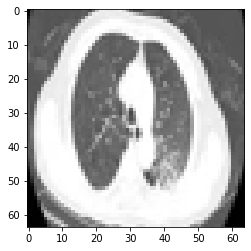

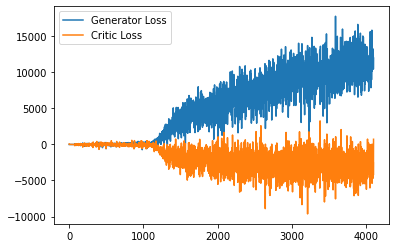

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 247, step 83000: Generator loss: 11400.721689453125, critic loss: -3170.7060121650734
################FAKE#################


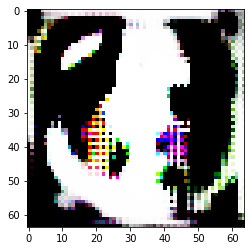

################REAL#################


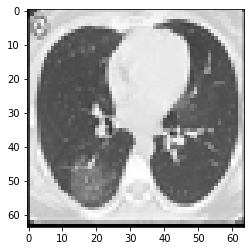

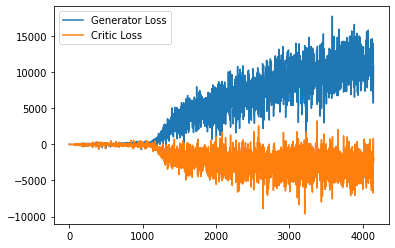

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 250, step 84000: Generator loss: 11544.446581054688, critic loss: -3023.343996882842
################FAKE#################


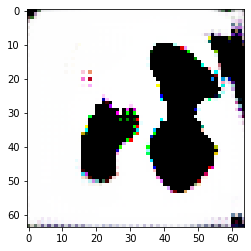

################REAL#################


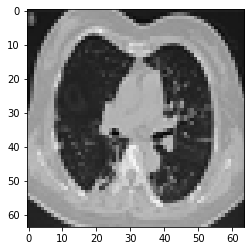

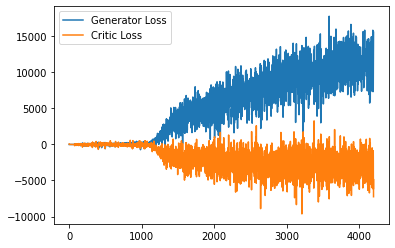

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 252, step 85000: Generator loss: 11775.27239501953, critic loss: -3068.7430139906755
################FAKE#################


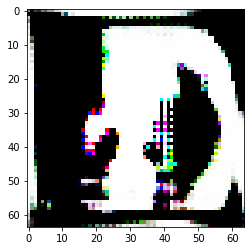

################REAL#################


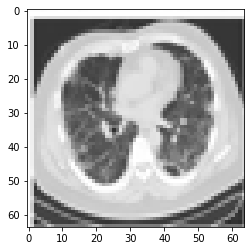

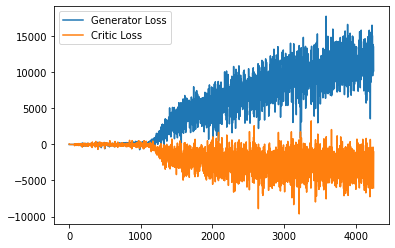

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 255, step 86000: Generator loss: 13260.165162109375, critic loss: -3440.825716206964
################FAKE#################


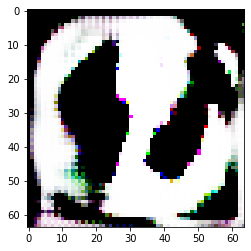

################REAL#################


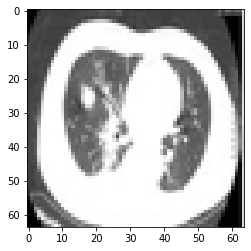

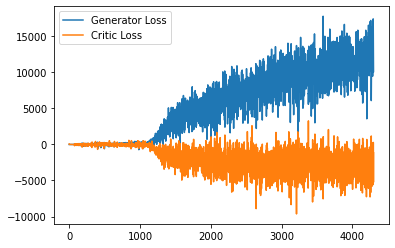

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 258, step 87000: Generator loss: 12090.313129882812, critic loss: -2908.004260547228
################FAKE#################


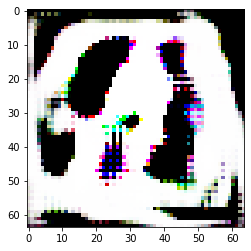

################REAL#################


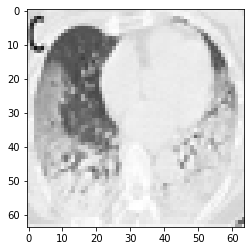

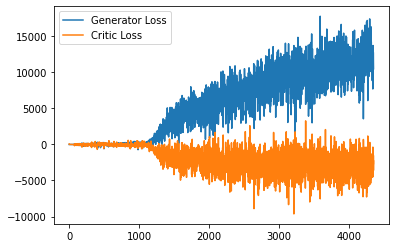

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 261, step 88000: Generator loss: 11970.325744873047, critic loss: -2929.688176231658
################FAKE#################


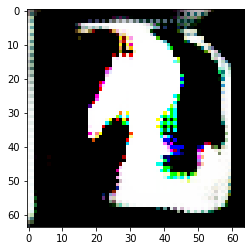

################REAL#################


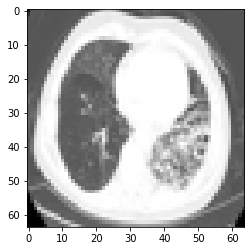

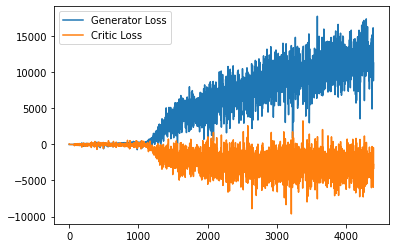

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 264, step 89000: Generator loss: 12070.514627441406, critic loss: -2923.566296860285
################FAKE#################


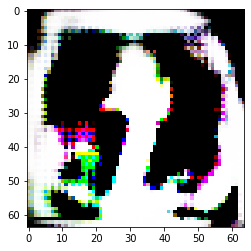

################REAL#################


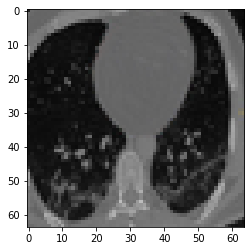

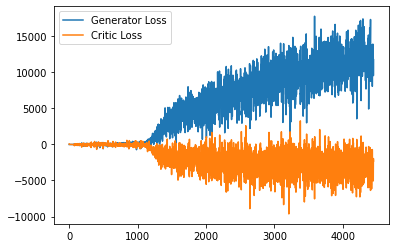

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 267, step 90000: Generator loss: 12525.96892578125, critic loss: -3053.9186991225665
################FAKE#################


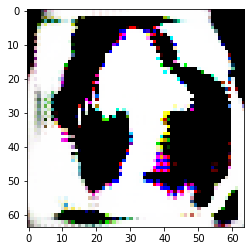

################REAL#################


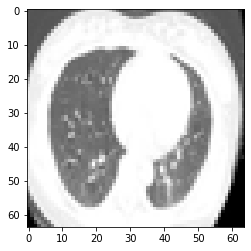

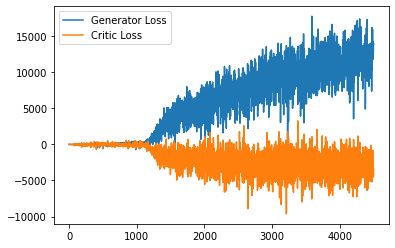

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 270, step 91000: Generator loss: 11707.040172851563, critic loss: -3214.5935634558564
################FAKE#################


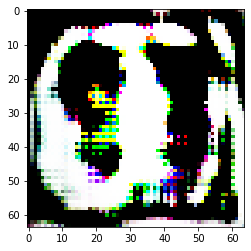

################REAL#################


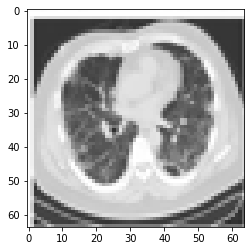

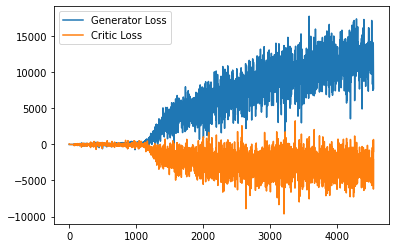

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 273, step 92000: Generator loss: 12092.2297421875, critic loss: -2916.03618916593
################FAKE#################


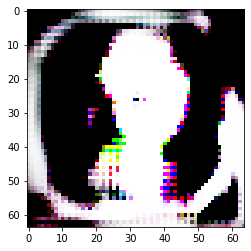

################REAL#################


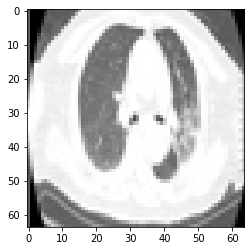

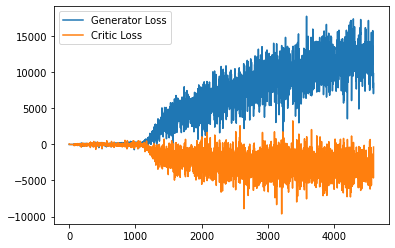

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 276, step 93000: Generator loss: 12457.457633789063, critic loss: -3141.9682028781353
################FAKE#################


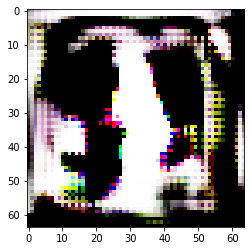

################REAL#################


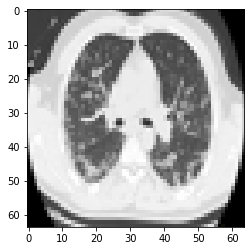

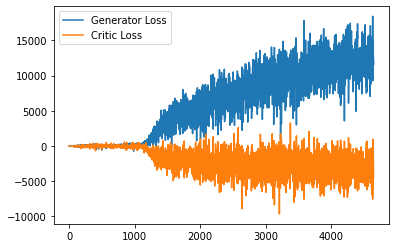

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 279, step 94000: Generator loss: 12565.345317382813, critic loss: -3109.499108892718
################FAKE#################


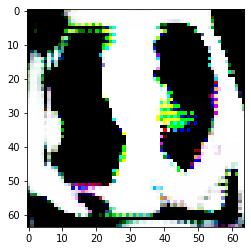

################REAL#################


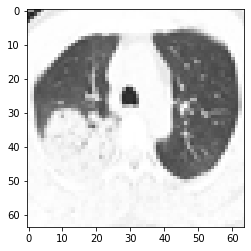

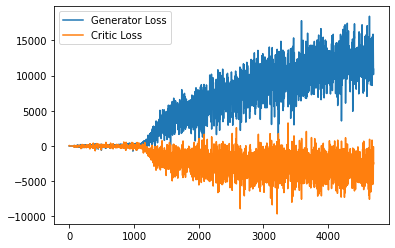

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 282, step 95000: Generator loss: 13384.8447109375, critic loss: -3617.755023347038
################FAKE#################


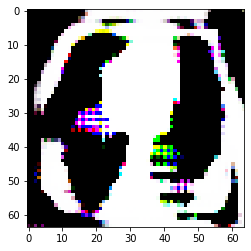

################REAL#################


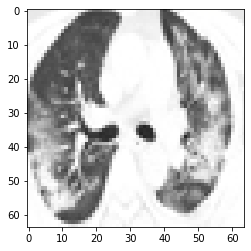

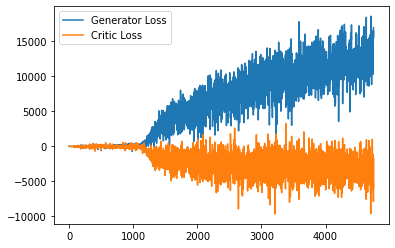

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 285, step 96000: Generator loss: 13035.402541015625, critic loss: -3092.0389677876046
################FAKE#################


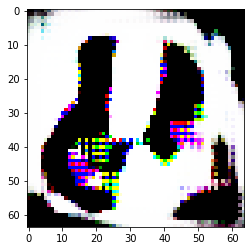

################REAL#################


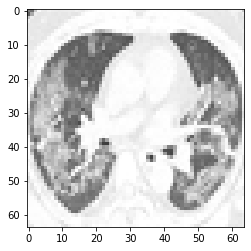

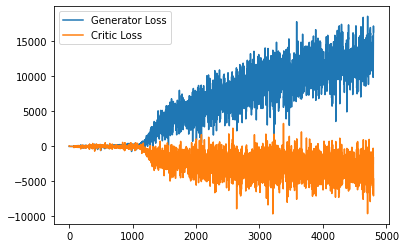

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 288, step 97000: Generator loss: 12976.403475097657, critic loss: -2923.494330248964
################FAKE#################


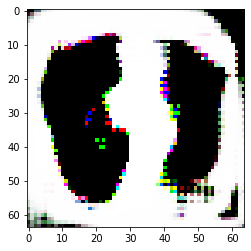

################REAL#################


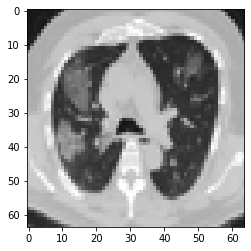

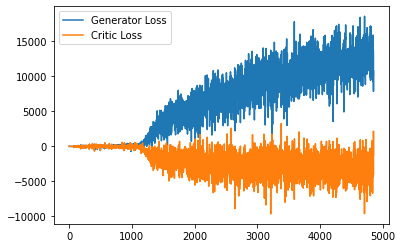

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 291, step 98000: Generator loss: 13305.978414550782, critic loss: -3310.9218289467963
################FAKE#################


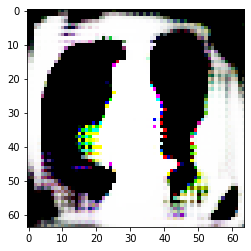

################REAL#################


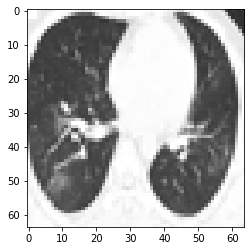

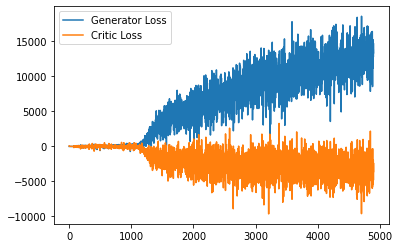

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 294, step 99000: Generator loss: 13368.745473632813, critic loss: -2902.474354688375
################FAKE#################


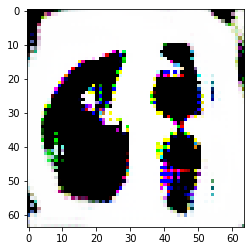

################REAL#################


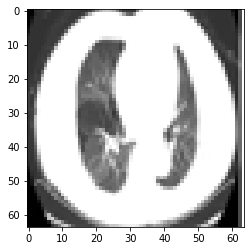

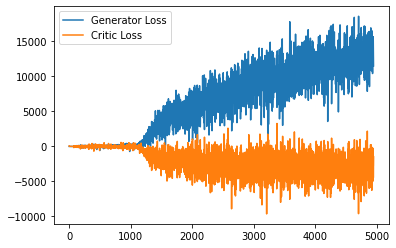

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 297, step 100000: Generator loss: 12834.033116210938, critic loss: -2946.298230431966
################FAKE#################


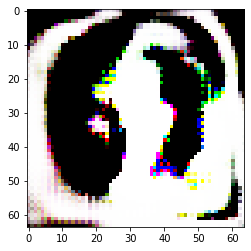

################REAL#################


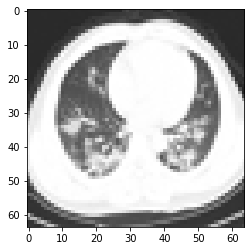

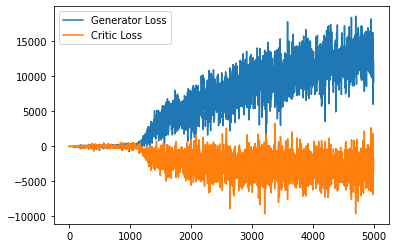

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 300, step 101000: Generator loss: 14193.982171875, critic loss: -3488.841796497891
################FAKE#################


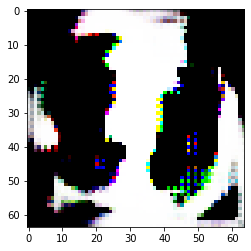

################REAL#################


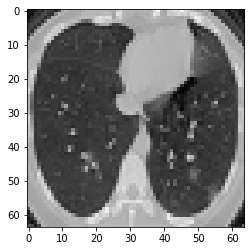

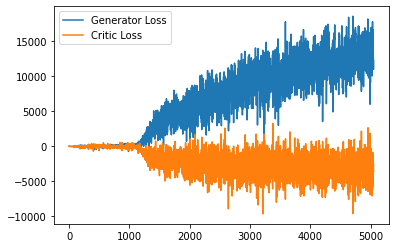

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 303, step 102000: Generator loss: 14196.955807128907, critic loss: -3587.7199726409904
################FAKE#################


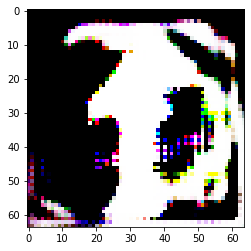

################REAL#################


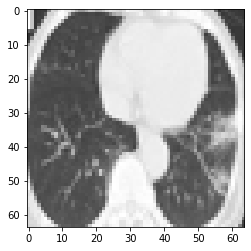

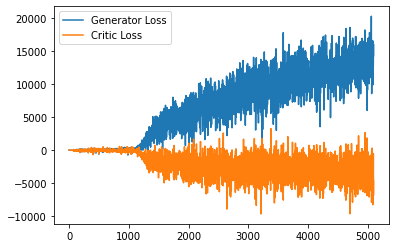

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 306, step 103000: Generator loss: 13617.225075195312, critic loss: -3017.928854938371
################FAKE#################


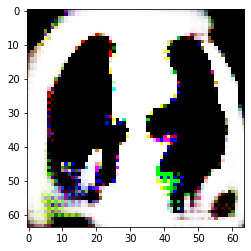

################REAL#################


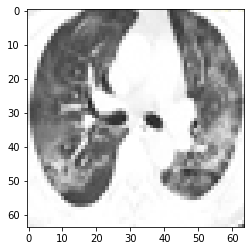

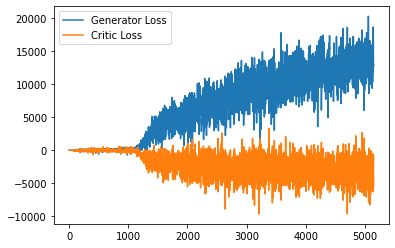

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 309, step 104000: Generator loss: 14134.67430078125, critic loss: -3226.9105214217047
################FAKE#################


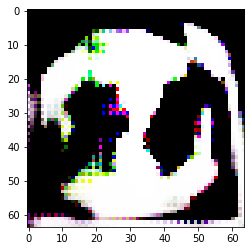

################REAL#################


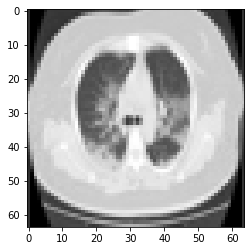

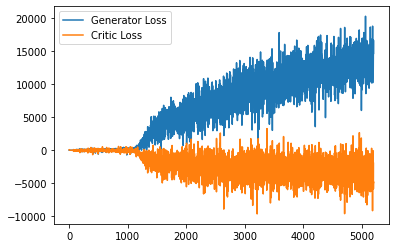

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 312, step 105000: Generator loss: 13125.033045898437, critic loss: -2950.116049333298
################FAKE#################


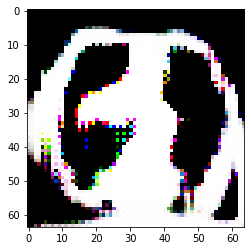

################REAL#################


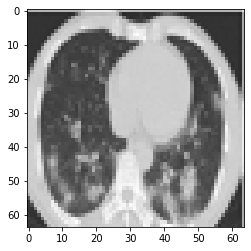

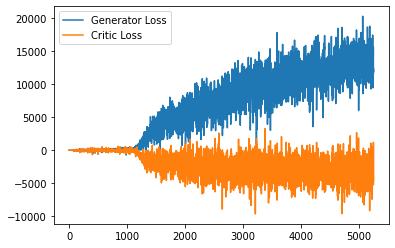

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 315, step 106000: Generator loss: 13818.377235351563, critic loss: -3216.8450215211637
################FAKE#################


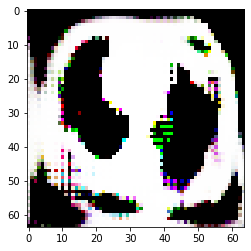

################REAL#################


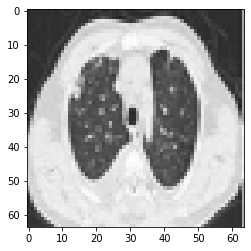

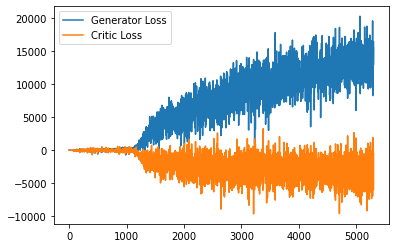

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 318, step 107000: Generator loss: 13967.698213867188, critic loss: -3197.9036951803505
################FAKE#################


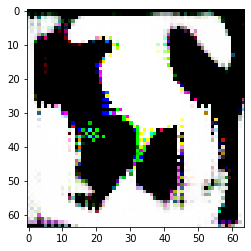

################REAL#################


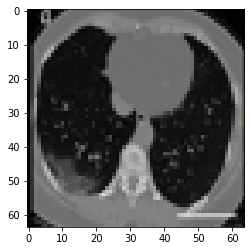

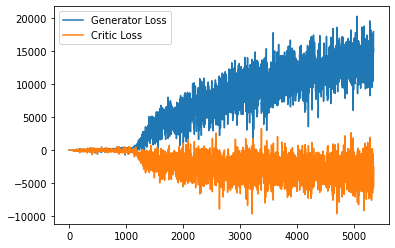

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 321, step 108000: Generator loss: 14208.571325195313, critic loss: -3092.2142999228113
################FAKE#################


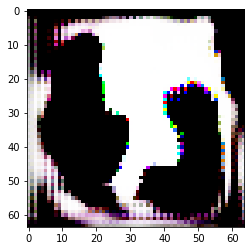

################REAL#################


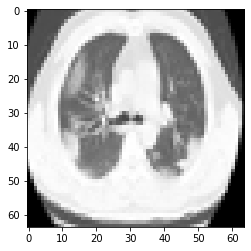

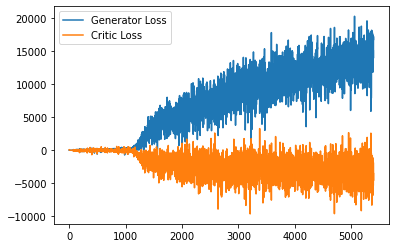

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 324, step 109000: Generator loss: 14645.079389648437, critic loss: -3346.9232424940365
################FAKE#################


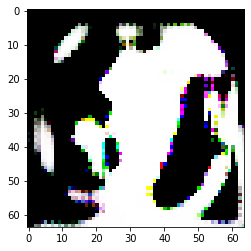

################REAL#################


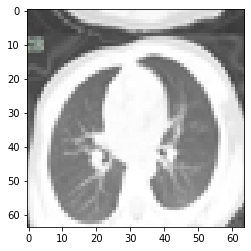

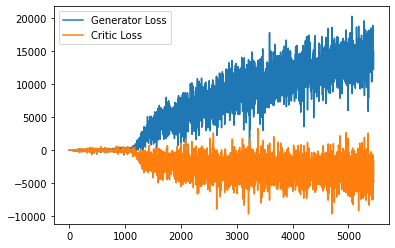

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 327, step 110000: Generator loss: 13947.658881835938, critic loss: -3341.5233249958515
################FAKE#################


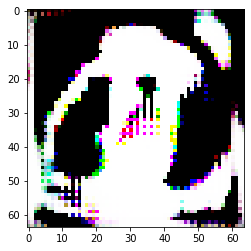

################REAL#################


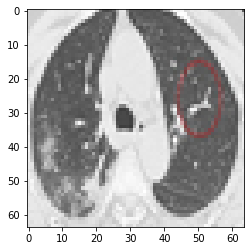

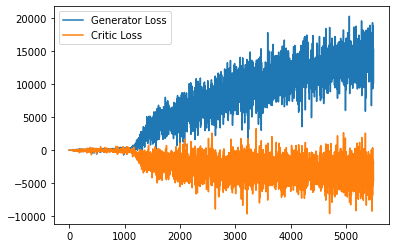

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 330, step 111000: Generator loss: 14347.10522265625, critic loss: -3206.49972152574
################FAKE#################


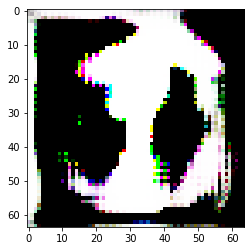

################REAL#################


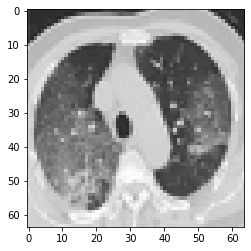

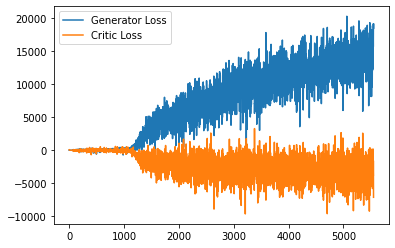

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 333, step 112000: Generator loss: 14273.206026367188, critic loss: -3206.5770818007345
################FAKE#################


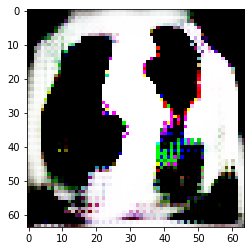

################REAL#################


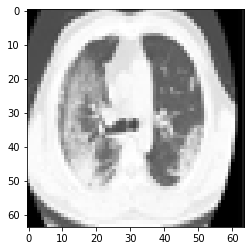

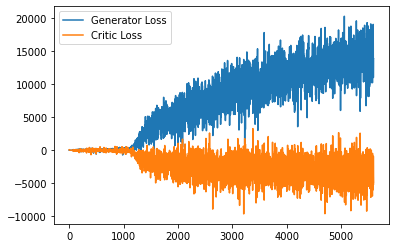

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 336, step 113000: Generator loss: 14898.30712890625, critic loss: -3338.3797625563557
################FAKE#################


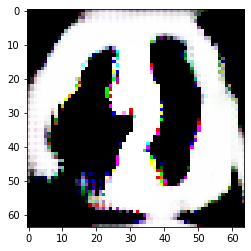

################REAL#################


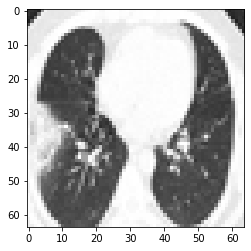

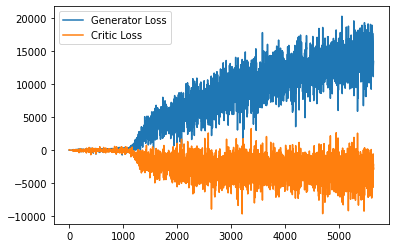

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 339, step 114000: Generator loss: 15584.236563476563, critic loss: -3513.072035510611
################FAKE#################


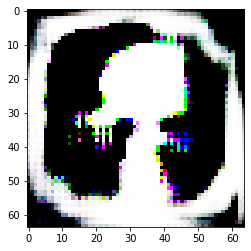

################REAL#################


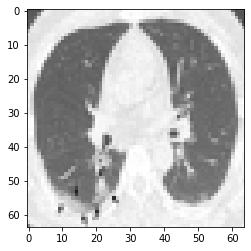

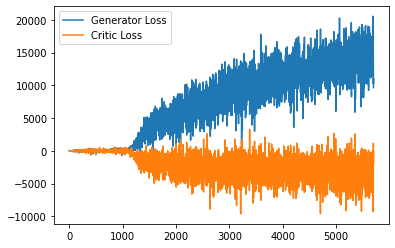

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 342, step 115000: Generator loss: 14623.856404296876, critic loss: -3108.0320996420755
################FAKE#################


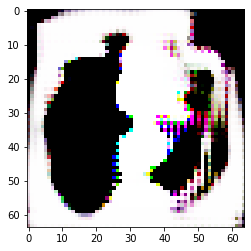

################REAL#################


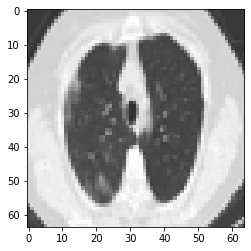

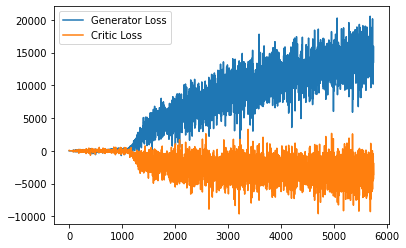

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 345, step 116000: Generator loss: 13919.766924316405, critic loss: -2877.006872550419
################FAKE#################


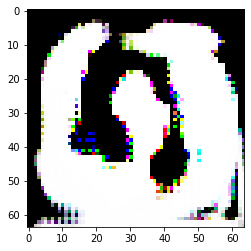

################REAL#################


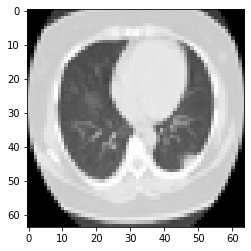

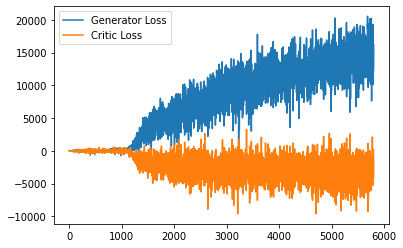

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 348, step 117000: Generator loss: 13988.089732421875, critic loss: -3079.538454561511
################FAKE#################


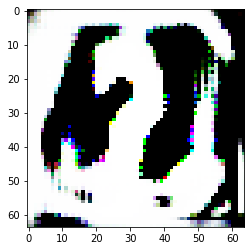

################REAL#################


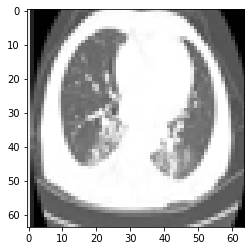

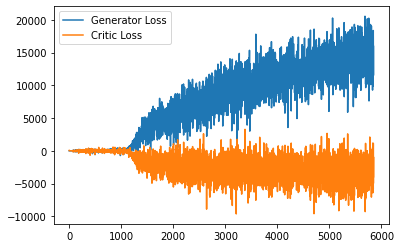

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 351, step 118000: Generator loss: 14329.416609863281, critic loss: -3302.1982272842984
################FAKE#################


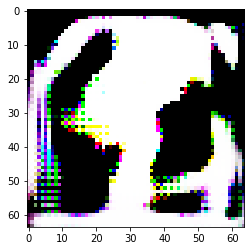

################REAL#################


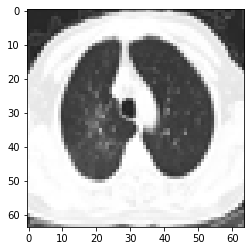

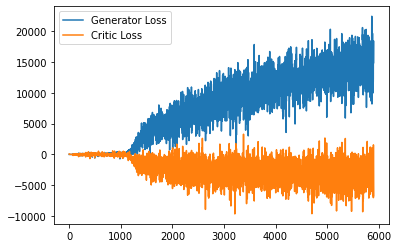

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 354, step 119000: Generator loss: 14327.519385742187, critic loss: -2948.5114129184985
################FAKE#################


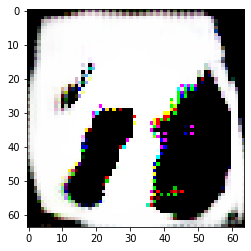

################REAL#################


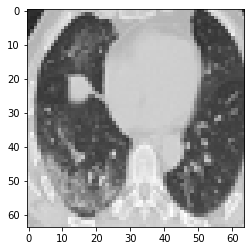

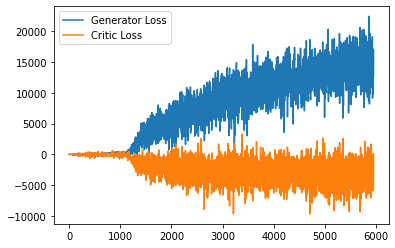

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 357, step 120000: Generator loss: 14762.064326660156, critic loss: -3395.4146865844723
################FAKE#################


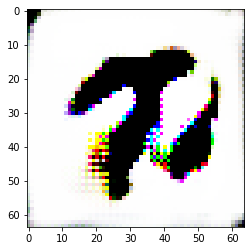

################REAL#################


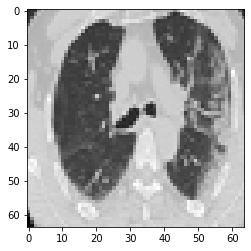

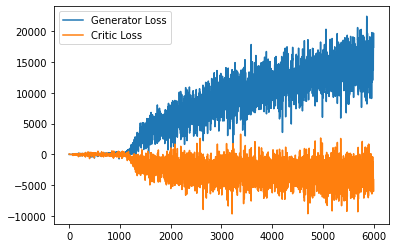

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 360, step 121000: Generator loss: 15348.738146484375, critic loss: -3719.045736898149
################FAKE#################


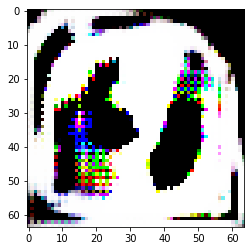

################REAL#################


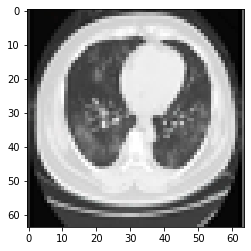

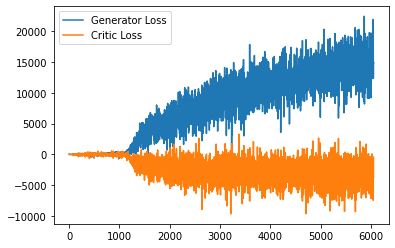

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 363, step 122000: Generator loss: 14599.260166992188, critic loss: -2977.8188139264257
################FAKE#################


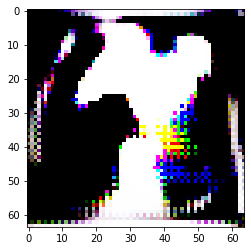

################REAL#################


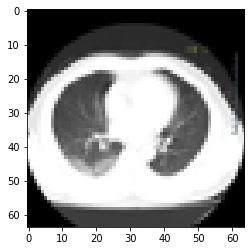

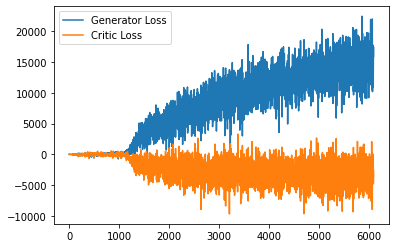

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 366, step 123000: Generator loss: 15291.110735351562, critic loss: -3019.518636837005
################FAKE#################


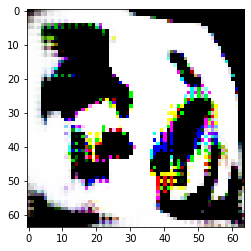

################REAL#################


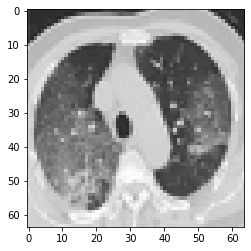

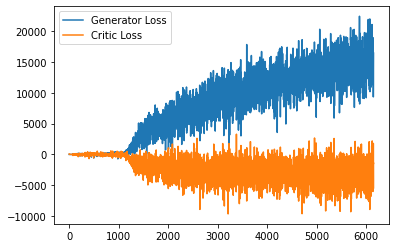

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 369, step 124000: Generator loss: 15386.800379882812, critic loss: -3380.8606551579037
################FAKE#################


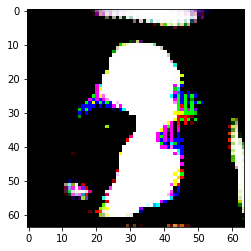

################REAL#################


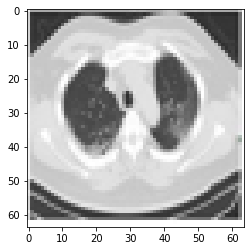

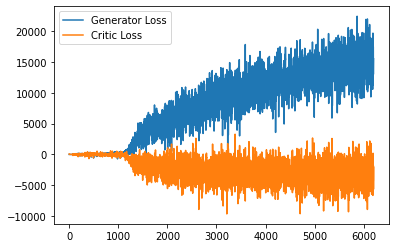

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 372, step 125000: Generator loss: 16302.098758789063, critic loss: -3460.9763397369384
################FAKE#################


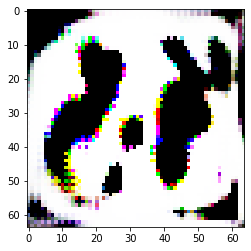

################REAL#################


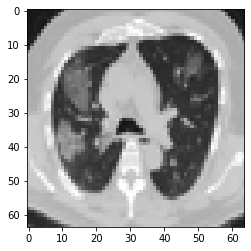

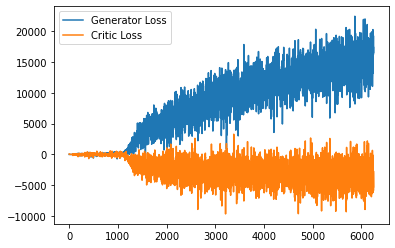

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 375, step 126000: Generator loss: 16305.623361816406, critic loss: -3628.6397662675076
################FAKE#################


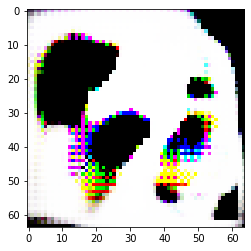

################REAL#################


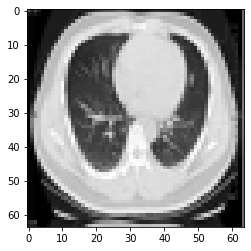

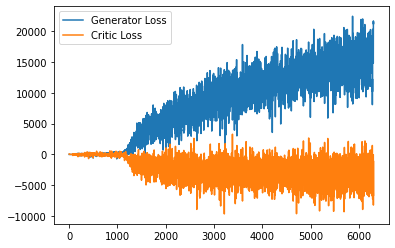

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 377, step 127000: Generator loss: 15126.235235351562, critic loss: -3048.034004508427
################FAKE#################


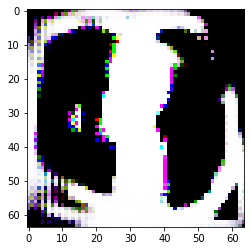

################REAL#################


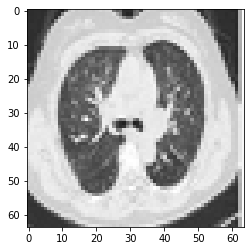

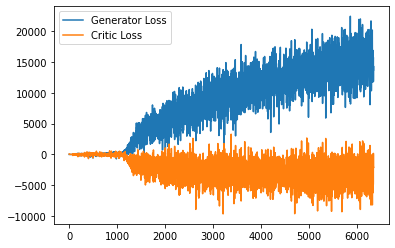

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 380, step 128000: Generator loss: 15877.745404296875, critic loss: -3239.3450977020248
################FAKE#################


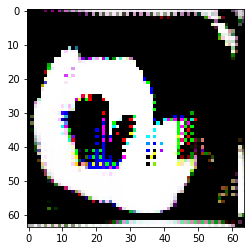

################REAL#################


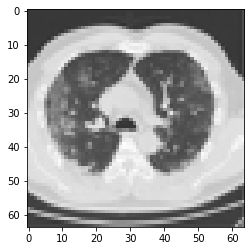

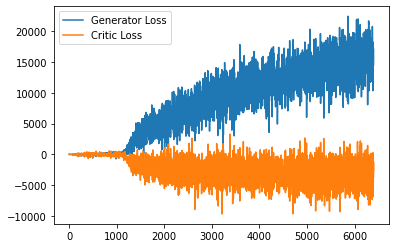

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 383, step 129000: Generator loss: 16541.839717773437, critic loss: -3889.5317285134433
################FAKE#################


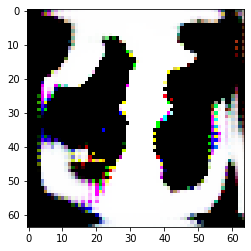

################REAL#################


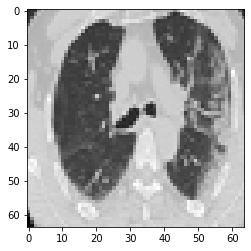

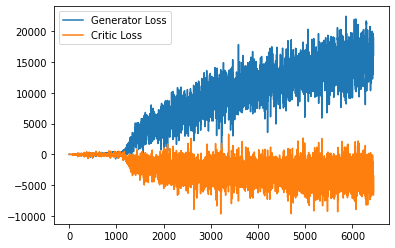

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 386, step 130000: Generator loss: 16269.237378417969, critic loss: -3273.8175960641565
################FAKE#################


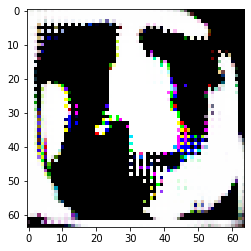

################REAL#################


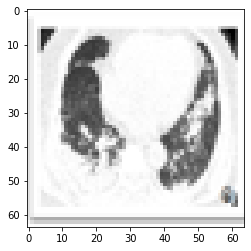

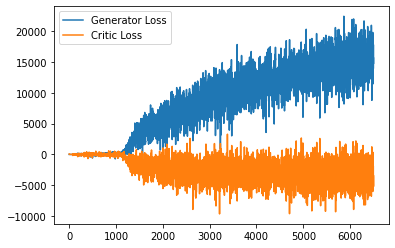

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 389, step 131000: Generator loss: 16563.055623046876, critic loss: -3753.6621486642007
################FAKE#################


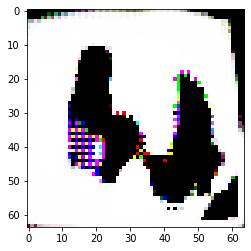

################REAL#################


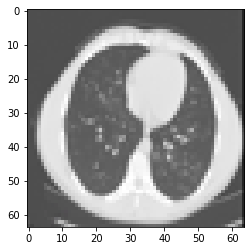

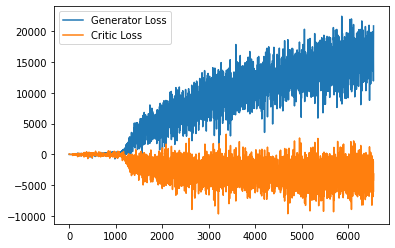

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 392, step 132000: Generator loss: 17060.779770507812, critic loss: -3965.3693292792154
################FAKE#################


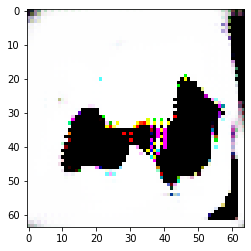

################REAL#################


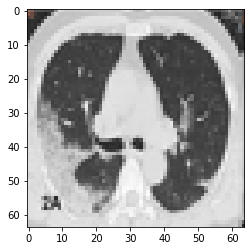

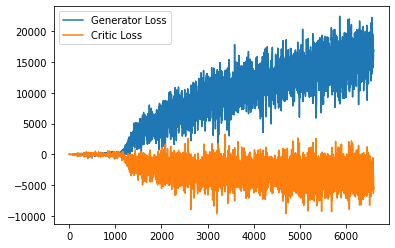

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 395, step 133000: Generator loss: 16726.44380078125, critic loss: -3482.508319013866
################FAKE#################


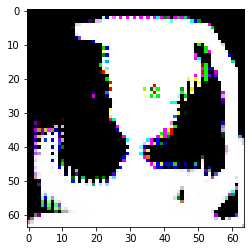

################REAL#################


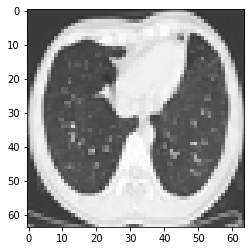

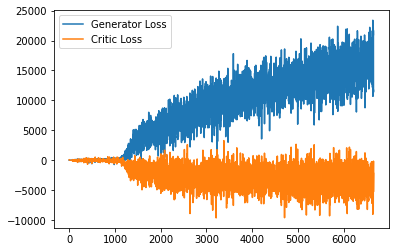

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 398, step 134000: Generator loss: 16834.303177734375, critic loss: -3638.6556207629624
################FAKE#################


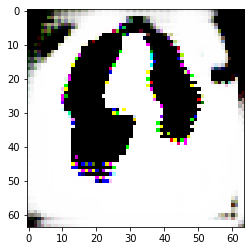

################REAL#################


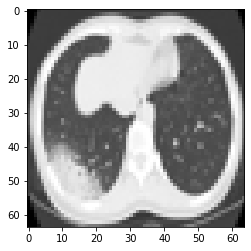

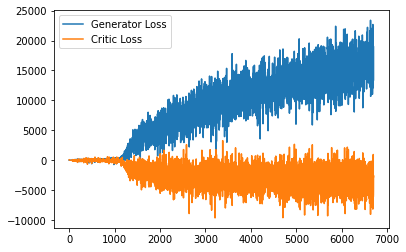

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 401, step 135000: Generator loss: 17868.866772460937, critic loss: -4074.0523598011546
################FAKE#################


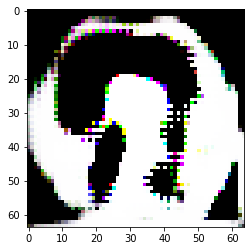

################REAL#################


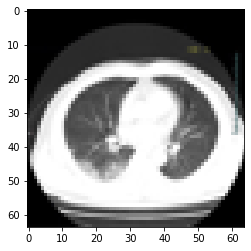

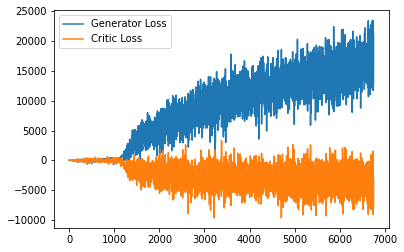

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 404, step 136000: Generator loss: 18154.620134765624, critic loss: -4103.452257609499
################FAKE#################


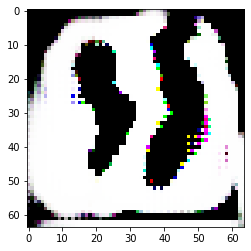

################REAL#################


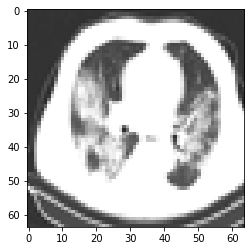

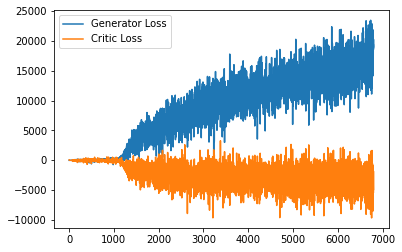

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 407, step 137000: Generator loss: 19160.205212890625, critic loss: -4385.303479709076
################FAKE#################


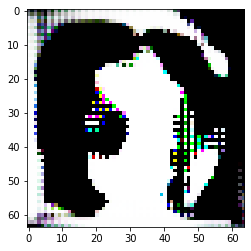

################REAL#################


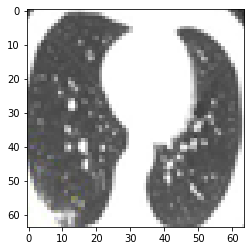

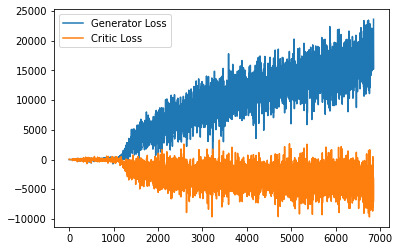

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 410, step 138000: Generator loss: 18033.29305859375, critic loss: -4166.728012381416
################FAKE#################


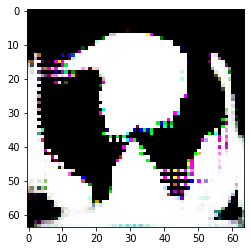

################REAL#################


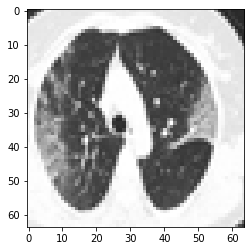

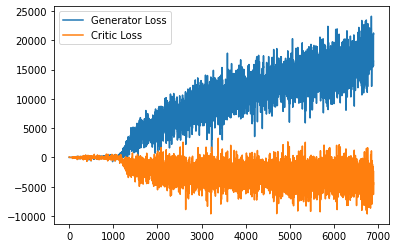

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 413, step 139000: Generator loss: 18575.6816640625, critic loss: -3825.3957337504803
################FAKE#################


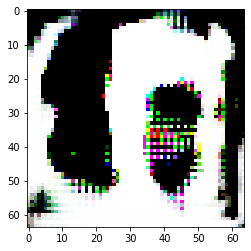

################REAL#################


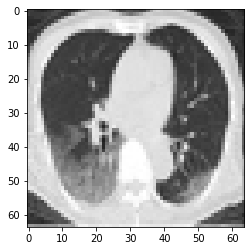

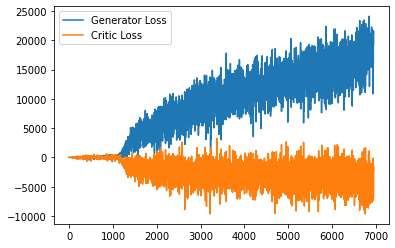

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 416, step 140000: Generator loss: 19398.337328125, critic loss: -4080.843989750449
################FAKE#################


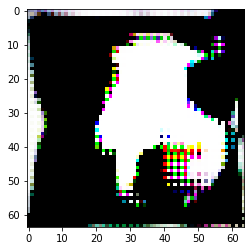

################REAL#################


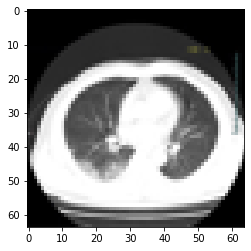

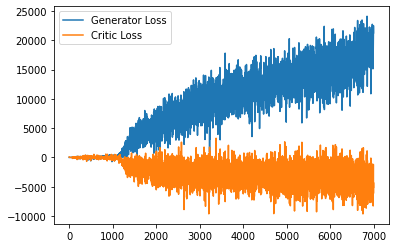

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 419, step 141000: Generator loss: 17711.922005859375, critic loss: -3492.9679758229927
################FAKE#################


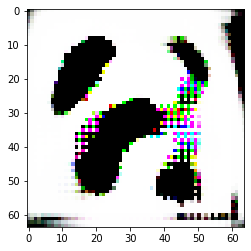

################REAL#################


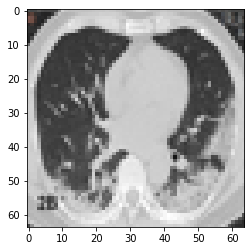

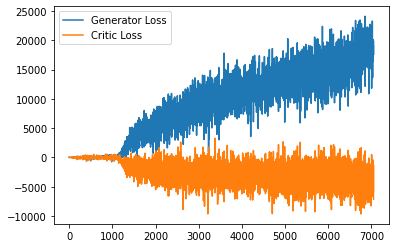

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 422, step 142000: Generator loss: 18551.305522460938, critic loss: -3874.392016143802
################FAKE#################


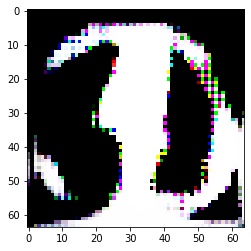

################REAL#################


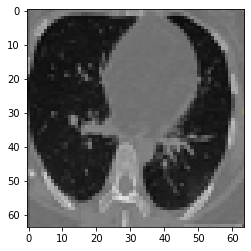

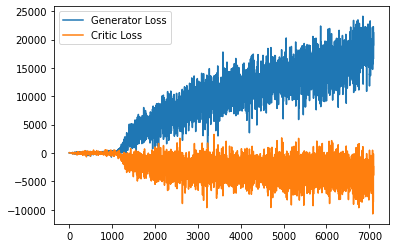

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 425, step 143000: Generator loss: 17741.095056640625, critic loss: -3574.3634096848577
################FAKE#################


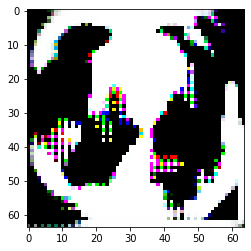

################REAL#################


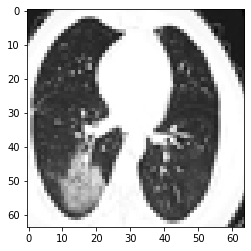

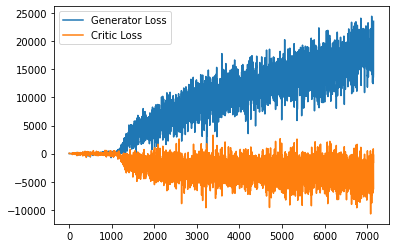

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 428, step 144000: Generator loss: 19085.913317382812, critic loss: -3931.790082153869
################FAKE#################


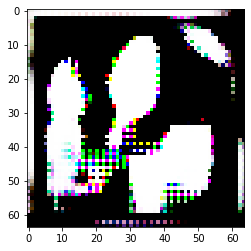

################REAL#################


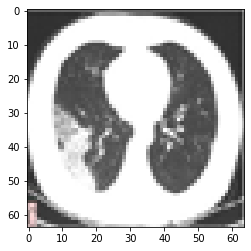

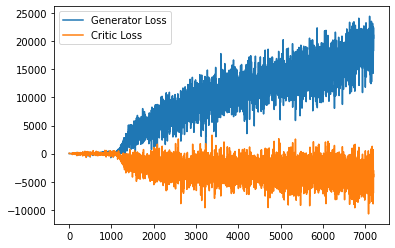

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 431, step 145000: Generator loss: 17230.662294921876, critic loss: -2949.0580519278456
################FAKE#################


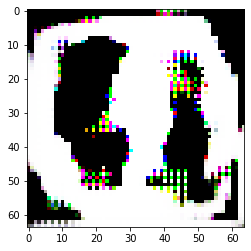

################REAL#################


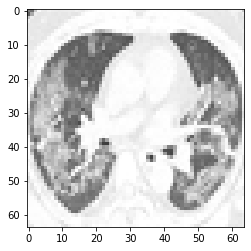

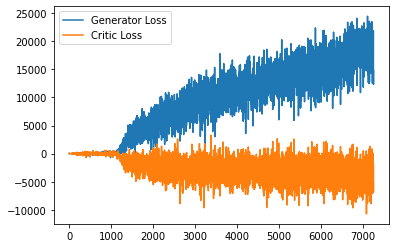

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 434, step 146000: Generator loss: 18756.238919921874, critic loss: -3919.4999313463522
################FAKE#################


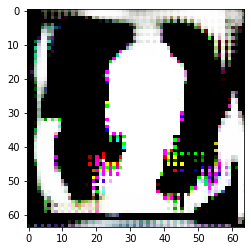

################REAL#################


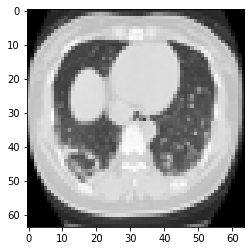

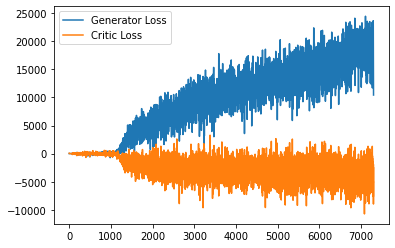

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 437, step 147000: Generator loss: 18660.179243164064, critic loss: -3818.03729867554
################FAKE#################


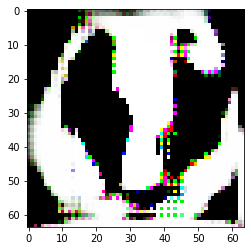

################REAL#################


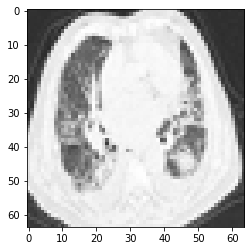

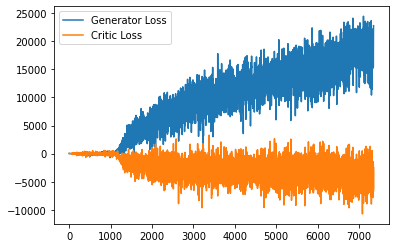

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 440, step 148000: Generator loss: 19055.44986230469, critic loss: -3771.6951506076553
################FAKE#################


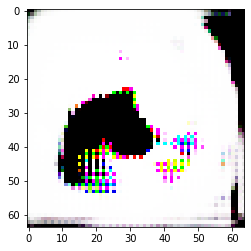

################REAL#################


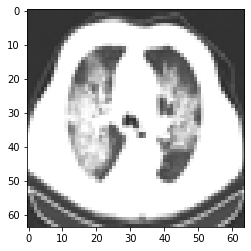

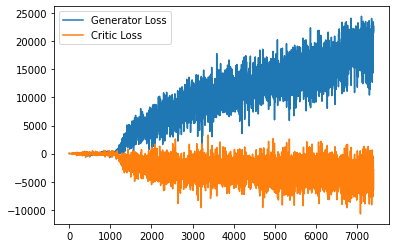

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 443, step 149000: Generator loss: 18489.5818203125, critic loss: -3739.9682970973413
################FAKE#################


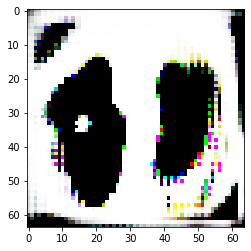

################REAL#################


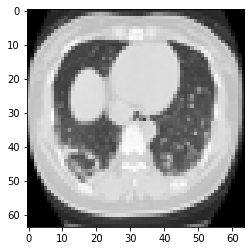

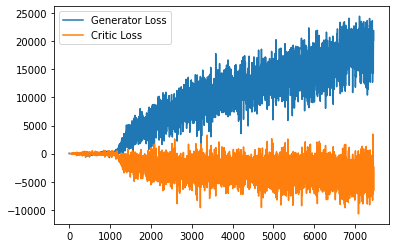

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 446, step 150000: Generator loss: 20665.415318359373, critic loss: -4222.584096814838
################FAKE#################


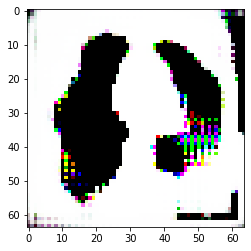

################REAL#################


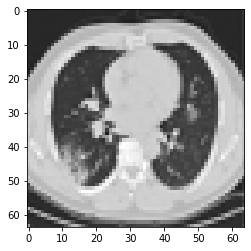

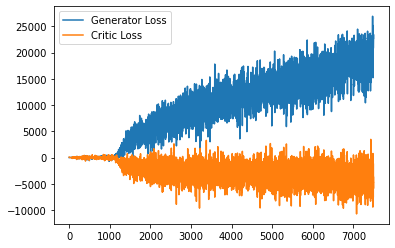

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 449, step 151000: Generator loss: 20119.854365234376, critic loss: -3782.7602673426977
################FAKE#################


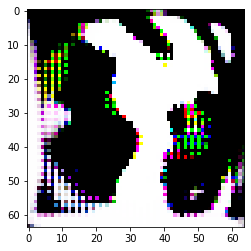

################REAL#################


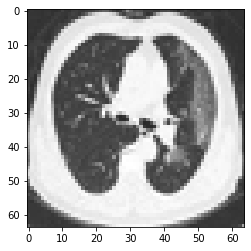

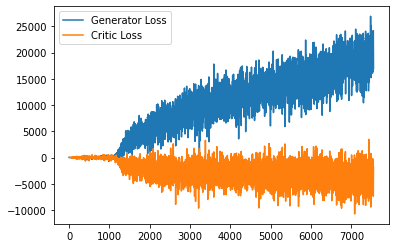

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 452, step 152000: Generator loss: 18828.255235351564, critic loss: -3424.448068889209
################FAKE#################


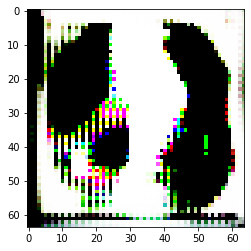

################REAL#################


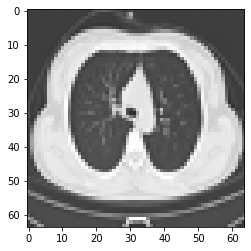

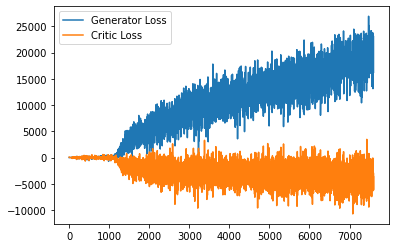

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 455, step 153000: Generator loss: 20093.985833007813, critic loss: -3918.2399758932884
################FAKE#################


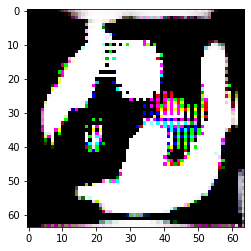

################REAL#################


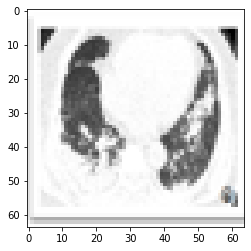

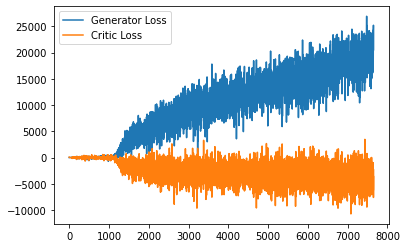

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 458, step 154000: Generator loss: 19536.220670898438, critic loss: -3723.8390216914636
################FAKE#################


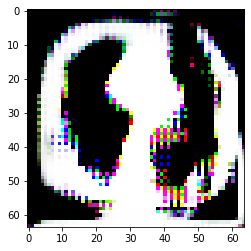

################REAL#################


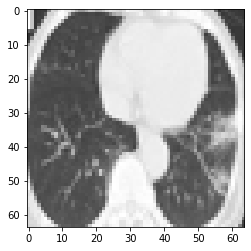

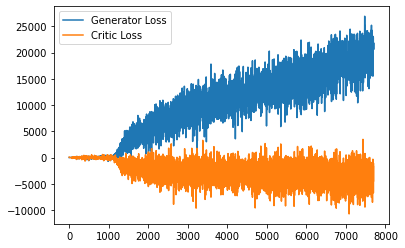

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 461, step 155000: Generator loss: 20366.744556640624, critic loss: -3813.955482077192
################FAKE#################


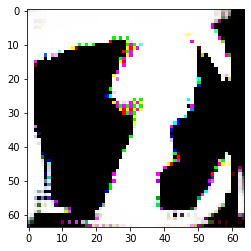

################REAL#################


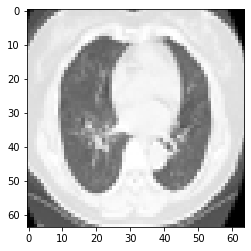

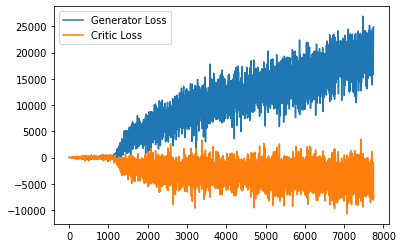

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 464, step 156000: Generator loss: 19965.828254882814, critic loss: -3792.0869697200274
################FAKE#################


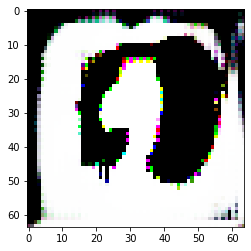

################REAL#################


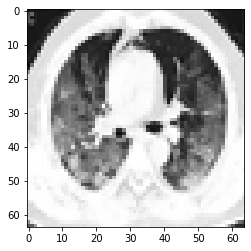

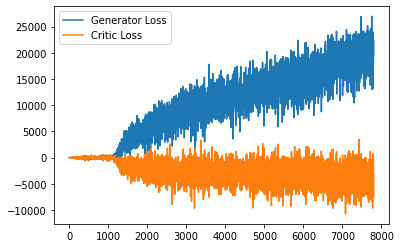

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 467, step 157000: Generator loss: 19595.89330761719, critic loss: -3856.606411608016
################FAKE#################


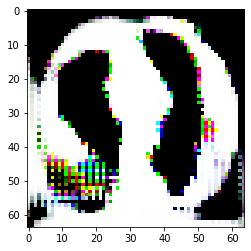

################REAL#################


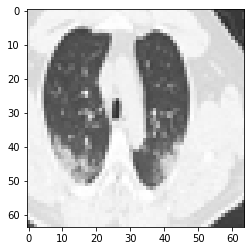

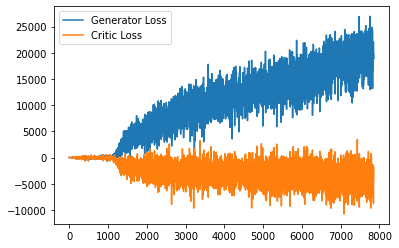

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 470, step 158000: Generator loss: 19660.20439453125, critic loss: -3663.7709307763253
################FAKE#################


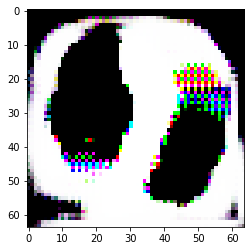

################REAL#################


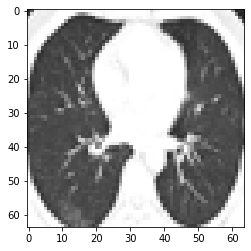

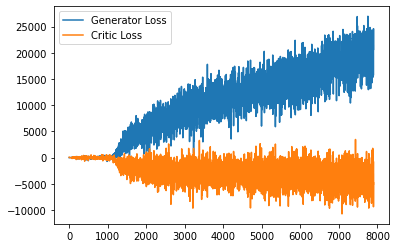

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 473, step 159000: Generator loss: 21551.414856445313, critic loss: -4315.56827963148
################FAKE#################


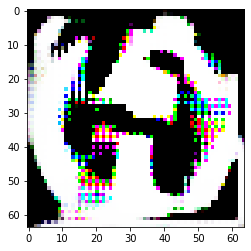

################REAL#################


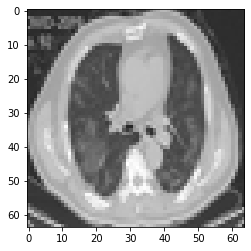

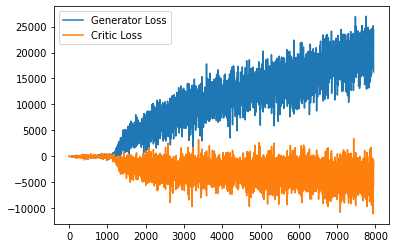

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 476, step 160000: Generator loss: 19944.66588378906, critic loss: -3839.257617254531
################FAKE#################


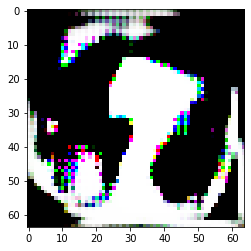

################REAL#################


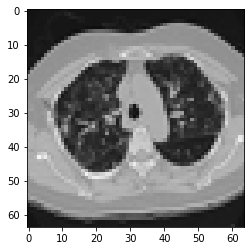

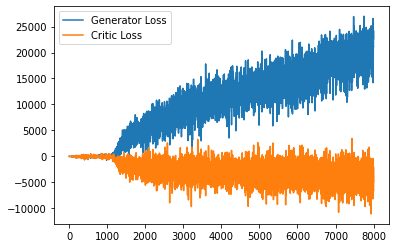

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 479, step 161000: Generator loss: 22253.954313476563, critic loss: -4230.2939187861875
################FAKE#################


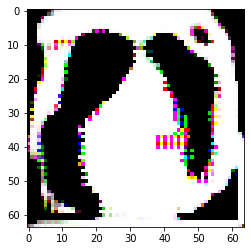

################REAL#################


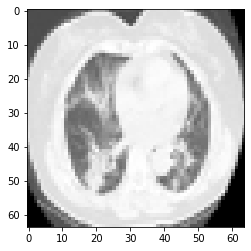

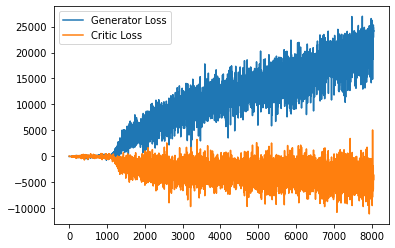

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 482, step 162000: Generator loss: 20653.459822265624, critic loss: -3884.0543360710158
################FAKE#################


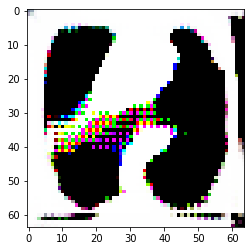

################REAL#################


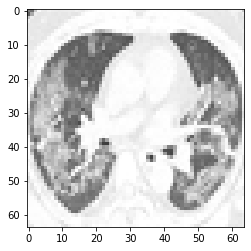

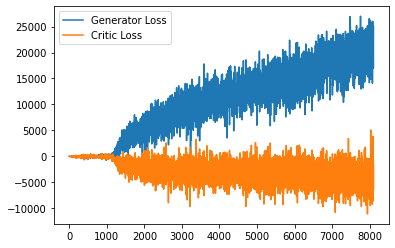

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 485, step 163000: Generator loss: 21857.362044921876, critic loss: -4362.120102277486
################FAKE#################


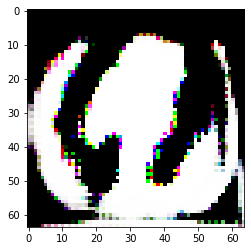

################REAL#################


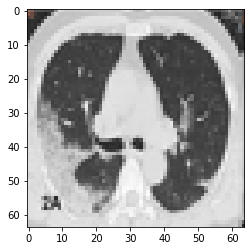

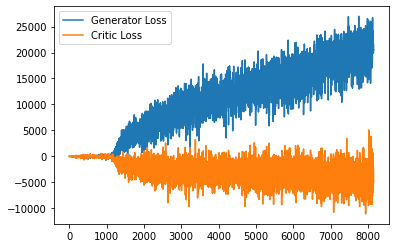

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 488, step 164000: Generator loss: 22416.694772460938, critic loss: -4107.522273444037
################FAKE#################


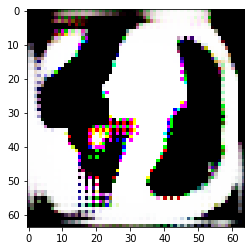

################REAL#################


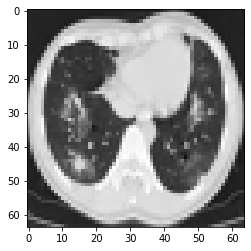

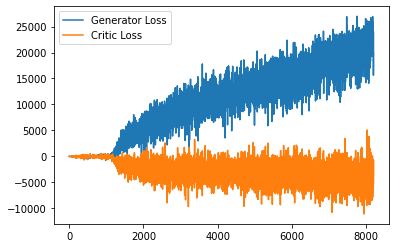

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 491, step 165000: Generator loss: 21869.17760546875, critic loss: -4448.148811609535
################FAKE#################


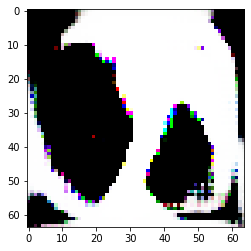

################REAL#################


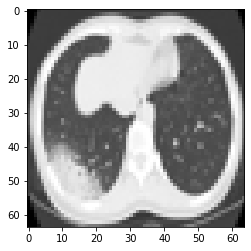

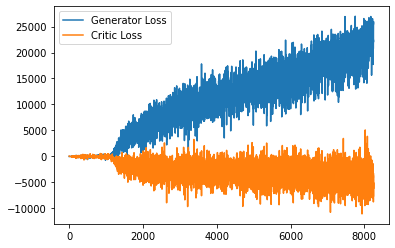

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 494, step 166000: Generator loss: 21540.98332421875, critic loss: -3919.281760889326
################FAKE#################


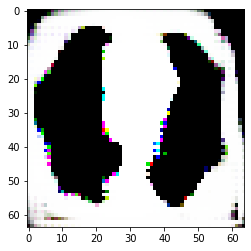

################REAL#################


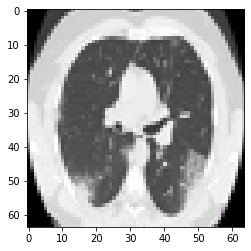

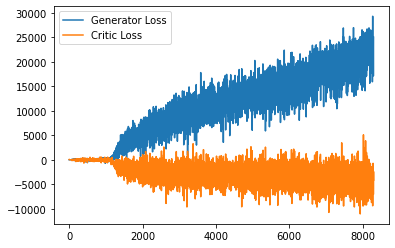

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 497, step 167000: Generator loss: 23005.393947265624, critic loss: -4346.760575259619
################FAKE#################


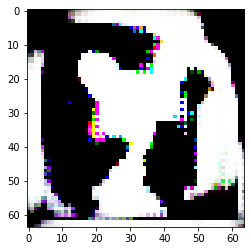

################REAL#################


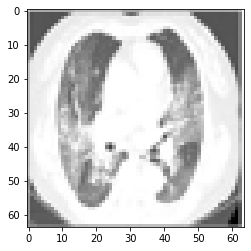

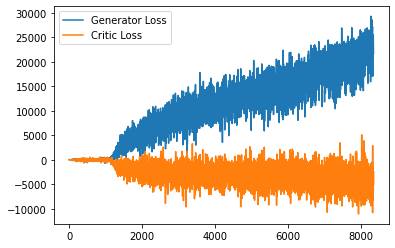

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 500, step 168000: Generator loss: 21710.02719921875, critic loss: -3973.919344472071
################FAKE#################


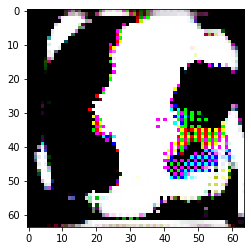

################REAL#################


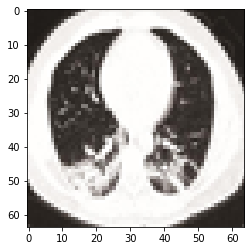

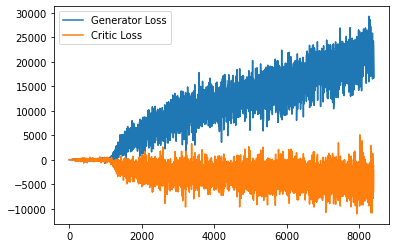

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 502, step 169000: Generator loss: 22197.936787109375, critic loss: -4100.220477752686
################FAKE#################


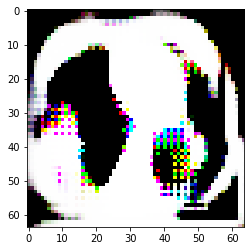

################REAL#################


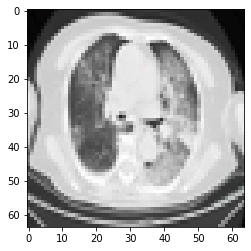

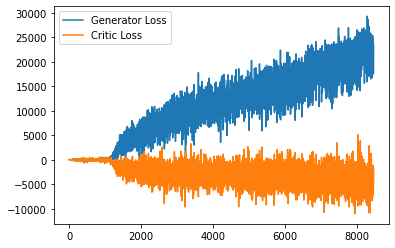

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 505, step 170000: Generator loss: 22917.13175390625, critic loss: -4726.047600073951
################FAKE#################


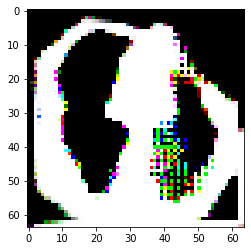

################REAL#################


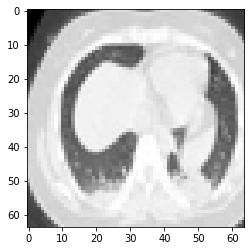

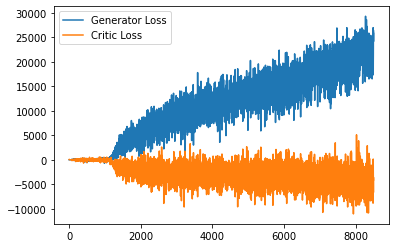

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 508, step 171000: Generator loss: 22750.1535390625, critic loss: -4477.050463254652
################FAKE#################


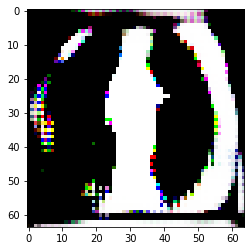

################REAL#################


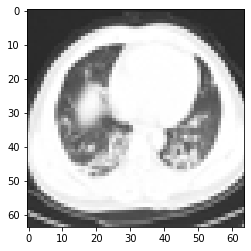

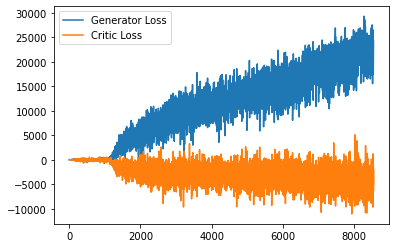

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 511, step 172000: Generator loss: 22393.020630859373, critic loss: -4359.728043343142
################FAKE#################


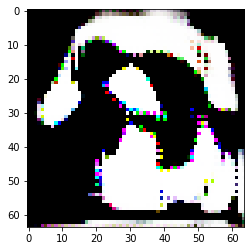

################REAL#################


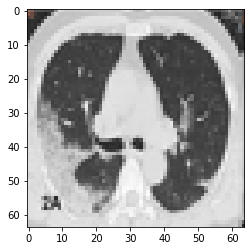

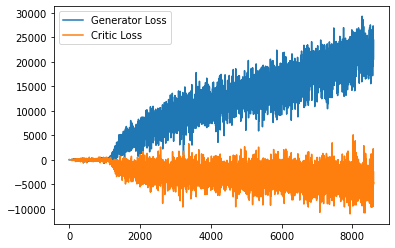

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 514, step 173000: Generator loss: 21612.298712890624, critic loss: -3736.370972764429
################FAKE#################


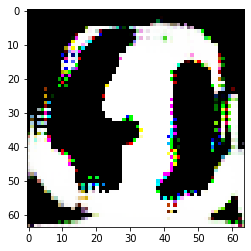

################REAL#################


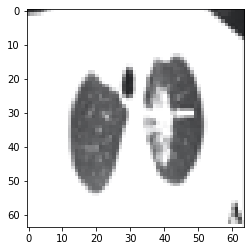

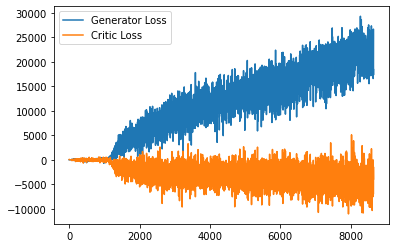

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 517, step 174000: Generator loss: 23457.472568359375, critic loss: -4810.855605154862
################FAKE#################


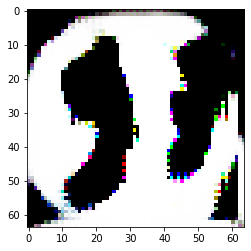

################REAL#################


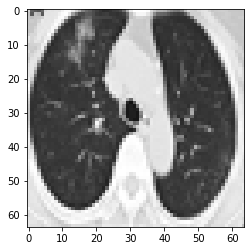

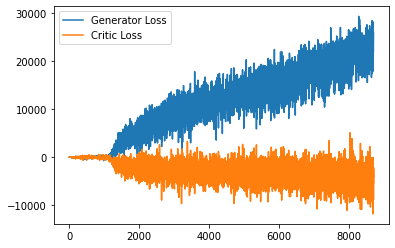

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 520, step 175000: Generator loss: 22370.683951171875, critic loss: -4189.901991431098
################FAKE#################


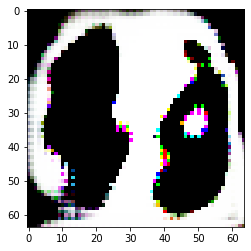

################REAL#################


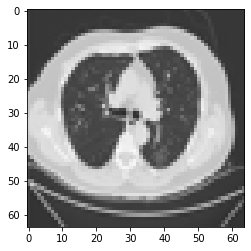

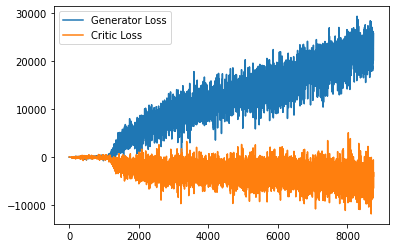

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 523, step 176000: Generator loss: 21930.56041796875, critic loss: -3853.4673822495593
################FAKE#################


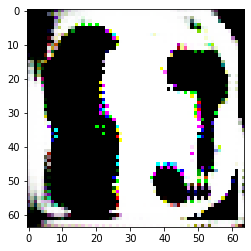

################REAL#################


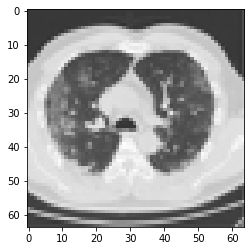

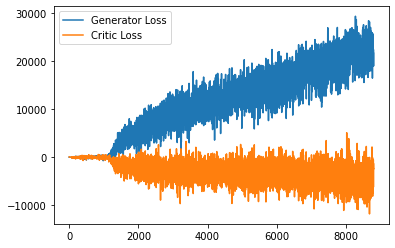

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 526, step 177000: Generator loss: 22282.48216113281, critic loss: -3797.16009742764
################FAKE#################


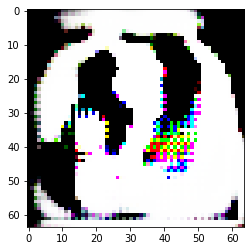

################REAL#################


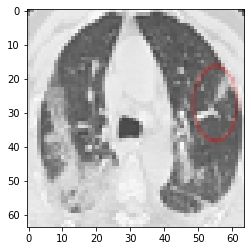

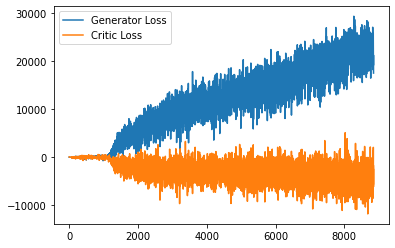

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 529, step 178000: Generator loss: 21136.424465820313, critic loss: -3907.8467444512526
################FAKE#################


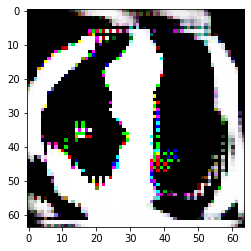

################REAL#################


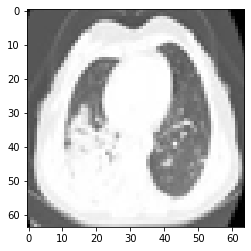

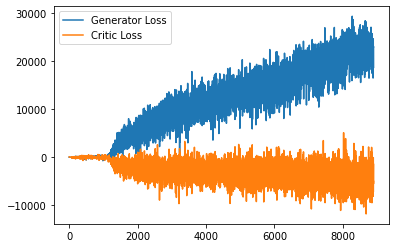

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 532, step 179000: Generator loss: 21987.936442382812, critic loss: -3890.525214098251
################FAKE#################


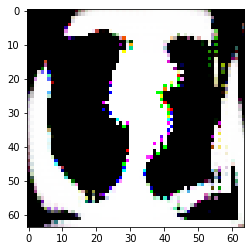

################REAL#################


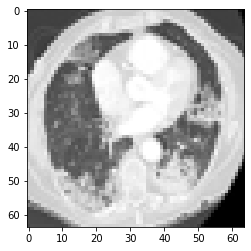

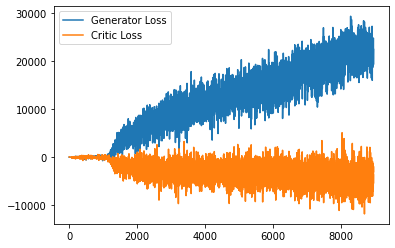

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 535, step 180000: Generator loss: 22256.851298828125, critic loss: -4071.8391192842214
################FAKE#################


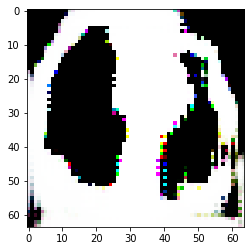

################REAL#################


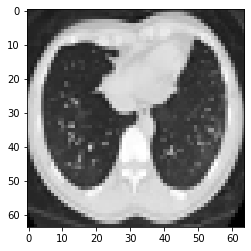

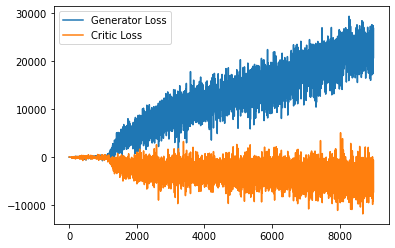

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 538, step 181000: Generator loss: 22637.237072265623, critic loss: -3749.280647289819
################FAKE#################


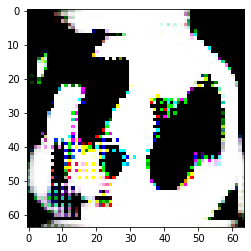

################REAL#################


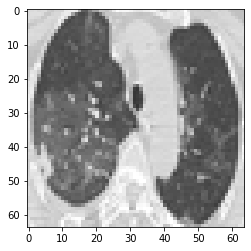

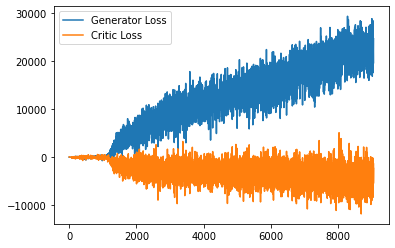

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 541, step 182000: Generator loss: 19458.437991210936, critic loss: -2338.1799050671684
################FAKE#################


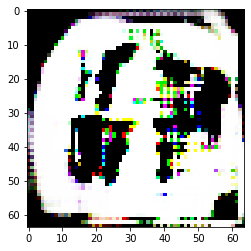

################REAL#################


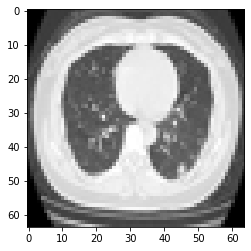

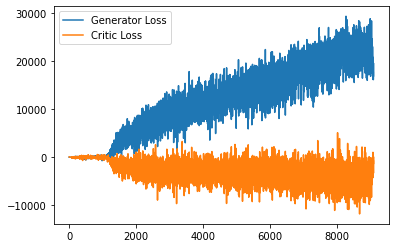

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 544, step 183000: Generator loss: 16363.745265625, critic loss: -1025.5553707523338
################FAKE#################


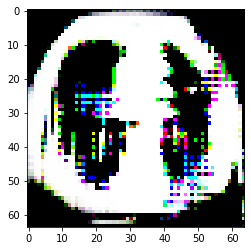

################REAL#################


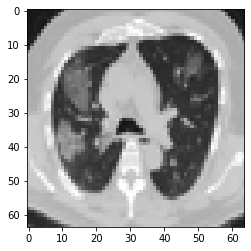

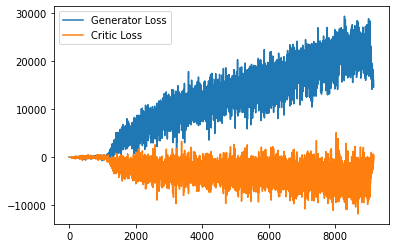

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 547, step 184000: Generator loss: 15845.191381835937, critic loss: -805.3989938091554
################FAKE#################


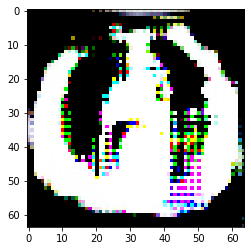

################REAL#################


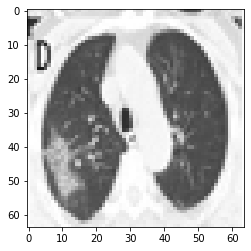

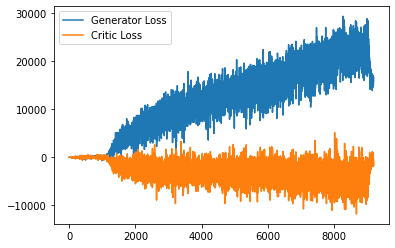

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 550, step 185000: Generator loss: 16106.535333984375, critic loss: -818.436916495152
################FAKE#################


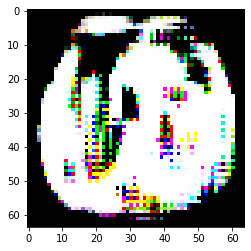

################REAL#################


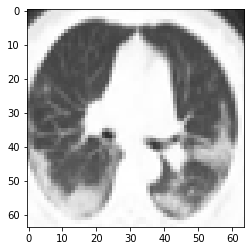

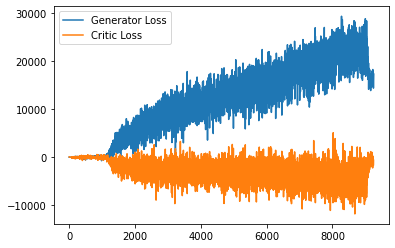

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 553, step 186000: Generator loss: 16207.695344726562, critic loss: -877.3785494614201
################FAKE#################


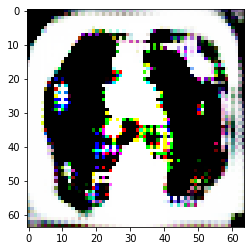

################REAL#################


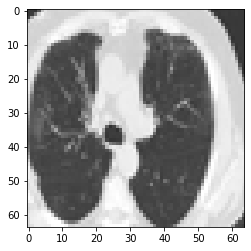

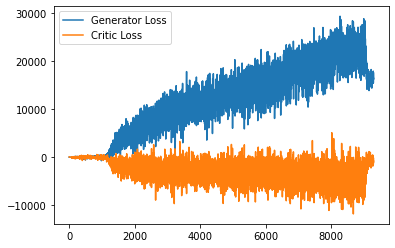

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 556, step 187000: Generator loss: 16386.060043945312, critic loss: -969.7027183047024
################FAKE#################


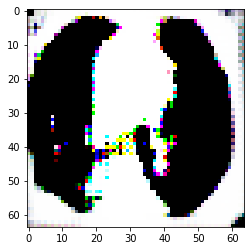

################REAL#################


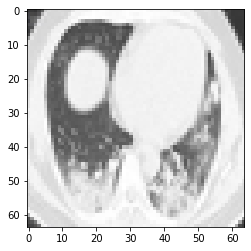

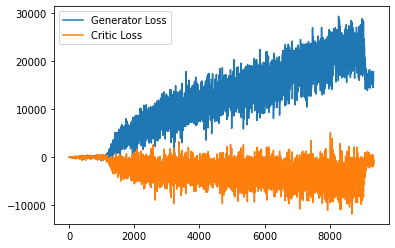

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 559, step 188000: Generator loss: 15961.78765234375, critic loss: -704.1871826707977
################FAKE#################


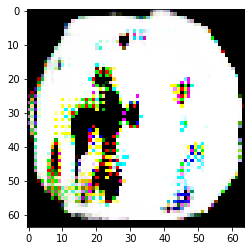

################REAL#################


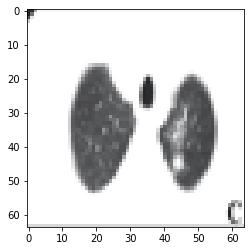

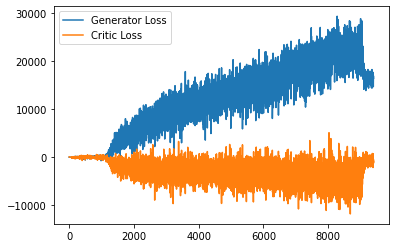

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 562, step 189000: Generator loss: 15955.504788085938, critic loss: -763.5759147478329
################FAKE#################


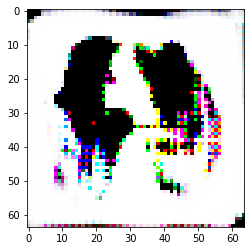

################REAL#################


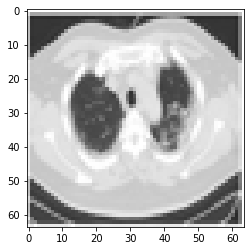

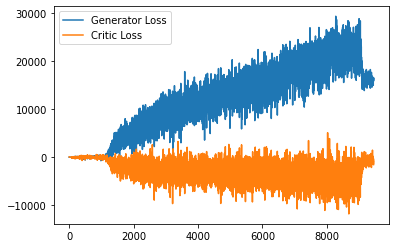

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 565, step 190000: Generator loss: 15751.193453125, critic loss: -711.665828318153
################FAKE#################


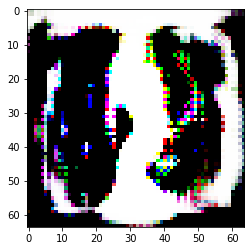

################REAL#################


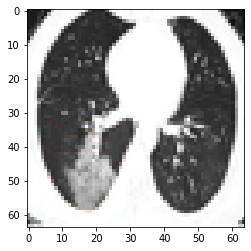

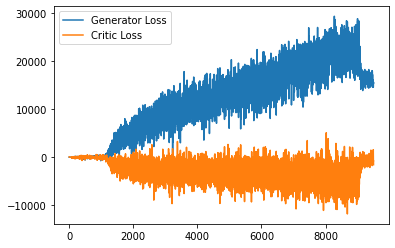

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 568, step 191000: Generator loss: 15480.935192382813, critic loss: -674.8267611982143
################FAKE#################


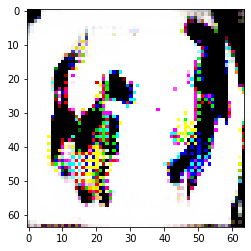

################REAL#################


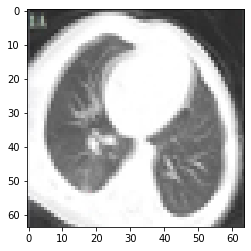

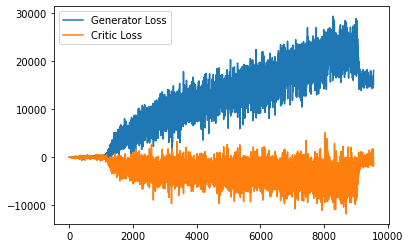

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 571, step 192000: Generator loss: 15937.629310546876, critic loss: -888.1036184906948
################FAKE#################


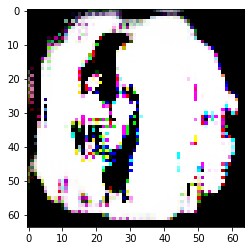

################REAL#################


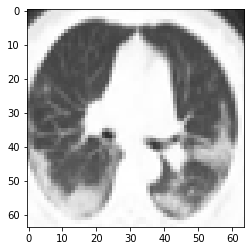

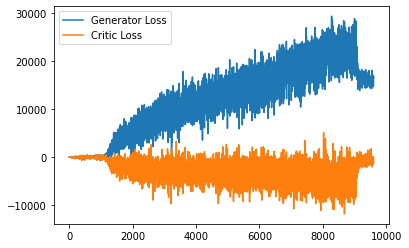

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 574, step 193000: Generator loss: 15850.860932617188, critic loss: -919.6180576509754
################FAKE#################


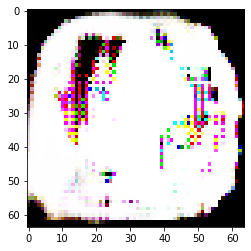

################REAL#################


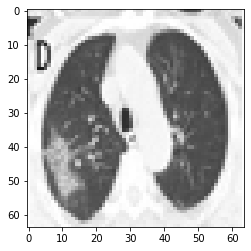

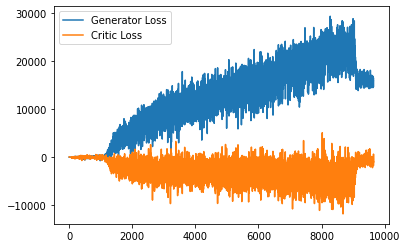

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 577, step 194000: Generator loss: 15646.042059570313, critic loss: -882.2241912011933
################FAKE#################


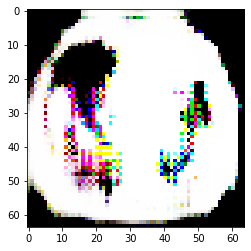

################REAL#################


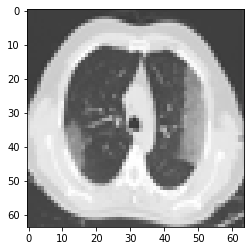

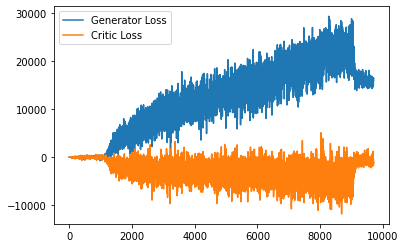

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 580, step 195000: Generator loss: 15783.816833007813, critic loss: -923.2490033075815
################FAKE#################


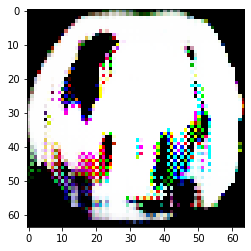

################REAL#################


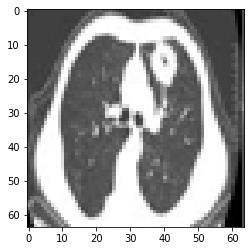

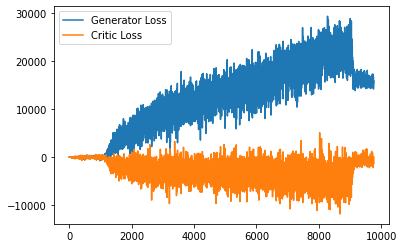

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 583, step 196000: Generator loss: 15782.334174804688, critic loss: -950.3331312913755
################FAKE#################


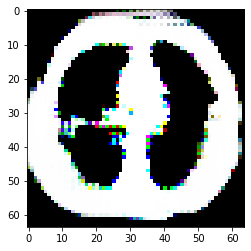

################REAL#################


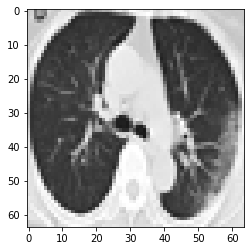

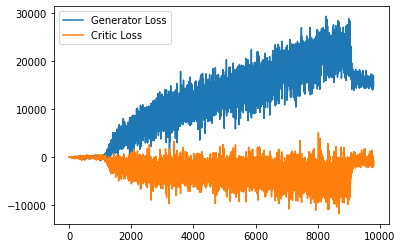

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 586, step 197000: Generator loss: 15775.663879882812, critic loss: -935.318537639941
################FAKE#################


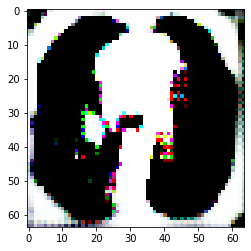

################REAL#################


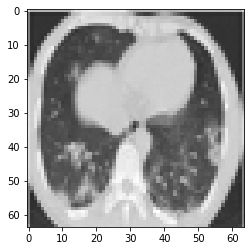

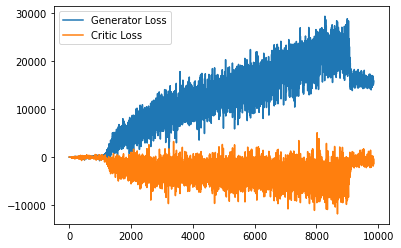

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 589, step 198000: Generator loss: 15689.241814453126, critic loss: -888.9230933030667
################FAKE#################


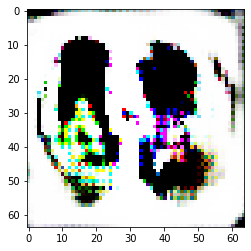

################REAL#################


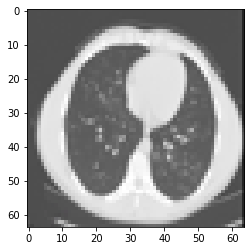

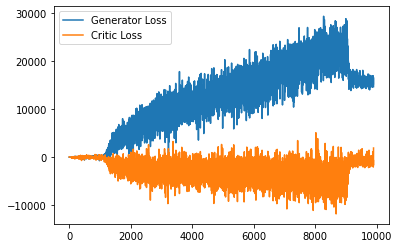

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 592, step 199000: Generator loss: 15340.547528320312, critic loss: -782.2433731134612
################FAKE#################


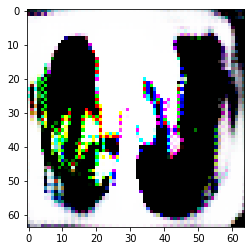

################REAL#################


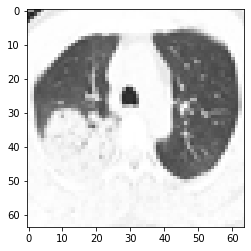

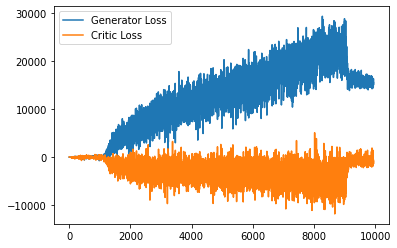

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 595, step 200000: Generator loss: 15547.2520078125, critic loss: -1023.5158253639768
################FAKE#################


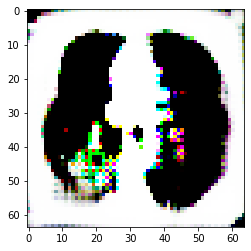

################REAL#################


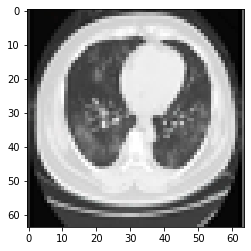

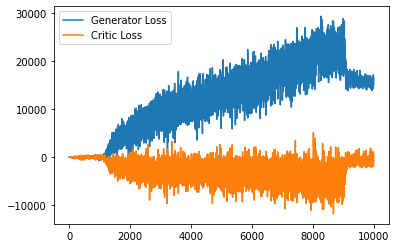

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 598, step 201000: Generator loss: 15485.683375976563, critic loss: -985.284424569131
################FAKE#################


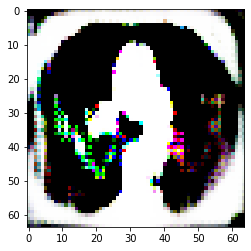

################REAL#################


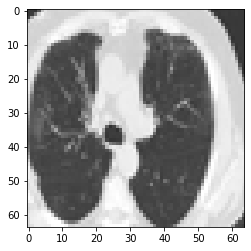

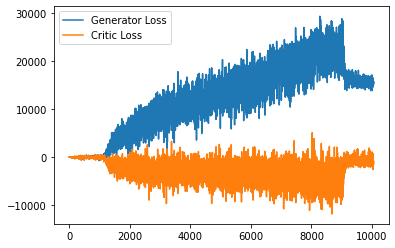

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 601, step 202000: Generator loss: 15219.777317382812, critic loss: -870.7414904847836
################FAKE#################


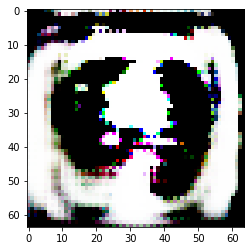

################REAL#################


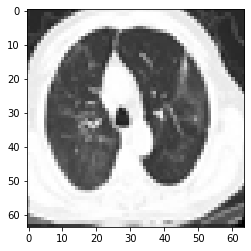

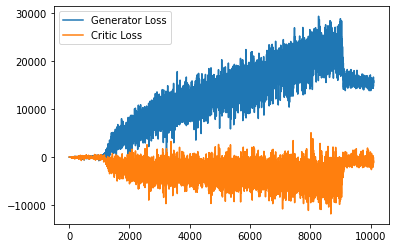

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 604, step 203000: Generator loss: 15449.98089453125, critic loss: -935.9539390029548
################FAKE#################


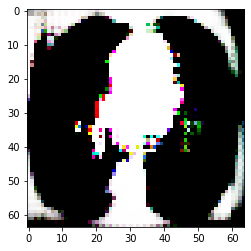

################REAL#################


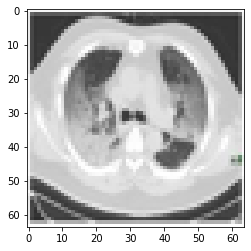

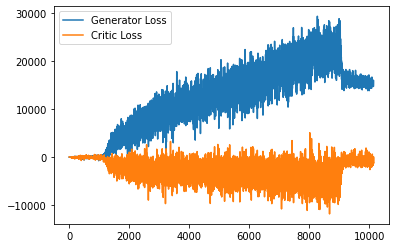

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 607, step 204000: Generator loss: 15364.026991210938, critic loss: -822.809164514814
################FAKE#################


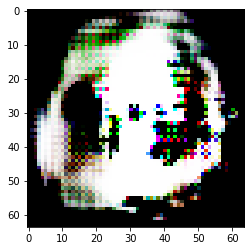

################REAL#################


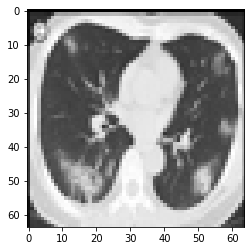

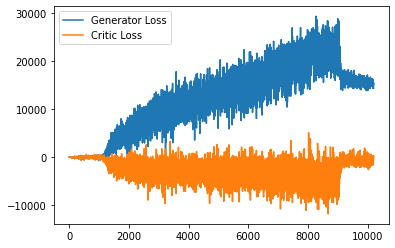

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 610, step 205000: Generator loss: 15405.538506835937, critic loss: -909.7646966361148
################FAKE#################


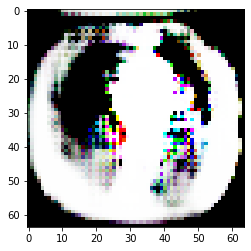

################REAL#################


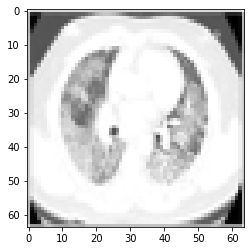

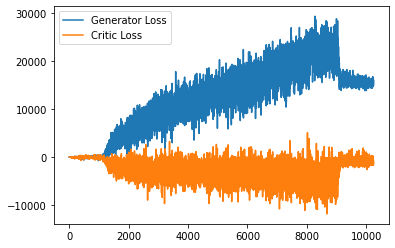

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 613, step 206000: Generator loss: 15478.389786132813, critic loss: -771.1500815292774
################FAKE#################


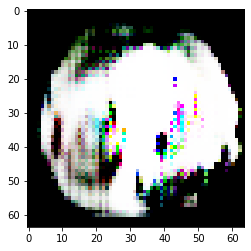

################REAL#################


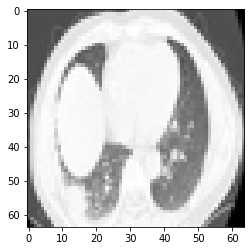

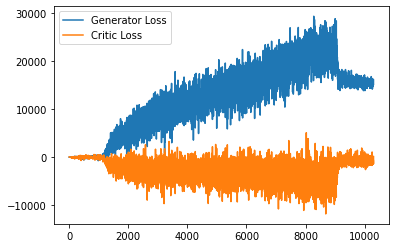

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 616, step 207000: Generator loss: 15547.182751953125, critic loss: -873.4160228873997
################FAKE#################


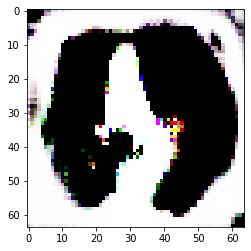

################REAL#################


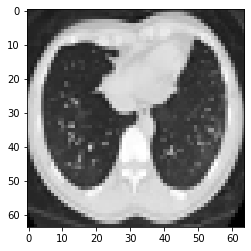

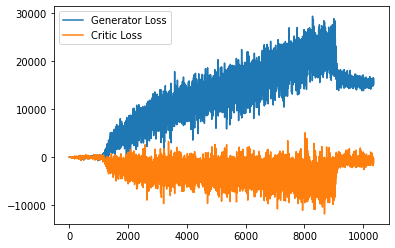

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 619, step 208000: Generator loss: 15376.56503125, critic loss: -779.636189332997
################FAKE#################


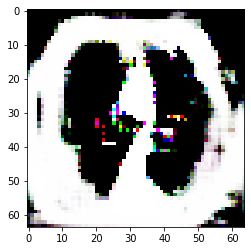

################REAL#################


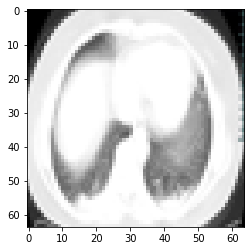

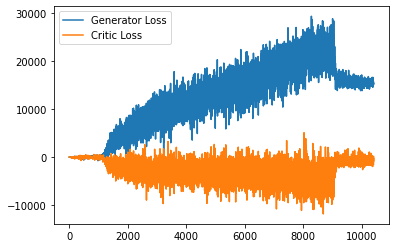

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 622, step 209000: Generator loss: 15283.601444335938, critic loss: -802.4085745726318
################FAKE#################


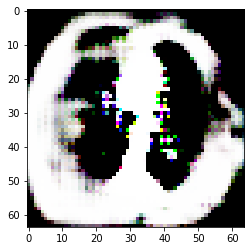

################REAL#################


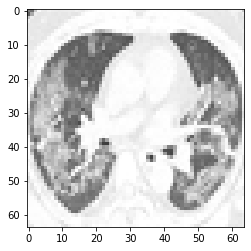

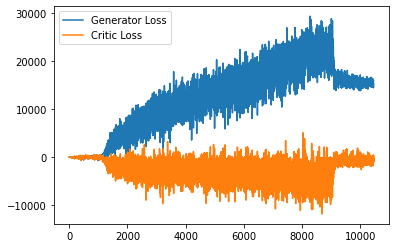

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 625, step 210000: Generator loss: 15349.98741796875, critic loss: -819.2493419008939
################FAKE#################


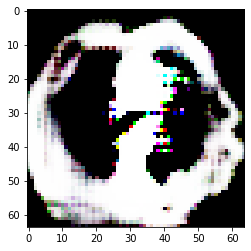

################REAL#################


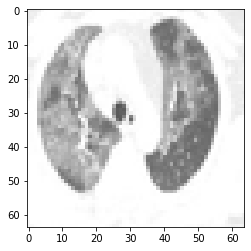

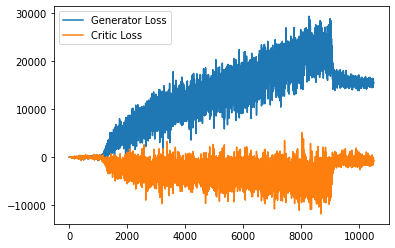

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 627, step 211000: Generator loss: 15349.213608398437, critic loss: -814.6445587063513
################FAKE#################


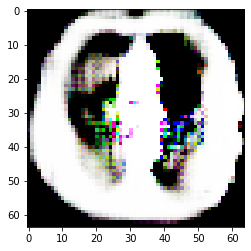

################REAL#################


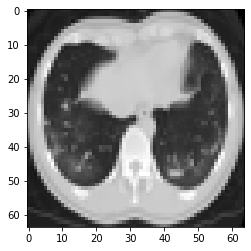

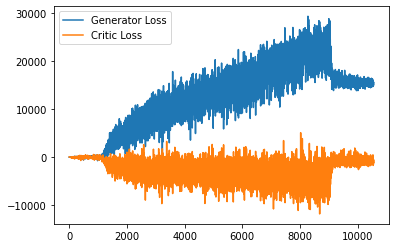

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 630, step 212000: Generator loss: 15560.306319335938, critic loss: -863.0032677379004
################FAKE#################


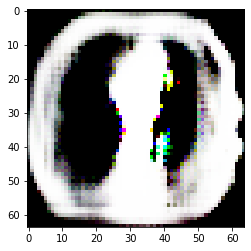

################REAL#################


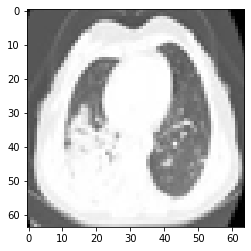

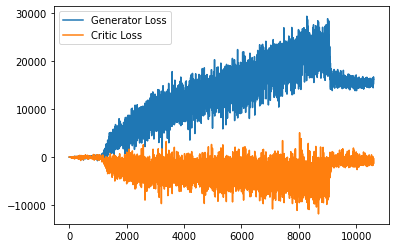

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 633, step 213000: Generator loss: 15494.203392578125, critic loss: -749.1384419377868
################FAKE#################


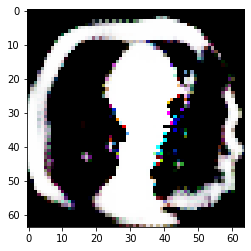

################REAL#################


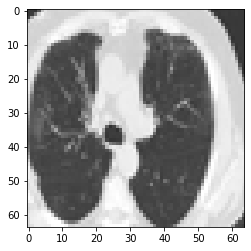

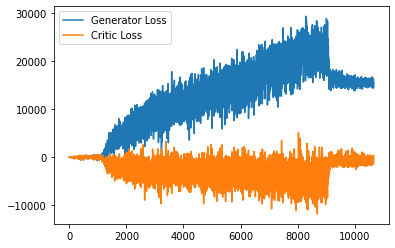

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 636, step 214000: Generator loss: 15512.179352539062, critic loss: -831.4072342870064
################FAKE#################


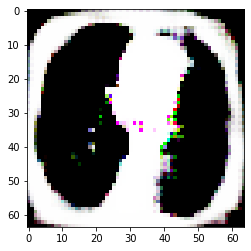

################REAL#################


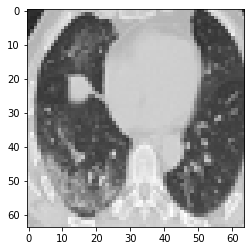

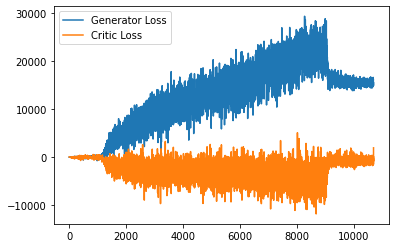

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 639, step 215000: Generator loss: 15239.197436523438, critic loss: -786.040015287808
################FAKE#################


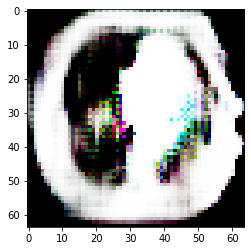

################REAL#################


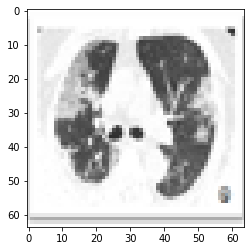

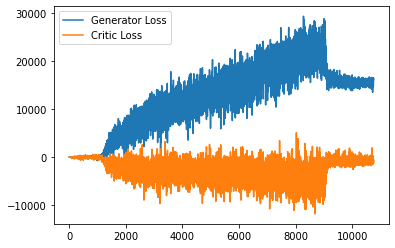

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 642, step 216000: Generator loss: 15491.482897460937, critic loss: -706.8290073248834
################FAKE#################


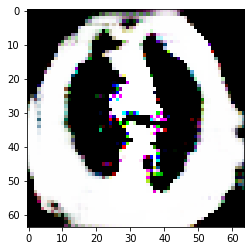

################REAL#################


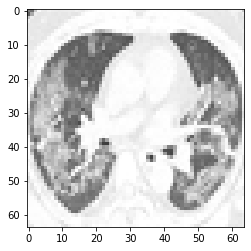

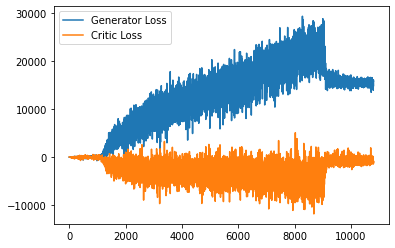

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 645, step 217000: Generator loss: 15439.276448242188, critic loss: -784.2163350572579
################FAKE#################


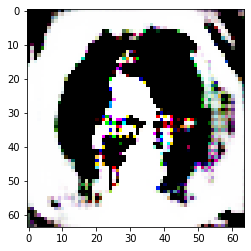

################REAL#################


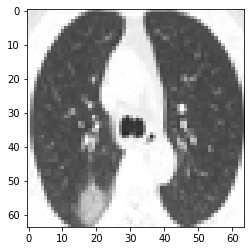

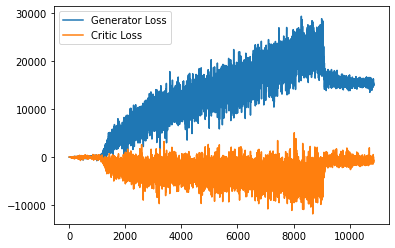

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 648, step 218000: Generator loss: 15581.045243164062, critic loss: -790.9361989111729
################FAKE#################


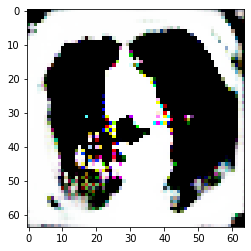

################REAL#################


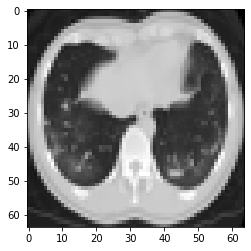

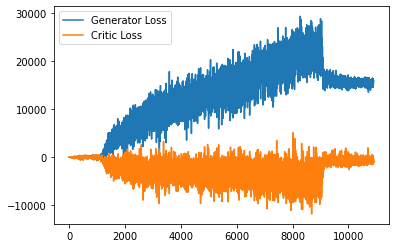

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 651, step 219000: Generator loss: 15688.093837890625, critic loss: -880.0836152520515
################FAKE#################


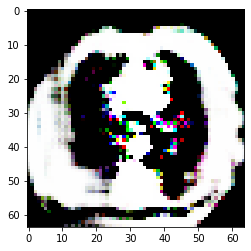

################REAL#################


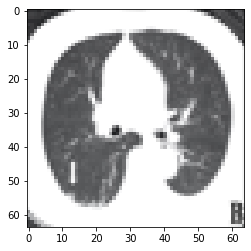

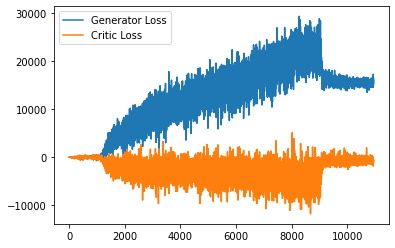

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 654, step 220000: Generator loss: 15533.127750976562, critic loss: -775.615049069234
################FAKE#################


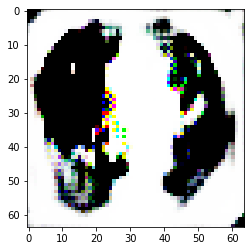

################REAL#################


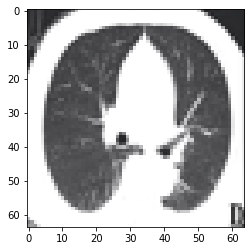

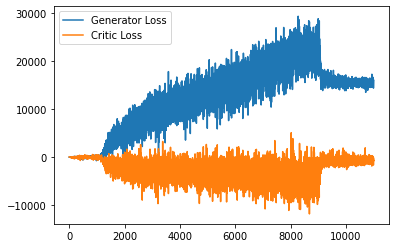

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 657, step 221000: Generator loss: 15540.512545898437, critic loss: -811.3776421500015
################FAKE#################


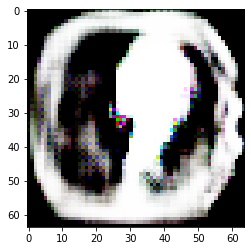

################REAL#################


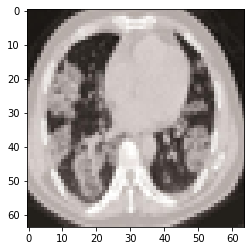

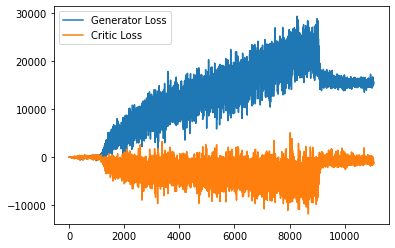

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 660, step 222000: Generator loss: 15292.81149609375, critic loss: -789.1721051457275
################FAKE#################


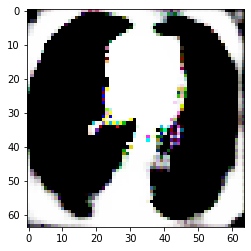

################REAL#################


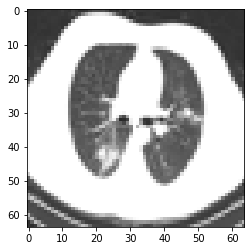

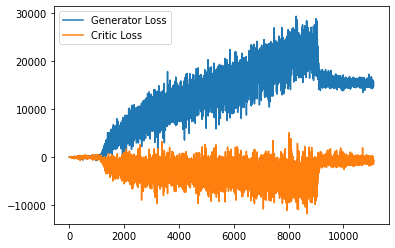

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 663, step 223000: Generator loss: 15351.457465820313, critic loss: -763.0226673044474
################FAKE#################


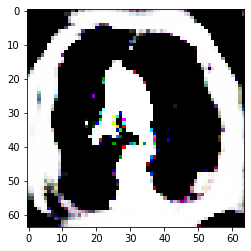

################REAL#################


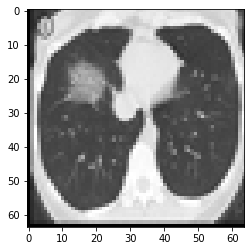

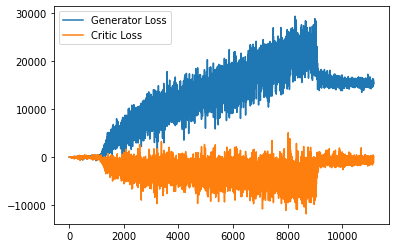

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 666, step 224000: Generator loss: 15514.802302734375, critic loss: -882.2058300228801
################FAKE#################


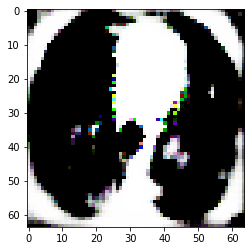

################REAL#################


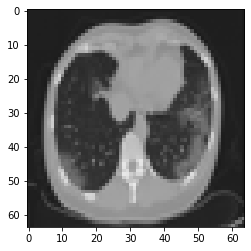

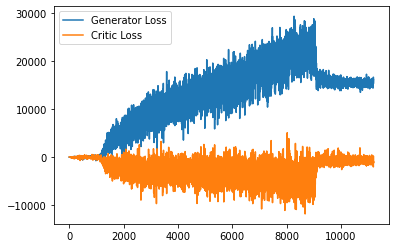

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 669, step 225000: Generator loss: 15195.011473632812, critic loss: -781.8440925516064
################FAKE#################


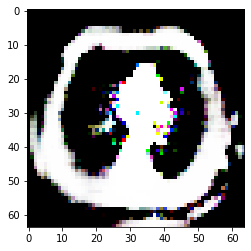

################REAL#################


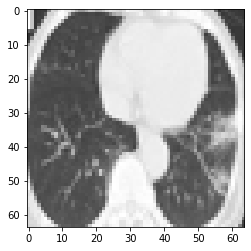

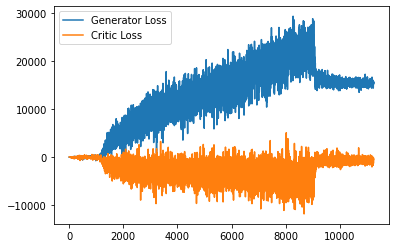

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 672, step 226000: Generator loss: 15124.085532226563, critic loss: -718.7995428372104
################FAKE#################


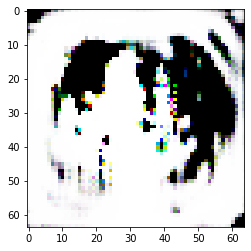

################REAL#################


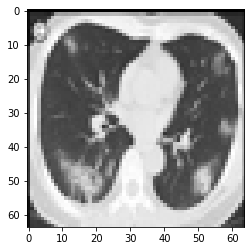

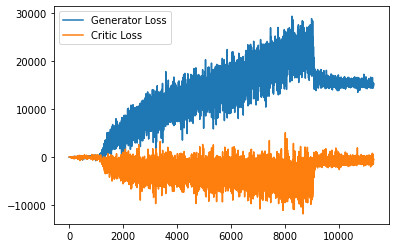

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 675, step 227000: Generator loss: 15084.994607421875, critic loss: -674.033860135573
################FAKE#################


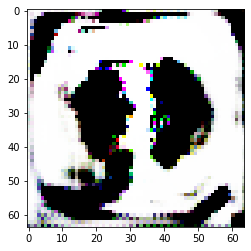

################REAL#################


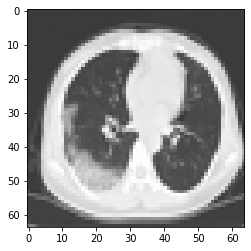

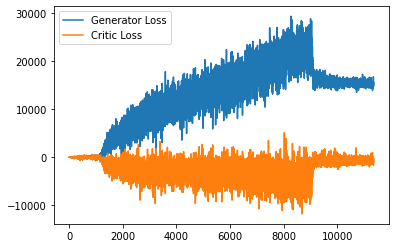

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 678, step 228000: Generator loss: 15432.683290039062, critic loss: -769.9752423416722
################FAKE#################


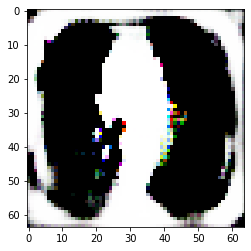

################REAL#################


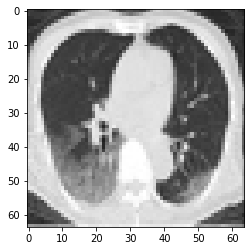

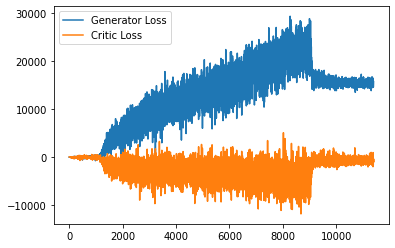

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 681, step 229000: Generator loss: 15531.685940429688, critic loss: -885.3696789686177
################FAKE#################


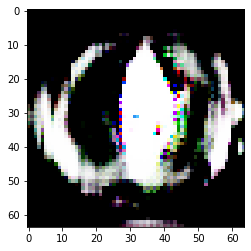

################REAL#################


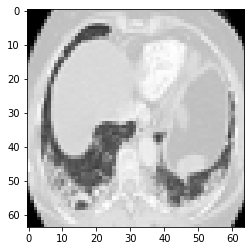

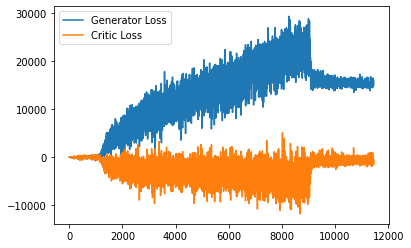

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 684, step 230000: Generator loss: 15261.33923828125, critic loss: -735.5894366318157
################FAKE#################


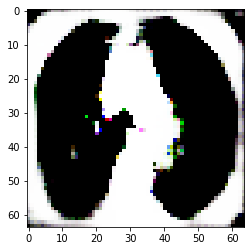

################REAL#################


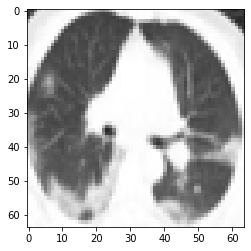

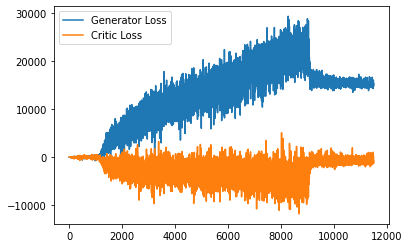

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 687, step 231000: Generator loss: 15449.09090625, critic loss: -771.7470953392301
################FAKE#################


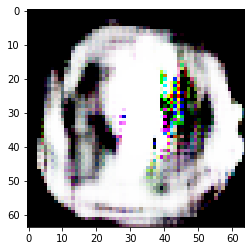

################REAL#################


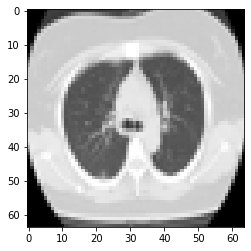

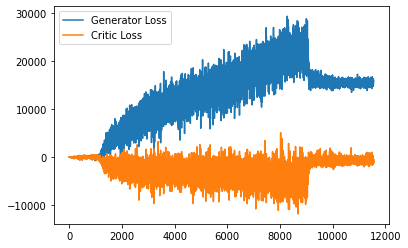

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 690, step 232000: Generator loss: 15616.478008789063, critic loss: -905.8479653066213
################FAKE#################


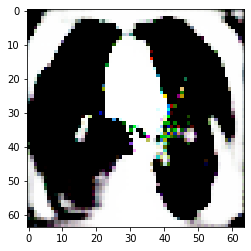

################REAL#################


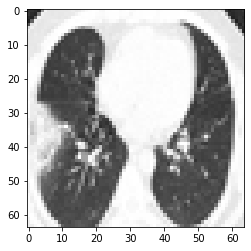

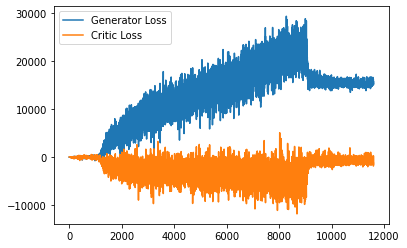

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 693, step 233000: Generator loss: 15483.009137695313, critic loss: -872.5402036262241
################FAKE#################


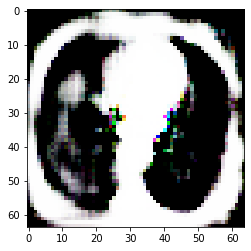

################REAL#################


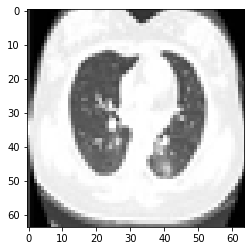

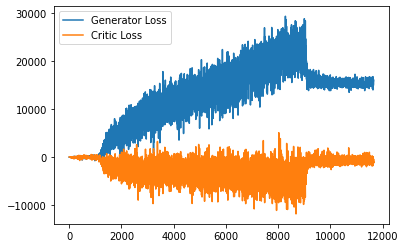

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 696, step 234000: Generator loss: 15584.588584960937, critic loss: -768.104298556057
################FAKE#################


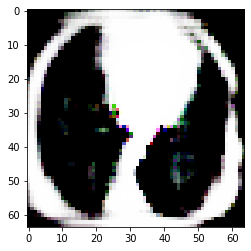

################REAL#################


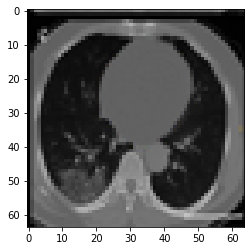

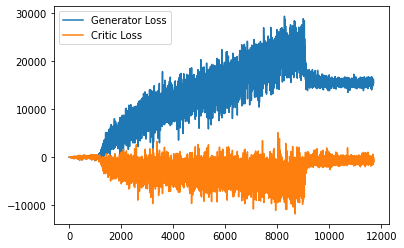

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 699, step 235000: Generator loss: 15562.814731445313, critic loss: -819.1585115547169
################FAKE#################


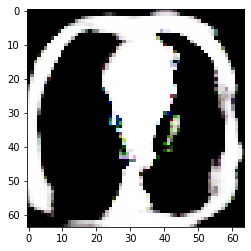

################REAL#################


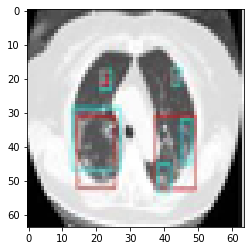

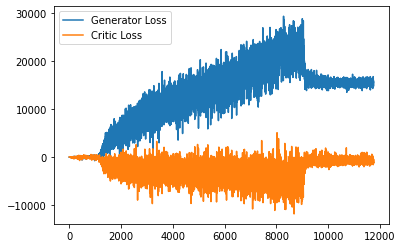

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 702, step 236000: Generator loss: 15570.532100585937, critic loss: -778.1488239818987
################FAKE#################


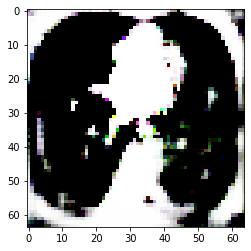

################REAL#################


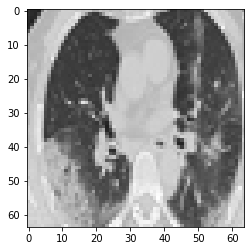

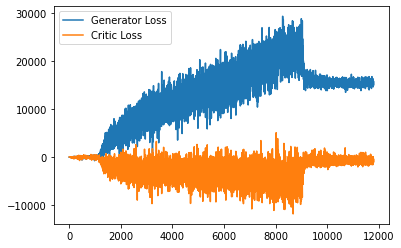

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 705, step 237000: Generator loss: 15682.922870117187, critic loss: -851.7298339154718
################FAKE#################


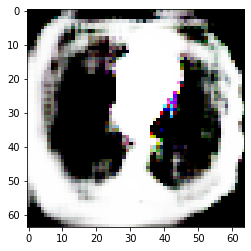

################REAL#################


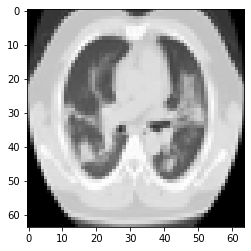

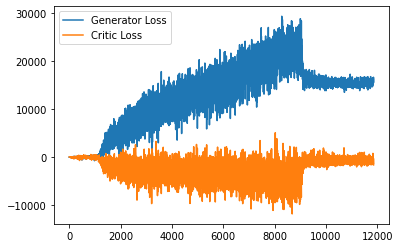

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 708, step 238000: Generator loss: 15652.972043945312, critic loss: -822.6026004387306
################FAKE#################


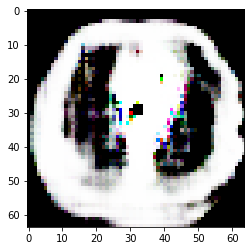

################REAL#################


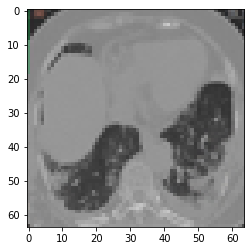

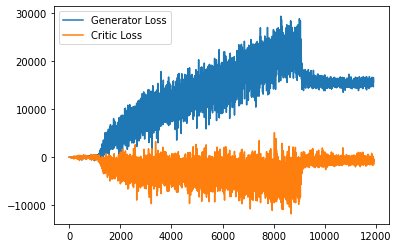

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 711, step 239000: Generator loss: 15618.67734375, critic loss: -765.9886557260248
################FAKE#################


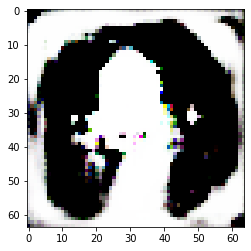

################REAL#################


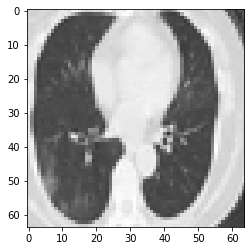

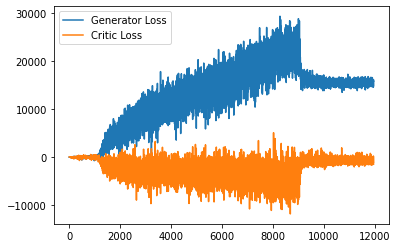

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 714, step 240000: Generator loss: 15383.648883789063, critic loss: -663.3157081848898
################FAKE#################


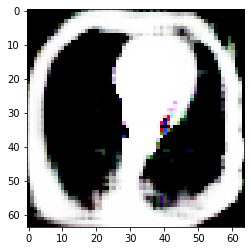

################REAL#################


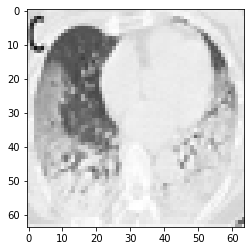

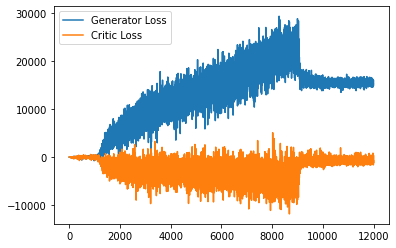

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 717, step 241000: Generator loss: 15272.397874023438, critic loss: -734.5966423008093
################FAKE#################


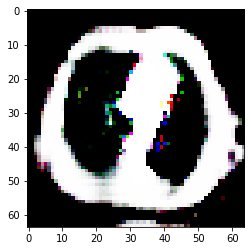

################REAL#################


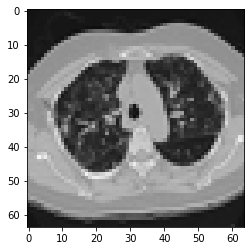

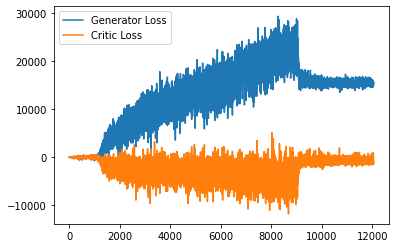

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 720, step 242000: Generator loss: 15478.725611328126, critic loss: -862.3899731798512
################FAKE#################


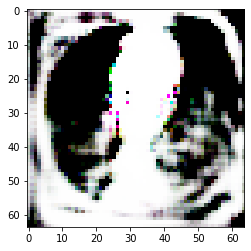

################REAL#################


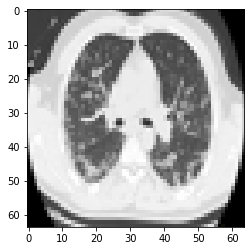

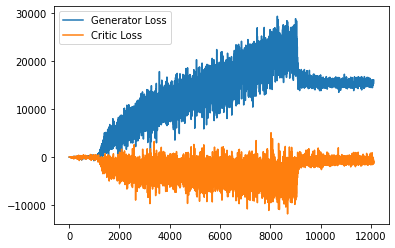

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 723, step 243000: Generator loss: 15502.362990234375, critic loss: -829.3978819578032
################FAKE#################


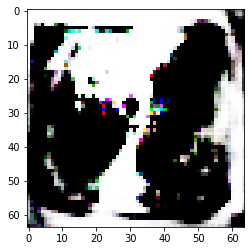

################REAL#################


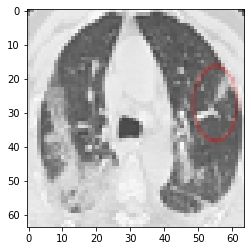

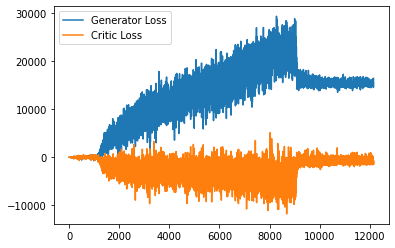

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 726, step 244000: Generator loss: 15313.852418945313, critic loss: -804.8723909590932
################FAKE#################


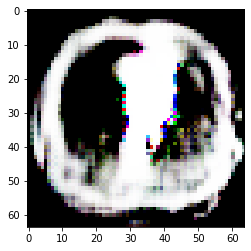

################REAL#################


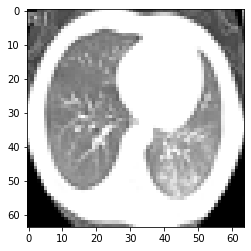

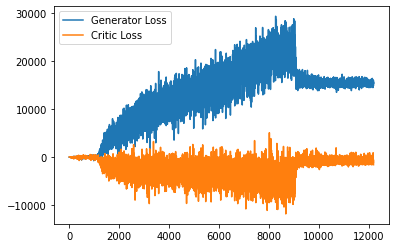

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 729, step 245000: Generator loss: 15370.69557421875, critic loss: -813.4694660174096
################FAKE#################


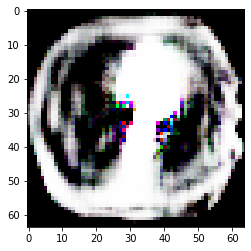

################REAL#################


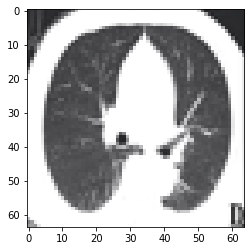

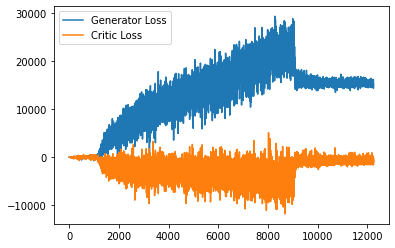

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 732, step 246000: Generator loss: 15412.602259765625, critic loss: -843.6630772072194
################FAKE#################


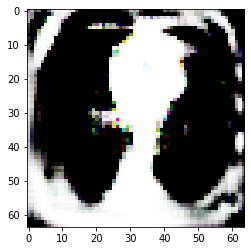

################REAL#################


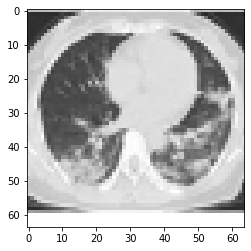

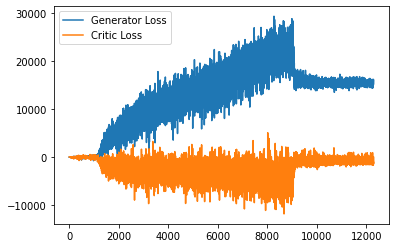

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 735, step 247000: Generator loss: 15417.938096679687, critic loss: -905.5380953796936
################FAKE#################


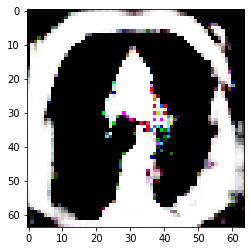

################REAL#################


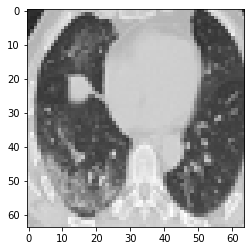

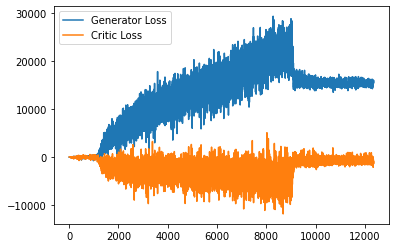

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 738, step 248000: Generator loss: 15327.464212890625, critic loss: -760.3558568676807
################FAKE#################


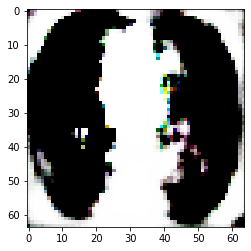

################REAL#################


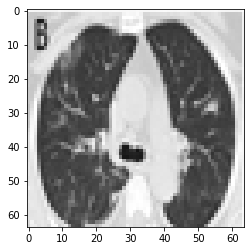

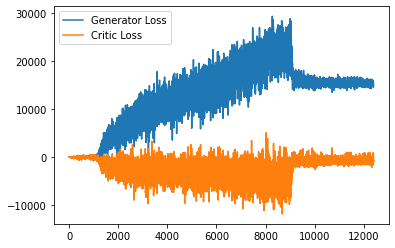

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 741, step 249000: Generator loss: 15158.320578125, critic loss: -697.3934281177071
################FAKE#################


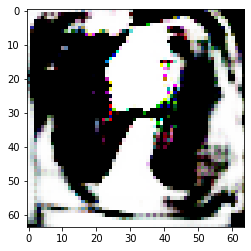

################REAL#################


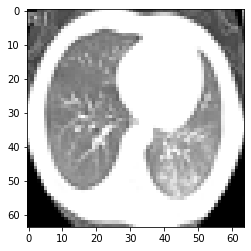

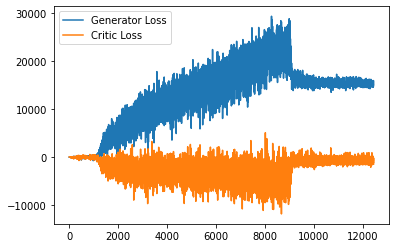

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 744, step 250000: Generator loss: 15218.275180664063, critic loss: -853.9736923722205
################FAKE#################


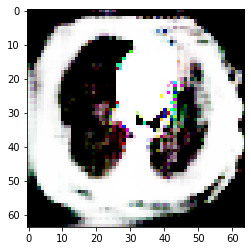

################REAL#################


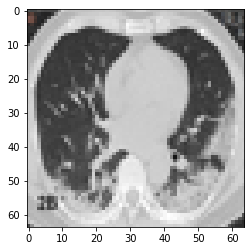

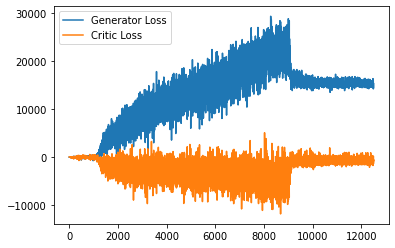

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 747, step 251000: Generator loss: 15250.515119140626, critic loss: -809.2131773852799
################FAKE#################


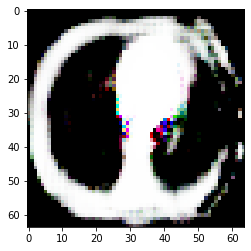

################REAL#################


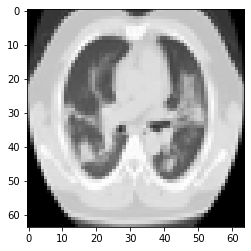

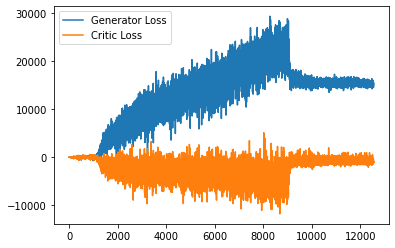

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 750, step 252000: Generator loss: 15333.934946289062, critic loss: -793.5449303614762
################FAKE#################


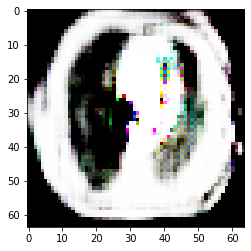

################REAL#################


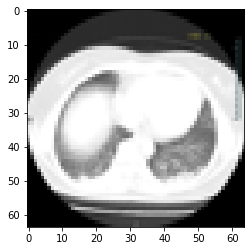

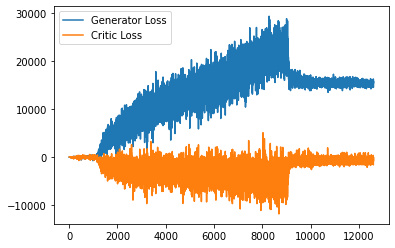

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 752, step 253000: Generator loss: 15377.140272460938, critic loss: -867.9497082409166
################FAKE#################


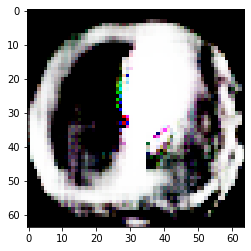

################REAL#################


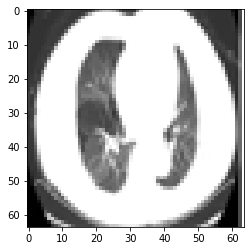

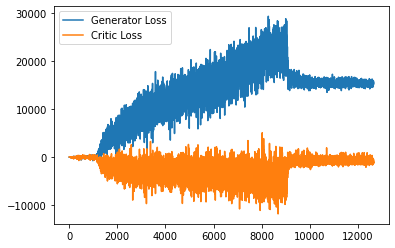

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 755, step 254000: Generator loss: 15496.19231640625, critic loss: -751.166487158162
################FAKE#################


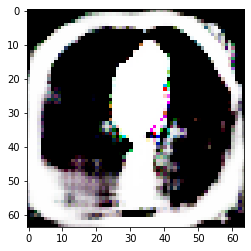

################REAL#################


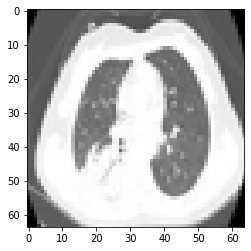

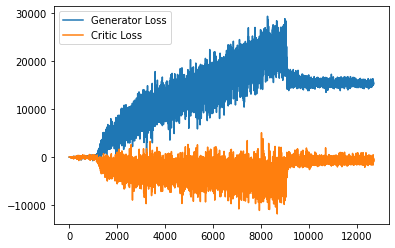

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 758, step 255000: Generator loss: 15426.963452148437, critic loss: -827.1513602471014
################FAKE#################


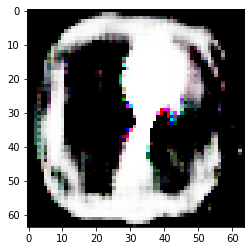

################REAL#################


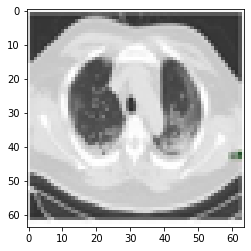

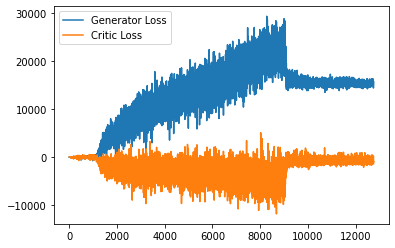

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 761, step 256000: Generator loss: 15432.828953125, critic loss: -1005.3136074979295
################FAKE#################


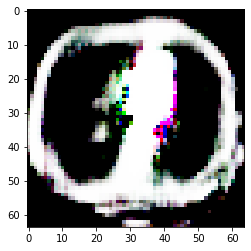

################REAL#################


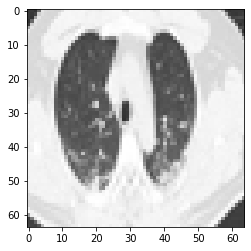

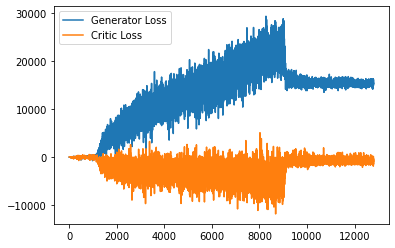

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 764, step 257000: Generator loss: 15254.49988671875, critic loss: -719.4115457616883
################FAKE#################


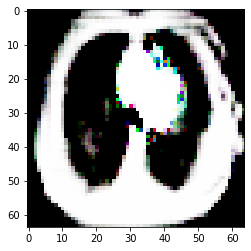

################REAL#################


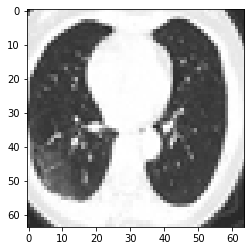

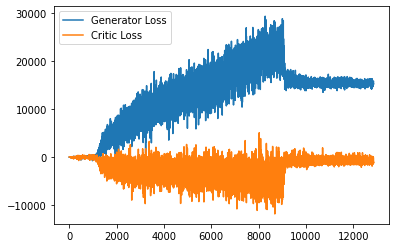

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 767, step 258000: Generator loss: 15374.191500976562, critic loss: -847.7959087830262
################FAKE#################


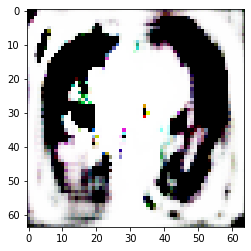

################REAL#################


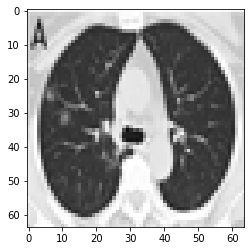

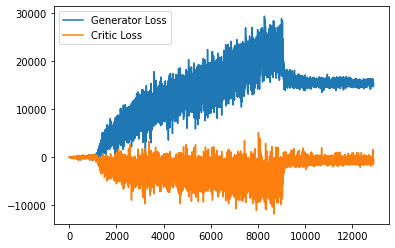

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 770, step 259000: Generator loss: 15299.160036132813, critic loss: -854.5498573012352
################FAKE#################


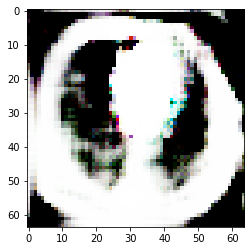

################REAL#################


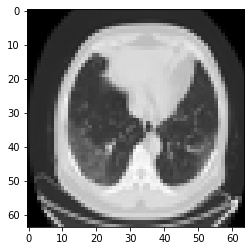

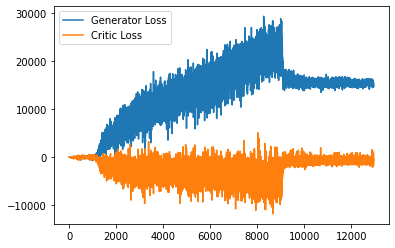

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 773, step 260000: Generator loss: 15081.396639648437, critic loss: -929.5915446865213
################FAKE#################


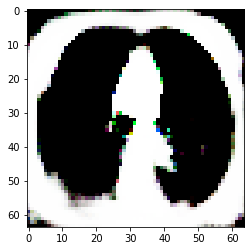

################REAL#################


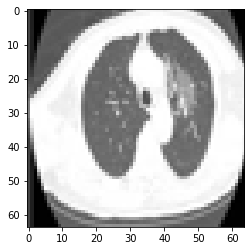

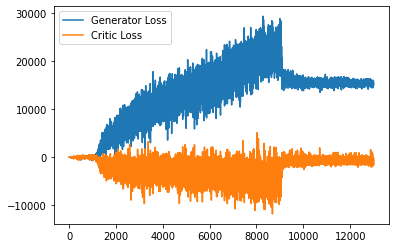

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 776, step 261000: Generator loss: 15482.2518125, critic loss: -761.1833635593821
################FAKE#################


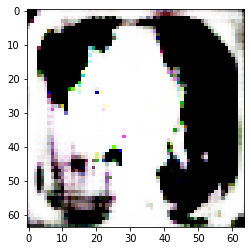

################REAL#################


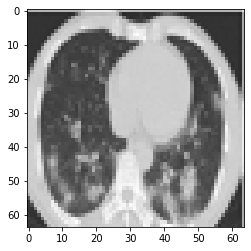

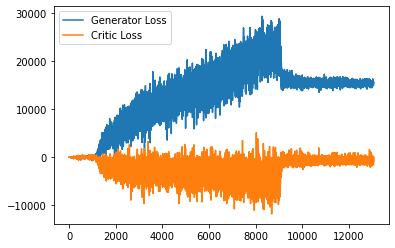

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 779, step 262000: Generator loss: 15218.954173828124, critic loss: -872.9243483586993
################FAKE#################


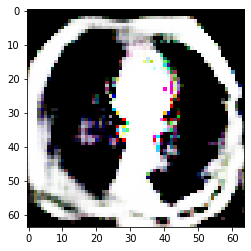

################REAL#################


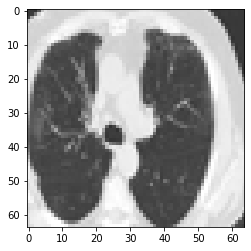

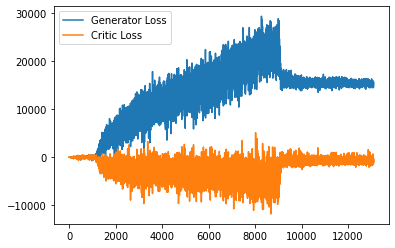

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 782, step 263000: Generator loss: 15221.424244140626, critic loss: -807.0702659683903
################FAKE#################


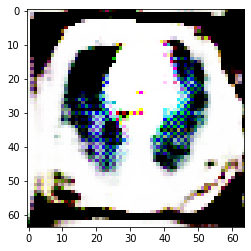

################REAL#################


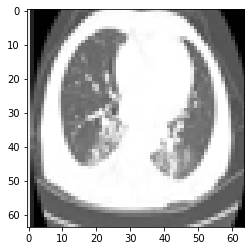

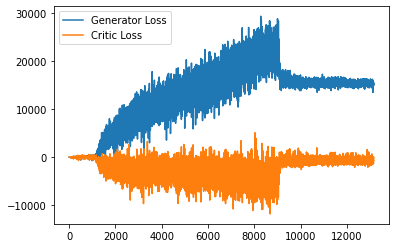

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 785, step 264000: Generator loss: 15235.943041992188, critic loss: -826.0664799364292
################FAKE#################


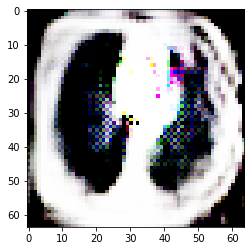

################REAL#################


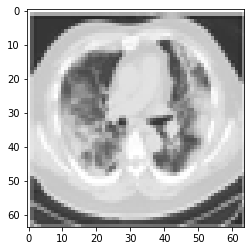

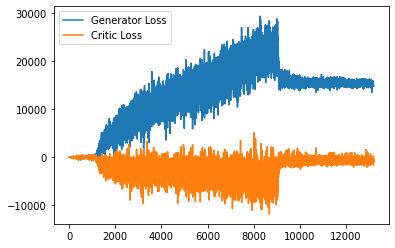

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 788, step 265000: Generator loss: 15162.344157226562, critic loss: -940.3904116531784
################FAKE#################


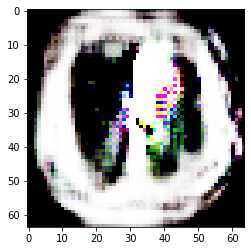

################REAL#################


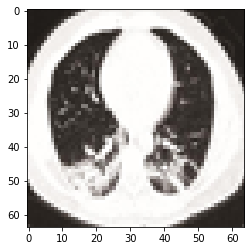

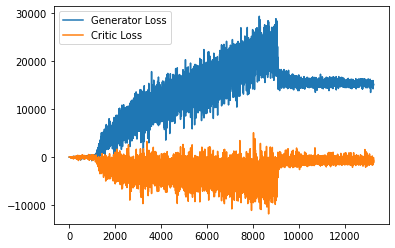

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 791, step 266000: Generator loss: 15015.5628359375, critic loss: -833.2324876695527
################FAKE#################


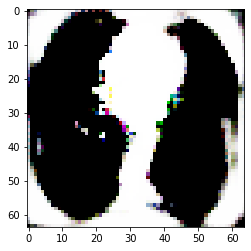

################REAL#################


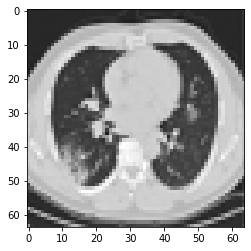

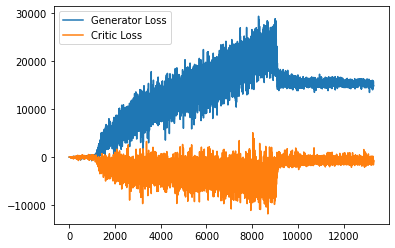

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 794, step 267000: Generator loss: 15052.86592578125, critic loss: -786.1997928432731
################FAKE#################


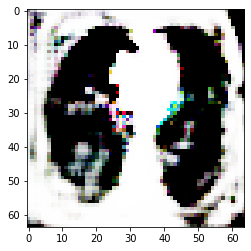

################REAL#################


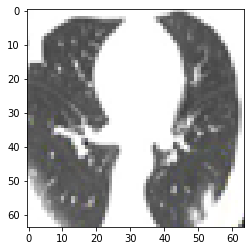

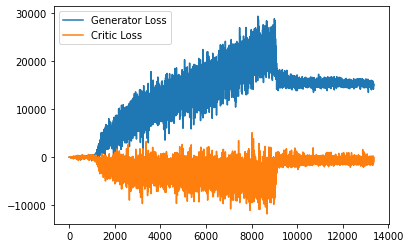

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 797, step 268000: Generator loss: 15031.198389648438, critic loss: -881.1515844010635
################FAKE#################


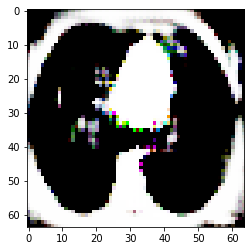

################REAL#################


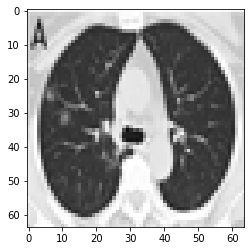

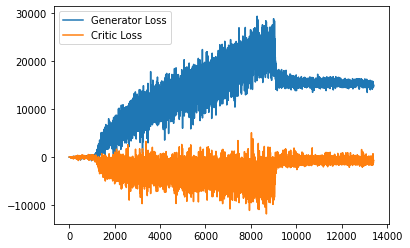

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 800, step 269000: Generator loss: 15034.107821289062, critic loss: -859.5085198003884
################FAKE#################


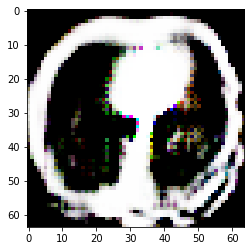

################REAL#################


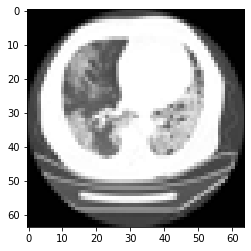

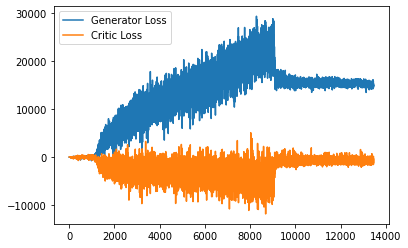

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 803, step 270000: Generator loss: 14771.779370117187, critic loss: -812.1660979467115
################FAKE#################


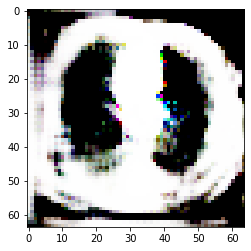

################REAL#################


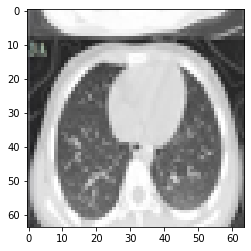

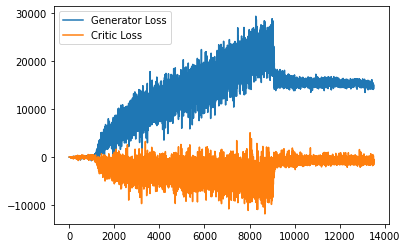

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 806, step 271000: Generator loss: 14756.0590390625, critic loss: -824.2703190720418
################FAKE#################


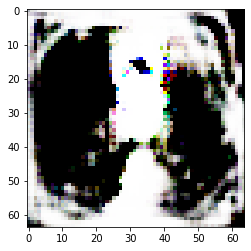

################REAL#################


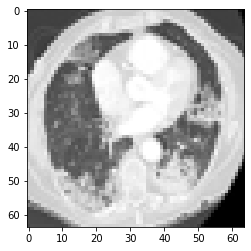

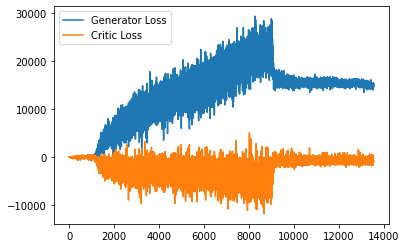

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 809, step 272000: Generator loss: 14863.226709960938, critic loss: -799.328138596262
################FAKE#################


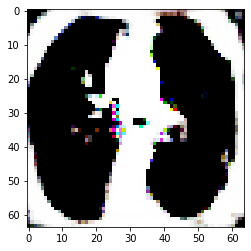

################REAL#################


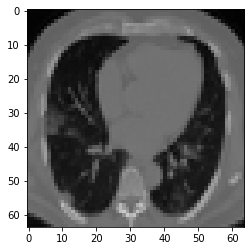

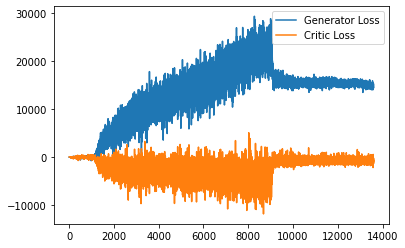

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 812, step 273000: Generator loss: 14866.24433203125, critic loss: -890.9683343650275
################FAKE#################


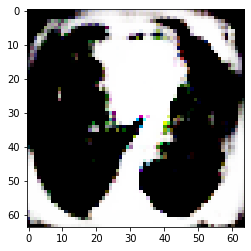

################REAL#################


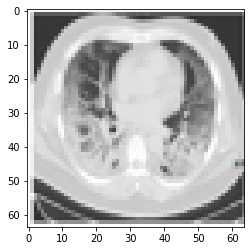

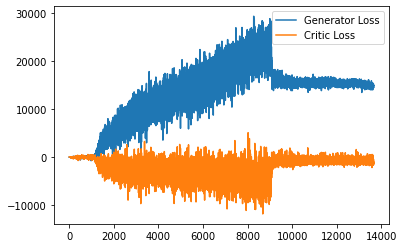

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 815, step 274000: Generator loss: 14944.512111328126, critic loss: -804.5494091267587
################FAKE#################


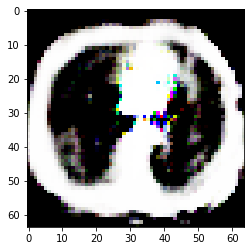

################REAL#################


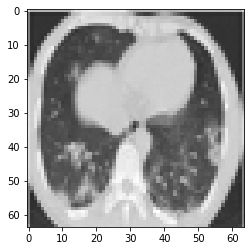

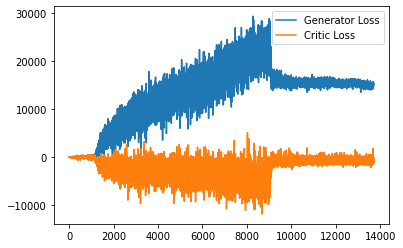

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 818, step 275000: Generator loss: 14977.193000976562, critic loss: -805.7754395327564
################FAKE#################


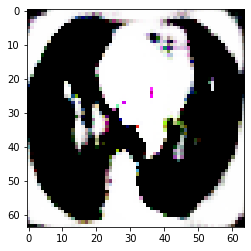

################REAL#################


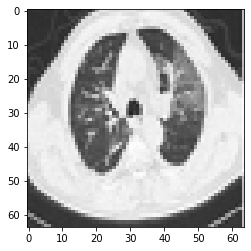

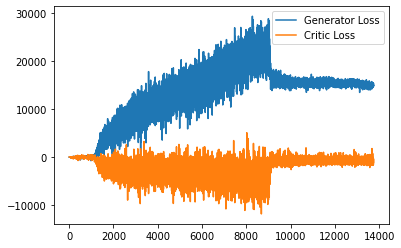

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 821, step 276000: Generator loss: 14979.270051757812, critic loss: -884.5905293224886
################FAKE#################


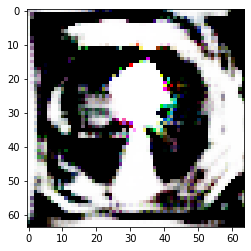

################REAL#################


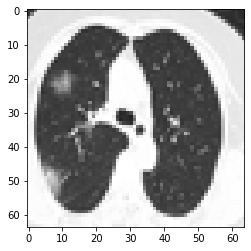

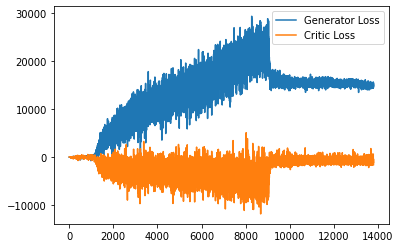

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 824, step 277000: Generator loss: 14821.572720703125, critic loss: -806.3410541563373
################FAKE#################


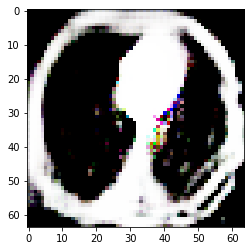

################REAL#################


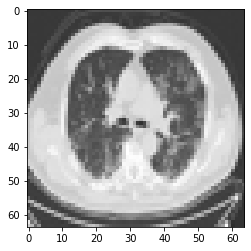

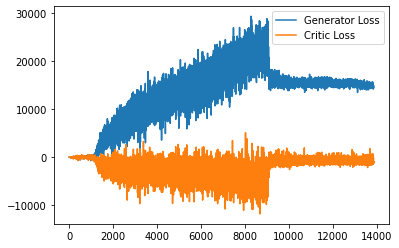

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 827, step 278000: Generator loss: 14772.489625976563, critic loss: -779.5849145517273
################FAKE#################


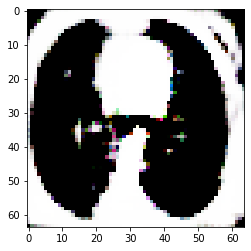

################REAL#################


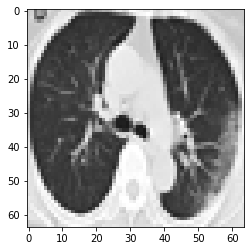

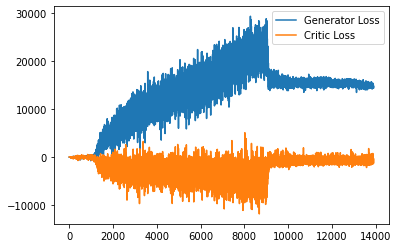

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 830, step 279000: Generator loss: 14798.590564453125, critic loss: -901.3433550763299
################FAKE#################


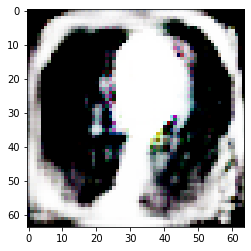

################REAL#################


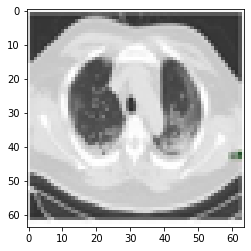

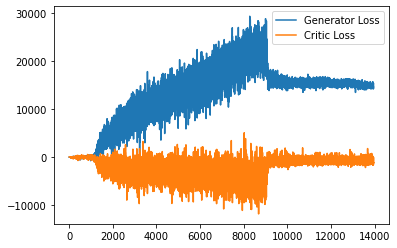

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 833, step 280000: Generator loss: 14720.491043945312, critic loss: -840.9674626168867
################FAKE#################


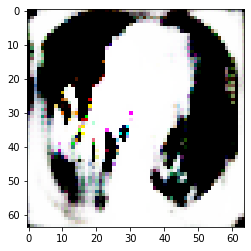

################REAL#################


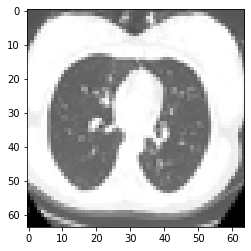

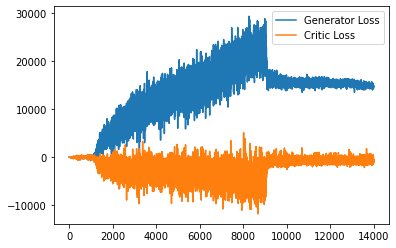

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 836, step 281000: Generator loss: 14649.4039296875, critic loss: -796.1879123003225
################FAKE#################


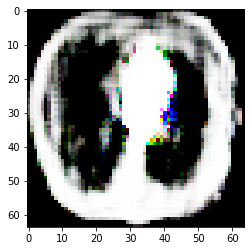

################REAL#################


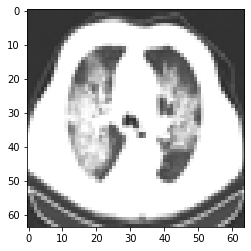

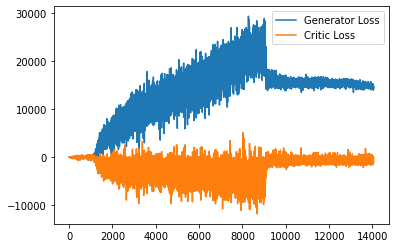

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 839, step 282000: Generator loss: 14661.715359375, critic loss: -900.523125473184
################FAKE#################


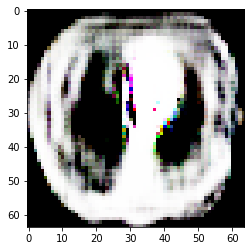

################REAL#################


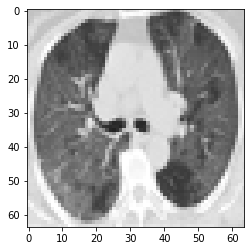

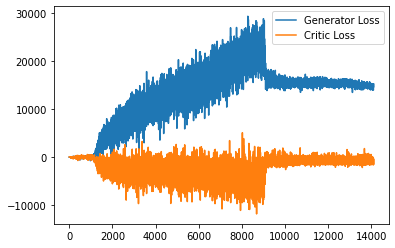

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 842, step 283000: Generator loss: 14598.861259765625, critic loss: -673.088845391273
################FAKE#################


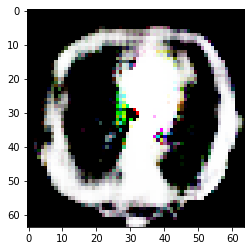

################REAL#################


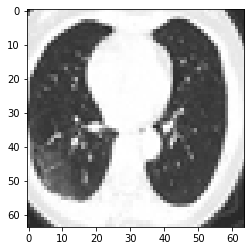

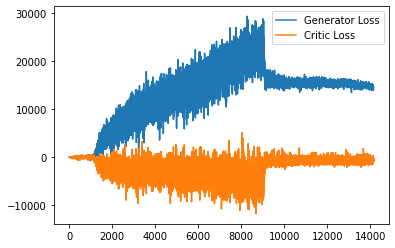

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 845, step 284000: Generator loss: 14485.076290039062, critic loss: -751.2859237906601
################FAKE#################


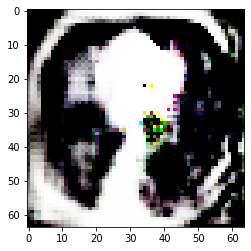

################REAL#################


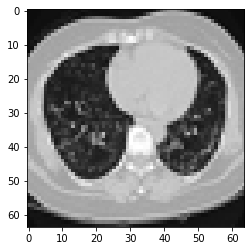

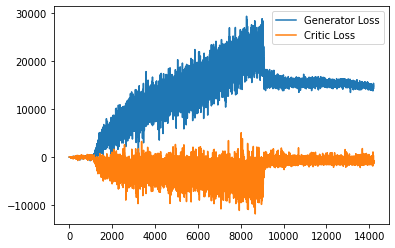

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 848, step 285000: Generator loss: 14565.3739609375, critic loss: -860.5323428750032
################FAKE#################


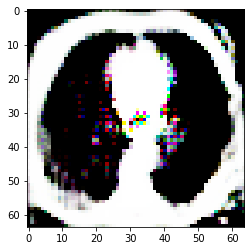

################REAL#################


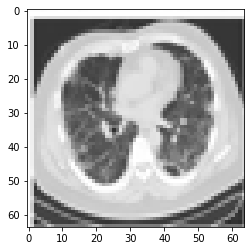

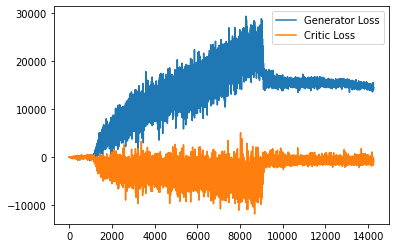

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 851, step 286000: Generator loss: 14693.424918945313, critic loss: -874.9247645472104
################FAKE#################


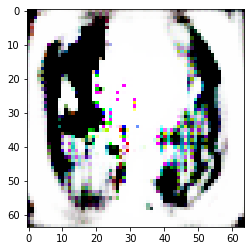

################REAL#################


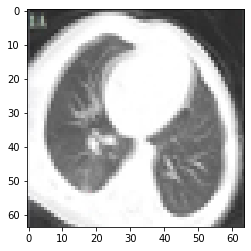

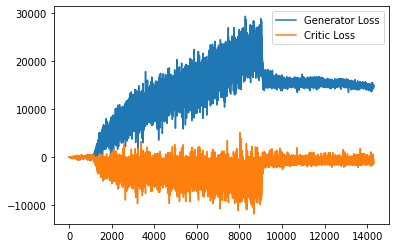

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 854, step 287000: Generator loss: 14660.671860351562, critic loss: -839.7302532810135
################FAKE#################


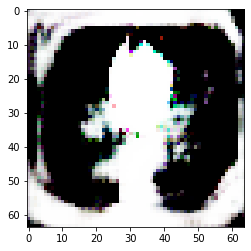

################REAL#################


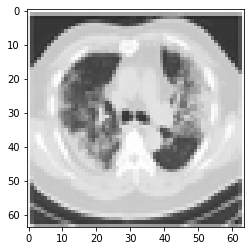

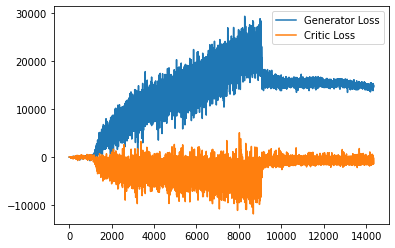

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 857, step 288000: Generator loss: 14729.5473046875, critic loss: -798.1546163505827
################FAKE#################


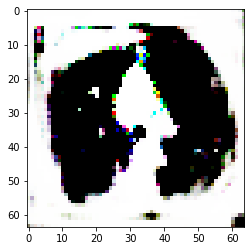

################REAL#################


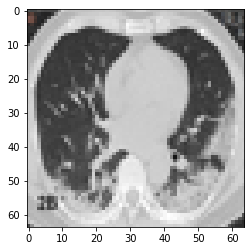

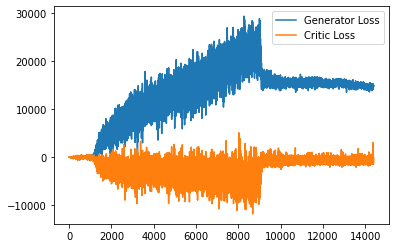

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 860, step 289000: Generator loss: 14600.78791796875, critic loss: -793.4067292391236
################FAKE#################


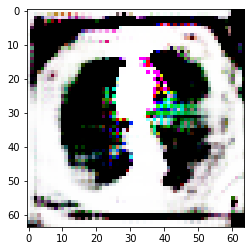

################REAL#################


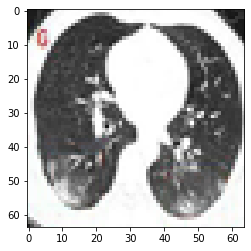

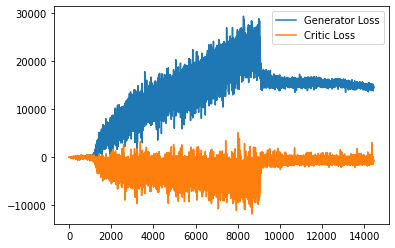

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 863, step 290000: Generator loss: 14533.781265625, critic loss: -759.3700577358524
################FAKE#################


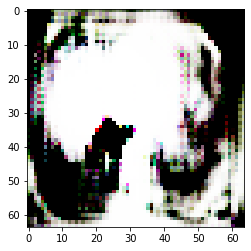

################REAL#################


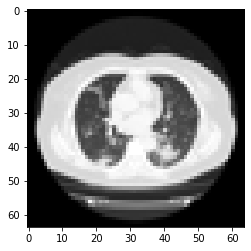

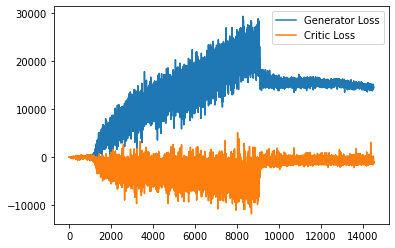

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 866, step 291000: Generator loss: 14434.473743164062, critic loss: -825.8875210902344
################FAKE#################


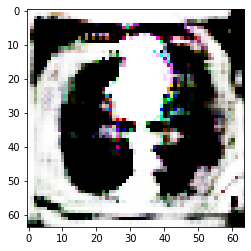

################REAL#################


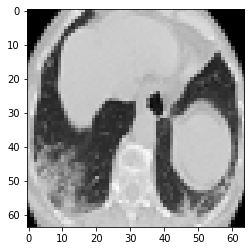

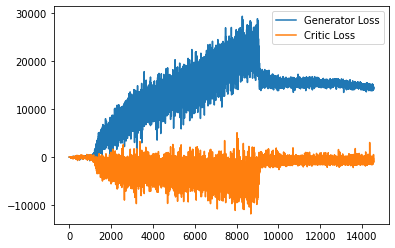

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 869, step 292000: Generator loss: 14608.840763671875, critic loss: -719.2192944433353
################FAKE#################


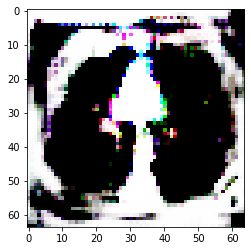

################REAL#################


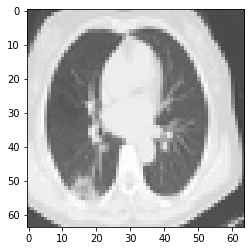

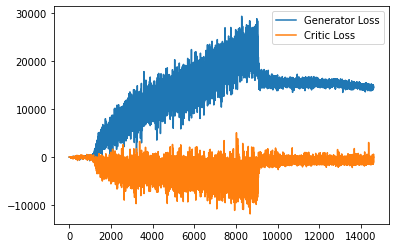

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 872, step 293000: Generator loss: 14645.371225585937, critic loss: -846.0007970505444
################FAKE#################


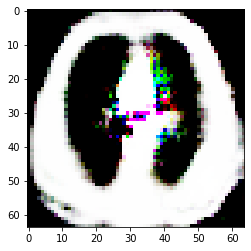

################REAL#################


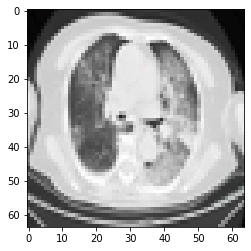

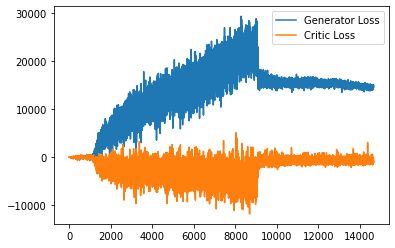

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 875, step 294000: Generator loss: 14622.410594726562, critic loss: -877.0645265187188
################FAKE#################


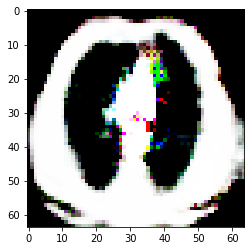

################REAL#################


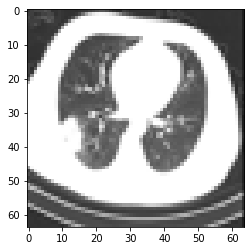

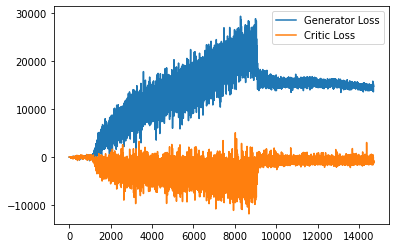

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 877, step 295000: Generator loss: 14336.413536132812, critic loss: -752.3697384589054
################FAKE#################


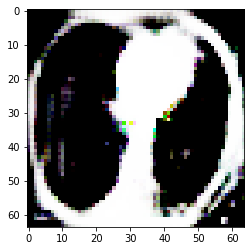

################REAL#################


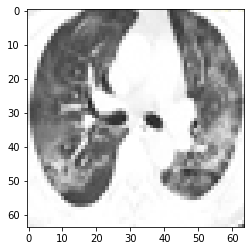

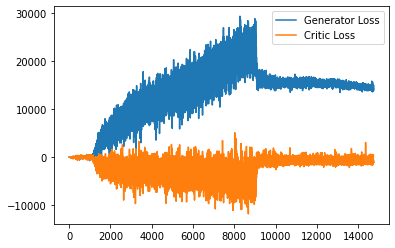

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 880, step 296000: Generator loss: 14438.629171875, critic loss: -913.3104354910162
################FAKE#################


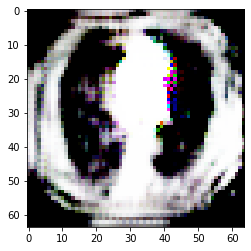

################REAL#################


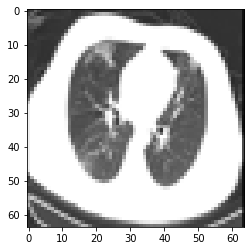

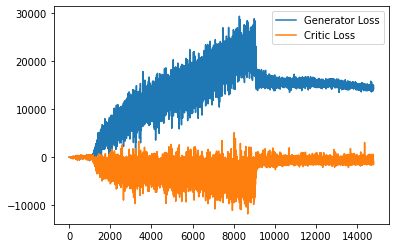

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 883, step 297000: Generator loss: 14405.91576953125, critic loss: -815.5829222626677
################FAKE#################


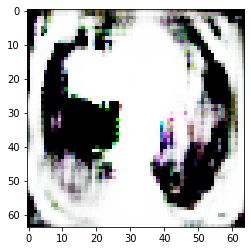

################REAL#################


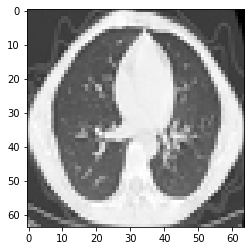

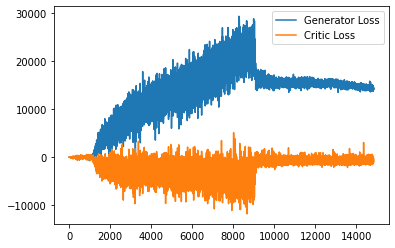

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 886, step 298000: Generator loss: 14389.423413085937, critic loss: -792.2479402483874
################FAKE#################


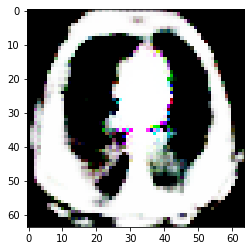

################REAL#################


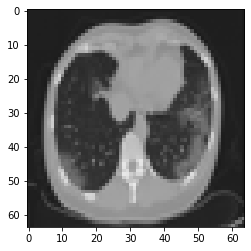

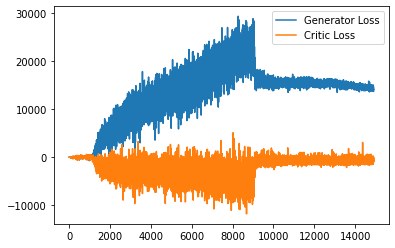

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 889, step 299000: Generator loss: 14513.578508789062, critic loss: -856.9477296409597
################FAKE#################


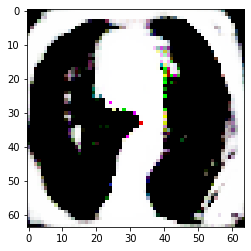

################REAL#################


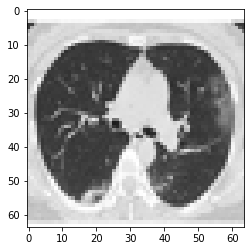

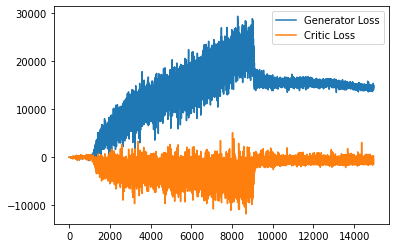

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 892, step 300000: Generator loss: 14428.335920898437, critic loss: -834.4141354764515
################FAKE#################


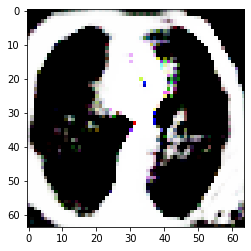

################REAL#################


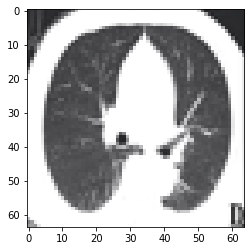

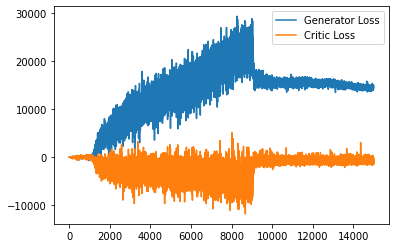

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 895, step 301000: Generator loss: 14378.984508789063, critic loss: -821.1850358562465
################FAKE#################


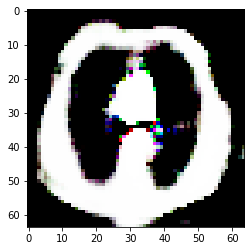

################REAL#################


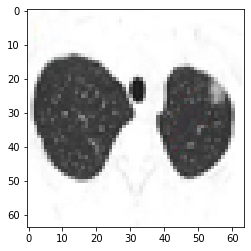

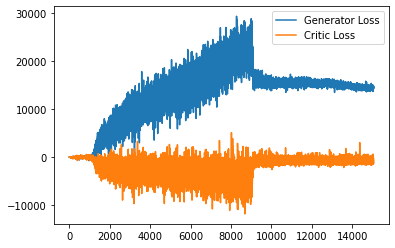

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 898, step 302000: Generator loss: 14351.62840234375, critic loss: -901.5678393700028
################FAKE#################


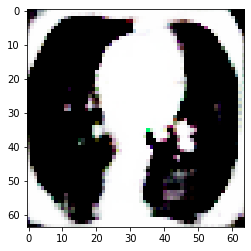

################REAL#################


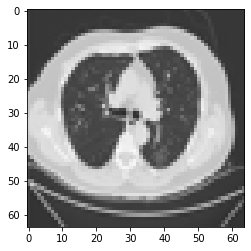

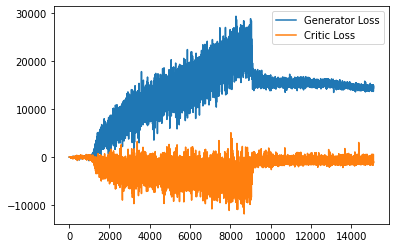

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 901, step 303000: Generator loss: 14481.364334960937, critic loss: -843.816606217317
################FAKE#################


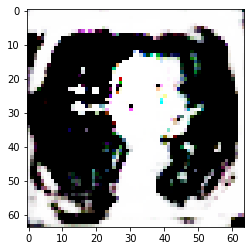

################REAL#################


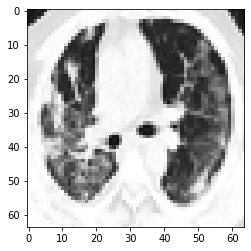

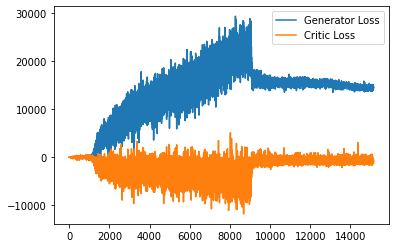

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 904, step 304000: Generator loss: 14476.006872070313, critic loss: -831.0161176074232
################FAKE#################


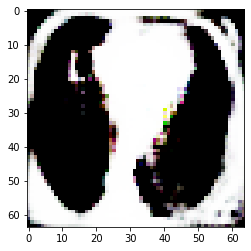

################REAL#################


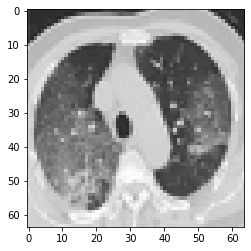

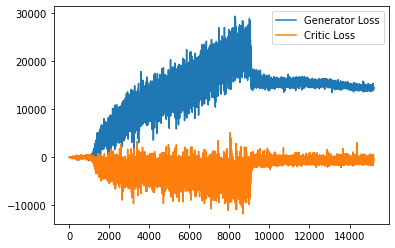

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 907, step 305000: Generator loss: 14340.430677734375, critic loss: -820.2908822736725
################FAKE#################


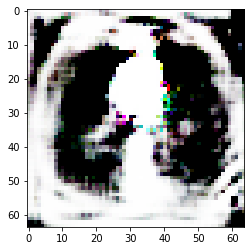

################REAL#################


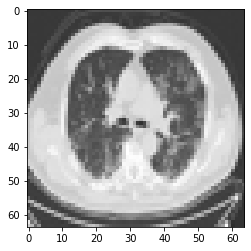

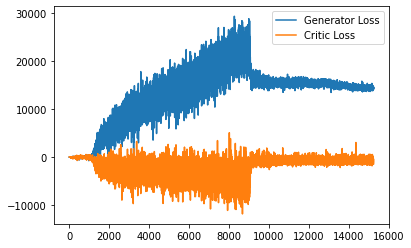

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 910, step 306000: Generator loss: 14377.184185546876, critic loss: -961.3270349106783
################FAKE#################


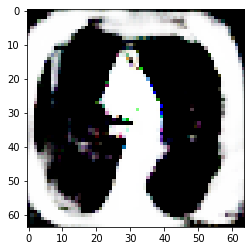

################REAL#################


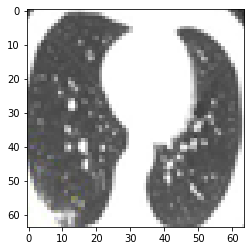

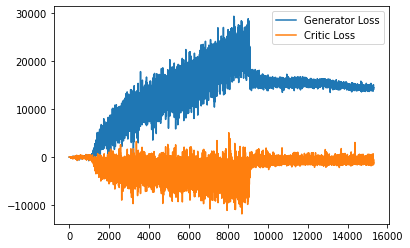

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 913, step 307000: Generator loss: 14374.56596484375, critic loss: -807.206358009407
################FAKE#################


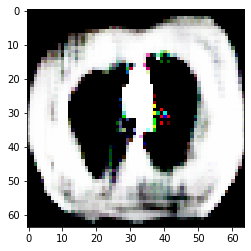

################REAL#################


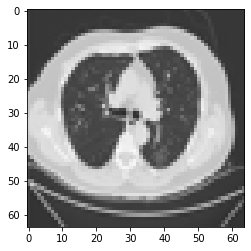

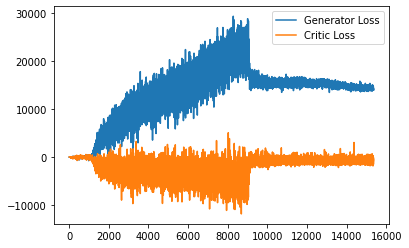

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 916, step 308000: Generator loss: 14390.809069335937, critic loss: -919.3164930401877
################FAKE#################


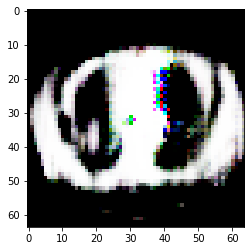

################REAL#################


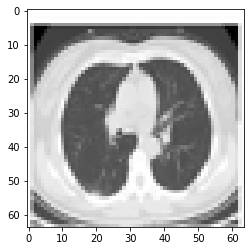

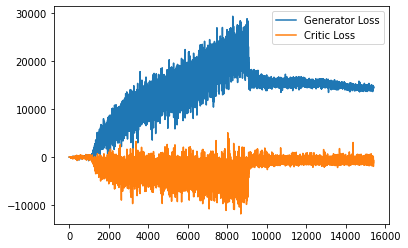

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 919, step 309000: Generator loss: 14488.914728515625, critic loss: -932.7222168308492
################FAKE#################


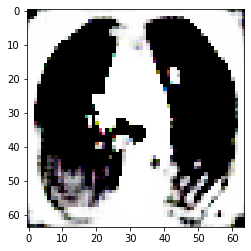

################REAL#################


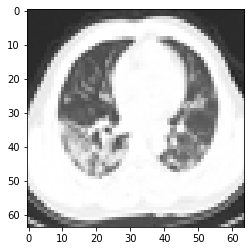

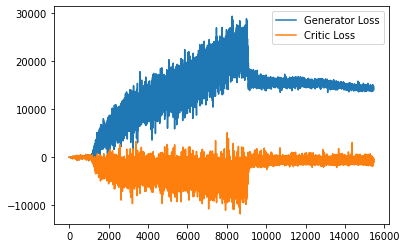

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 922, step 310000: Generator loss: 14420.31971875, critic loss: -919.5546101432533
################FAKE#################


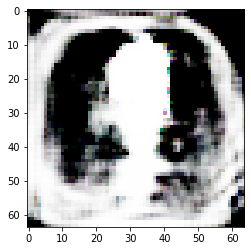

################REAL#################


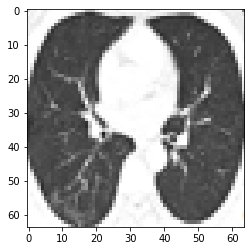

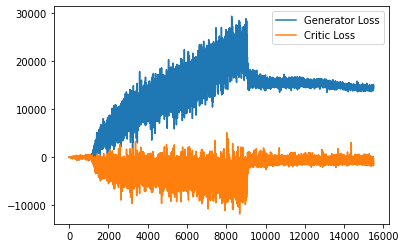

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 925, step 311000: Generator loss: 14393.356272460938, critic loss: -938.1393231039726
################FAKE#################


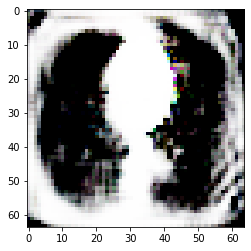

################REAL#################


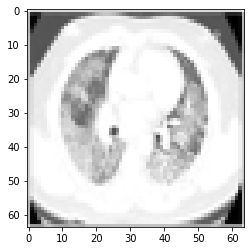

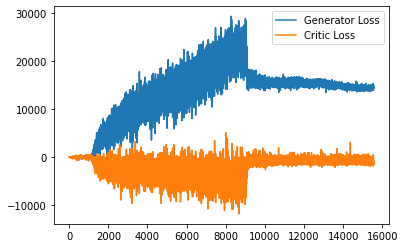

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 928, step 312000: Generator loss: 14422.964966796875, critic loss: -936.285967172283
################FAKE#################


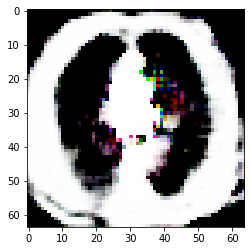

################REAL#################


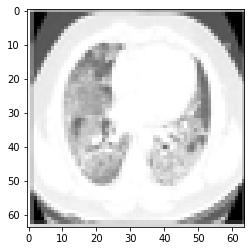

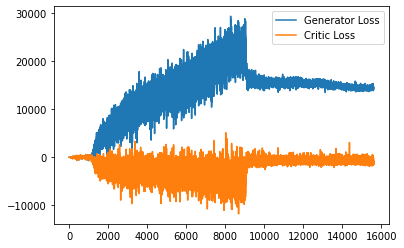

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 931, step 313000: Generator loss: 14487.722521484375, critic loss: -1051.0756816770001
################FAKE#################


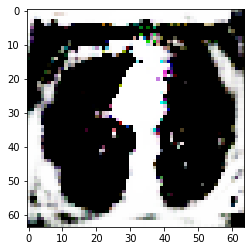

################REAL#################


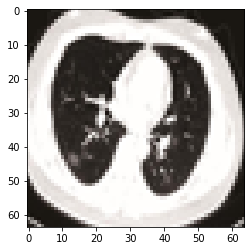

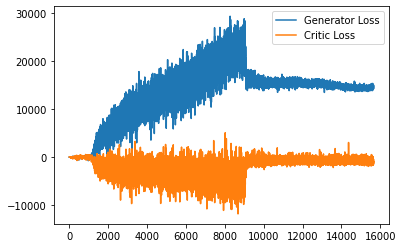

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 934, step 314000: Generator loss: 14394.87671484375, critic loss: -749.8334283313756
################FAKE#################


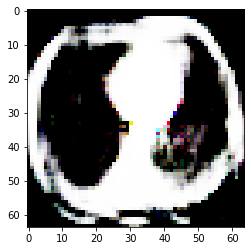

################REAL#################


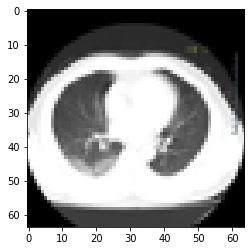

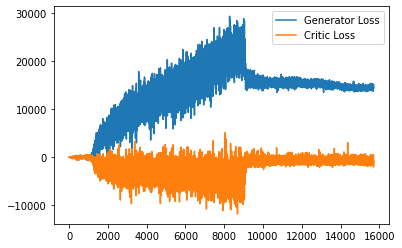

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 937, step 315000: Generator loss: 14316.851536132812, critic loss: -761.1747427526617
################FAKE#################


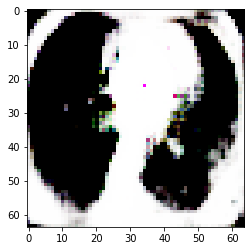

################REAL#################


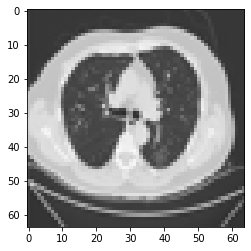

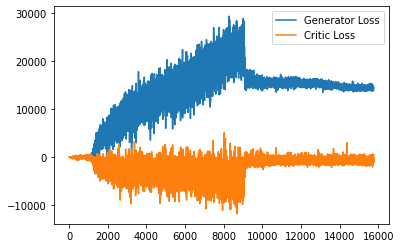

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 940, step 316000: Generator loss: 14528.945267578125, critic loss: -850.6667003159185
################FAKE#################


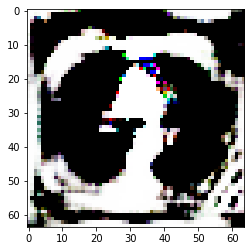

################REAL#################


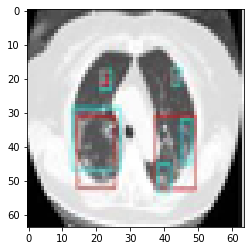

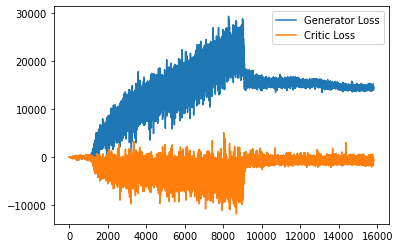

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 943, step 317000: Generator loss: 14370.325098632813, critic loss: -851.6280527140739
################FAKE#################


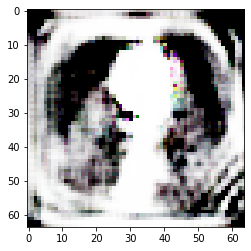

################REAL#################


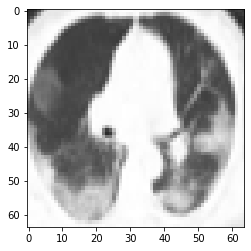

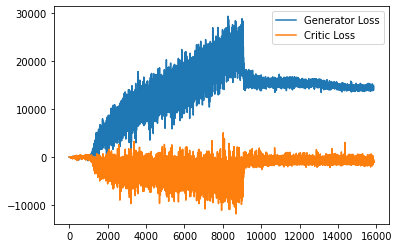

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 946, step 318000: Generator loss: 14424.1936171875, critic loss: -891.8660744543072
################FAKE#################


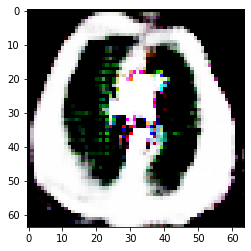

################REAL#################


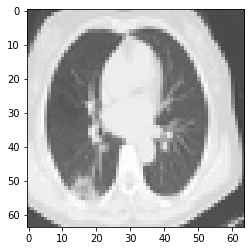

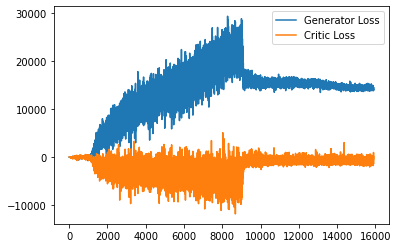

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 949, step 319000: Generator loss: 14189.776362304687, critic loss: -916.3126929797788
################FAKE#################


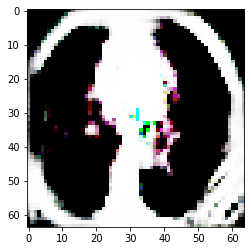

################REAL#################


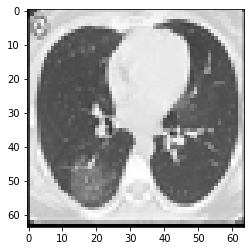

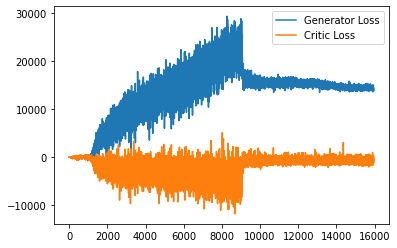

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 952, step 320000: Generator loss: 14370.427431640624, critic loss: -864.4044562447424
################FAKE#################


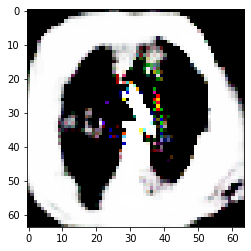

################REAL#################


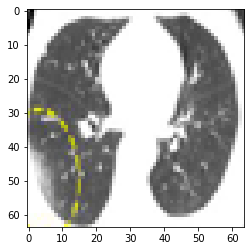

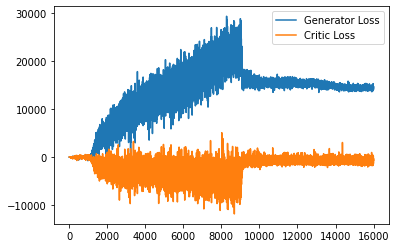

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 955, step 321000: Generator loss: 14305.277350585937, critic loss: -999.417006642683
################FAKE#################


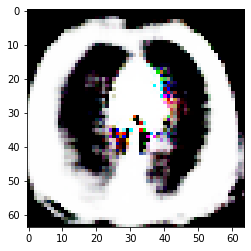

################REAL#################


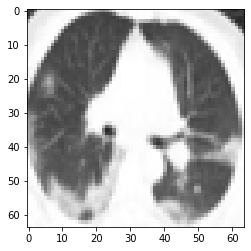

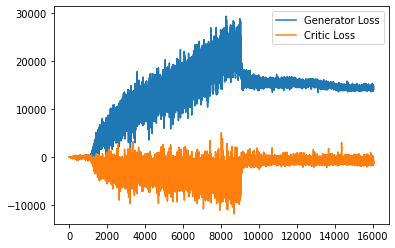

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 958, step 322000: Generator loss: 14198.989796875, critic loss: -794.6604934415818
################FAKE#################


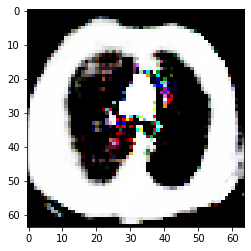

################REAL#################


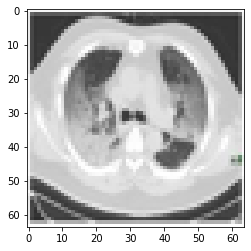

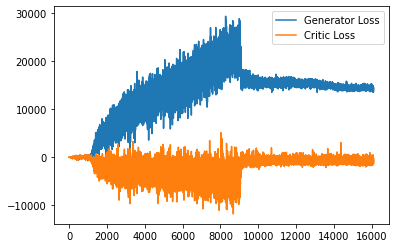

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 961, step 323000: Generator loss: 14364.050220703126, critic loss: -861.616976945876
################FAKE#################


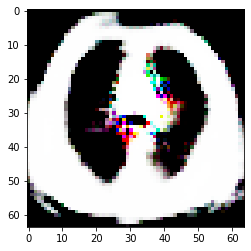

################REAL#################


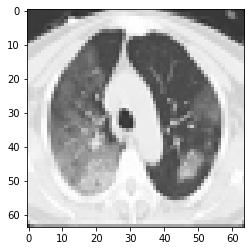

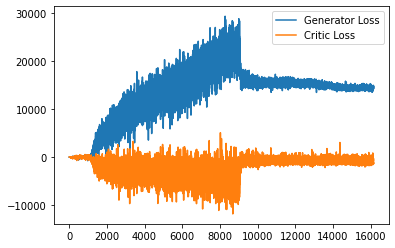

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 964, step 324000: Generator loss: 14520.18991796875, critic loss: -877.6288570221814
################FAKE#################


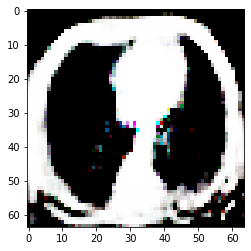

################REAL#################


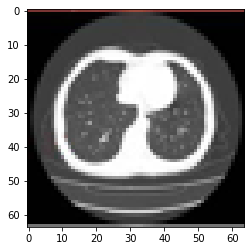

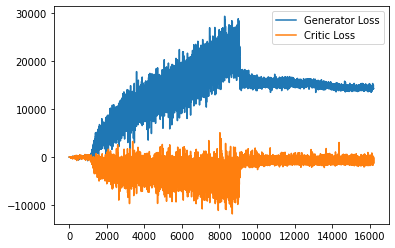

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 967, step 325000: Generator loss: 14351.90278515625, critic loss: -926.3694039681033
################FAKE#################


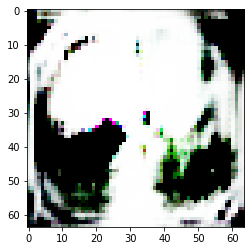

################REAL#################


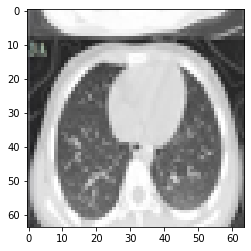

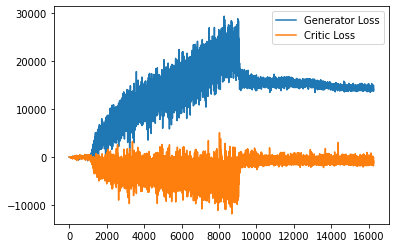

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 970, step 326000: Generator loss: 14299.435361328126, critic loss: -813.6486690695963
################FAKE#################


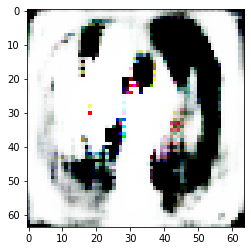

################REAL#################


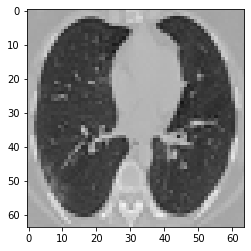

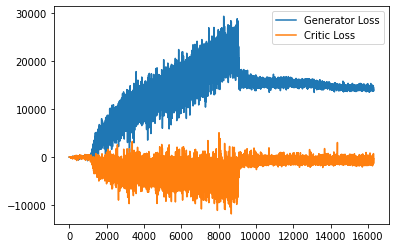

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 973, step 327000: Generator loss: 14416.120333984374, critic loss: -886.2871561989612
################FAKE#################


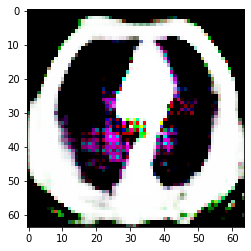

################REAL#################


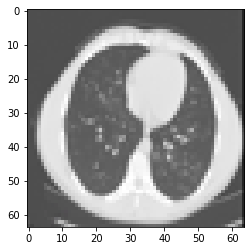

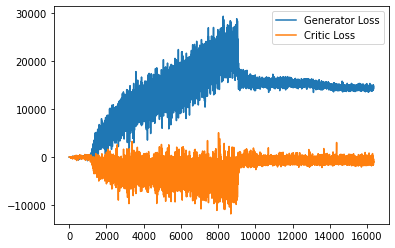

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 976, step 328000: Generator loss: 14368.303491210938, critic loss: -864.5865911027364
################FAKE#################


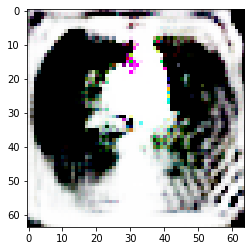

################REAL#################


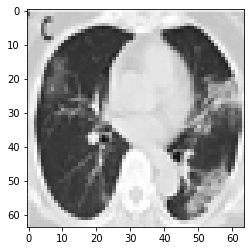

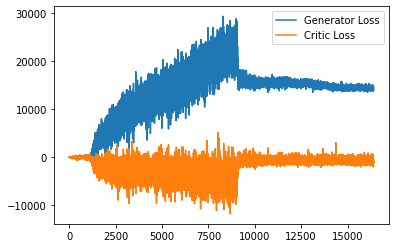

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 979, step 329000: Generator loss: 14108.604640625, critic loss: -833.682150241783
################FAKE#################


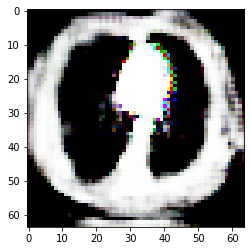

################REAL#################


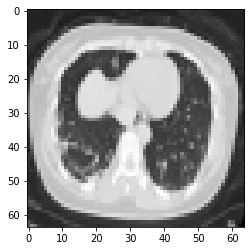

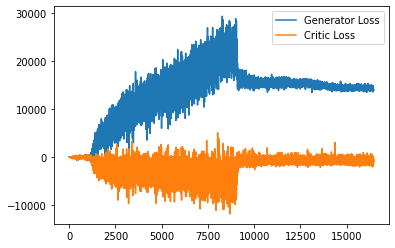

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 982, step 330000: Generator loss: 14360.667336914063, critic loss: -932.1790424436849
################FAKE#################


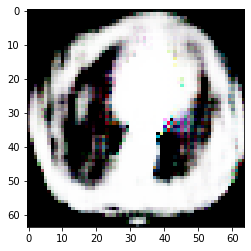

################REAL#################


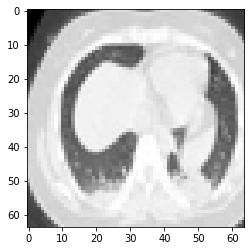

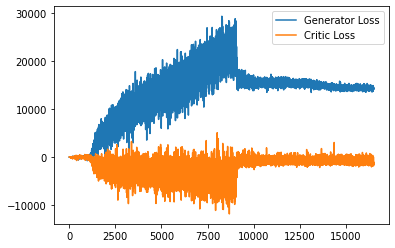

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 985, step 331000: Generator loss: 14384.7189140625, critic loss: -916.6459851830498
################FAKE#################


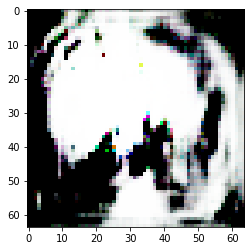

################REAL#################


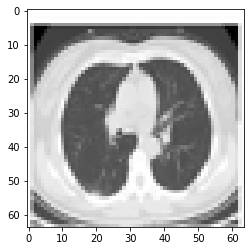

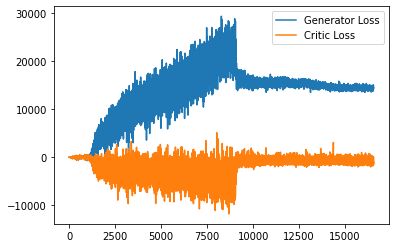

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 988, step 332000: Generator loss: 14344.296463867187, critic loss: -917.1206579546256
################FAKE#################


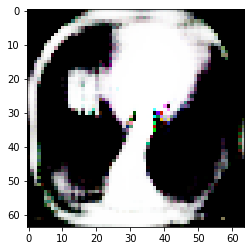

################REAL#################


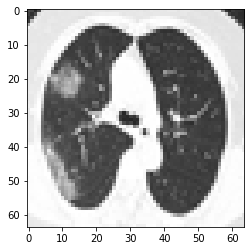

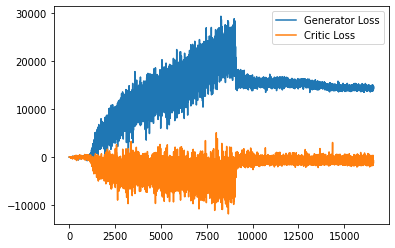

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 991, step 333000: Generator loss: 14292.2997265625, critic loss: -832.3128211299986
################FAKE#################


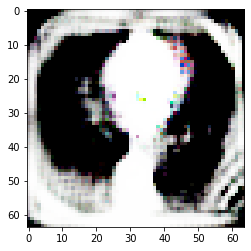

################REAL#################


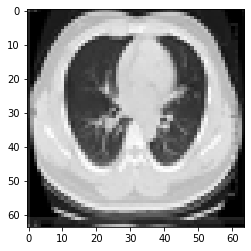

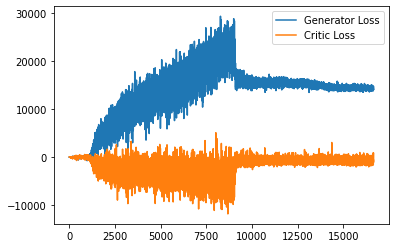

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 994, step 334000: Generator loss: 14452.660008789062, critic loss: -883.1601836023331
################FAKE#################


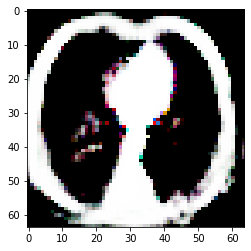

################REAL#################


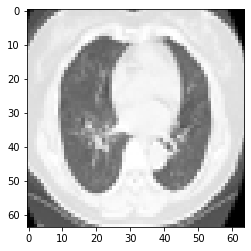

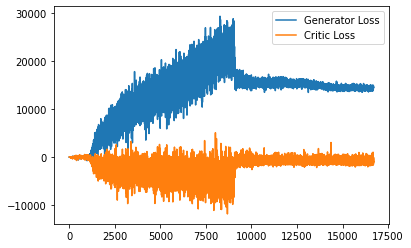

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 997, step 335000: Generator loss: 14418.684250976563, critic loss: -945.5792552309708
################FAKE#################


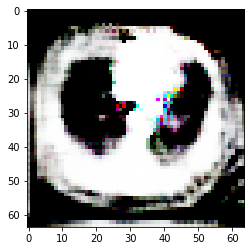

################REAL#################


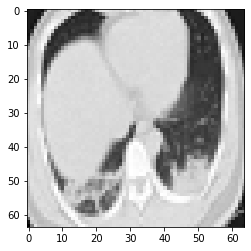

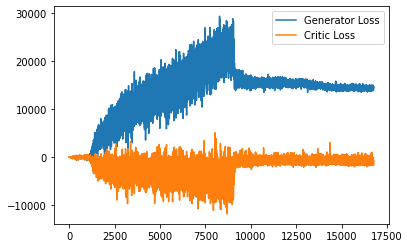

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1000, step 336000: Generator loss: 14268.169205078126, critic loss: -798.7514223364417
################FAKE#################


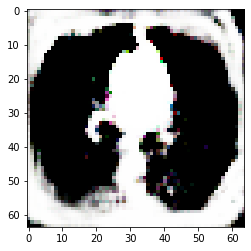

################REAL#################


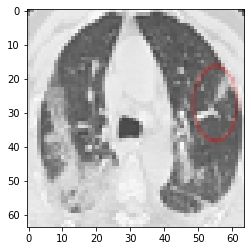

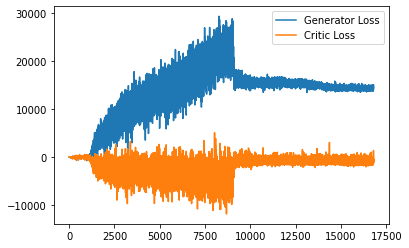

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1002, step 337000: Generator loss: 14212.851995117187, critic loss: -910.37367937054
################FAKE#################


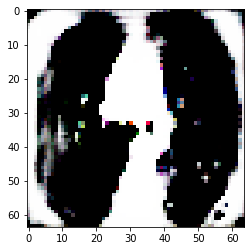

################REAL#################


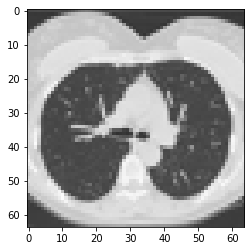

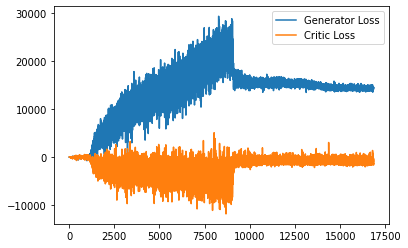

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1005, step 338000: Generator loss: 14445.650466796875, critic loss: -766.1747132413144
################FAKE#################


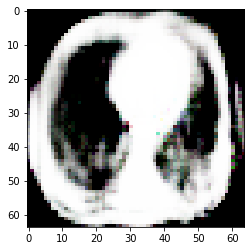

################REAL#################


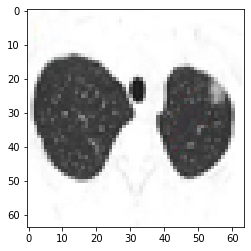

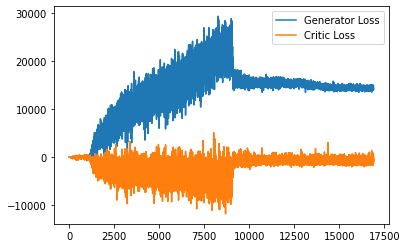

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1008, step 339000: Generator loss: 14484.848063476562, critic loss: -922.8320676567904
################FAKE#################


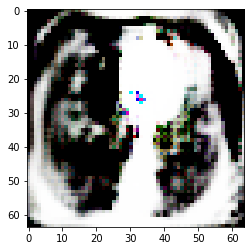

################REAL#################


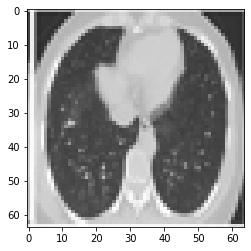

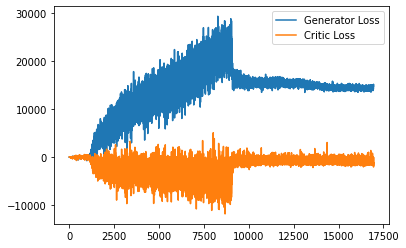

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1011, step 340000: Generator loss: 14502.445197265624, critic loss: -915.404503247244
################FAKE#################


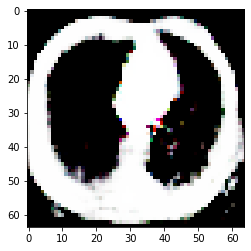

################REAL#################


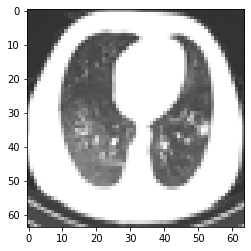

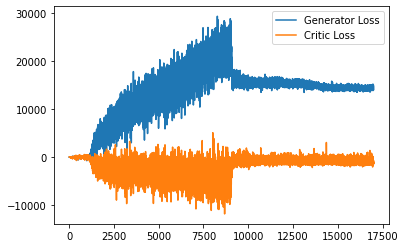

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1014, step 341000: Generator loss: 14485.256012695312, critic loss: -786.5645657454907
################FAKE#################


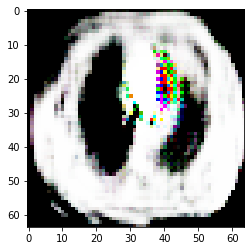

################REAL#################


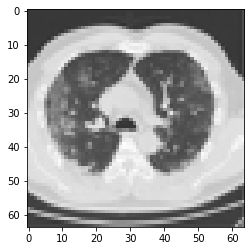

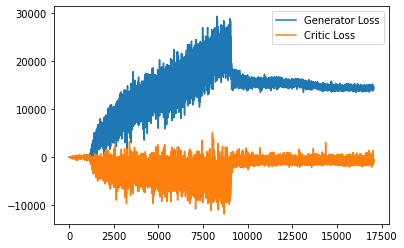

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1017, step 342000: Generator loss: 14381.48051171875, critic loss: -821.7441405229397
################FAKE#################


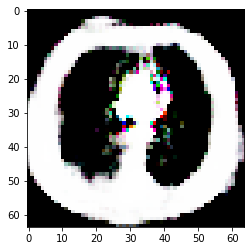

################REAL#################


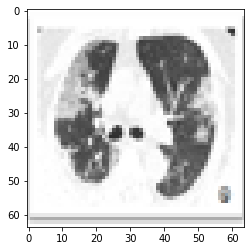

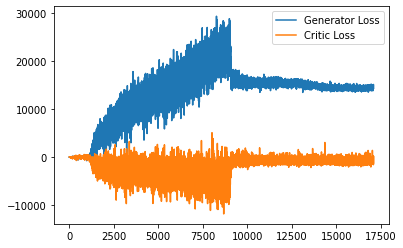

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1020, step 343000: Generator loss: 14363.895705078125, critic loss: -953.6081441185817
################FAKE#################


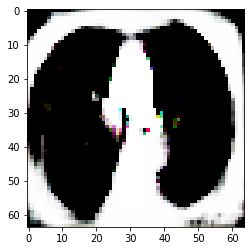

################REAL#################


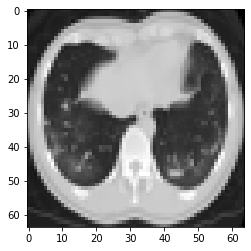

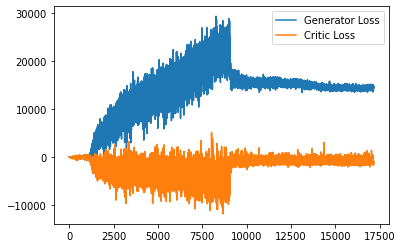

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1023, step 344000: Generator loss: 14353.289513671874, critic loss: -881.3556092776557
################FAKE#################


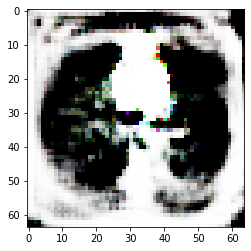

################REAL#################


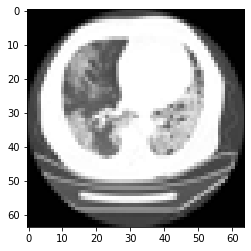

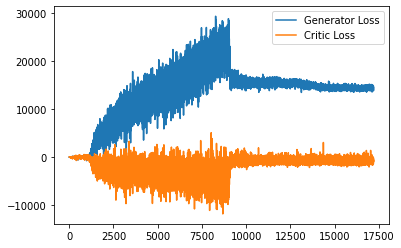

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1026, step 345000: Generator loss: 14290.7489375, critic loss: -801.9504581039289
################FAKE#################


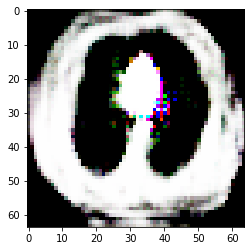

################REAL#################


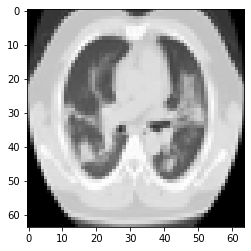

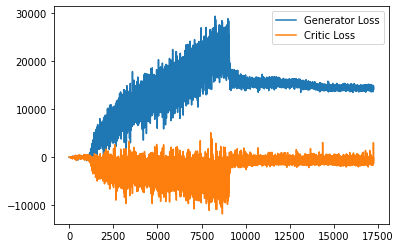

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1029, step 346000: Generator loss: 14239.647629882813, critic loss: -841.9453378103123
################FAKE#################


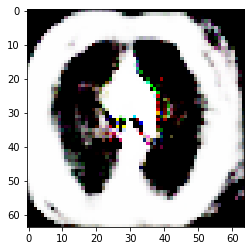

################REAL#################


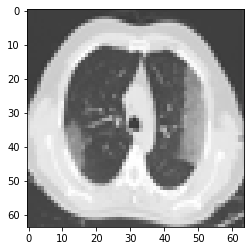

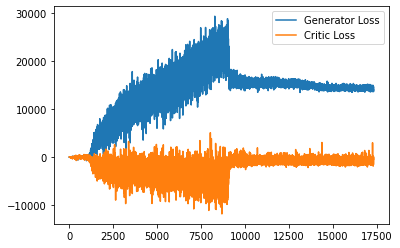

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1032, step 347000: Generator loss: 14371.8358671875, critic loss: -851.1080203559056
################FAKE#################


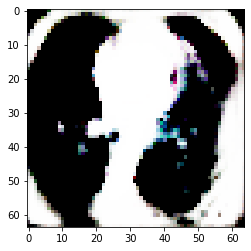

################REAL#################


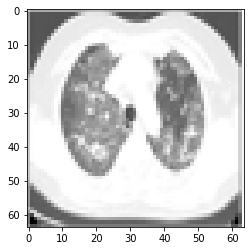

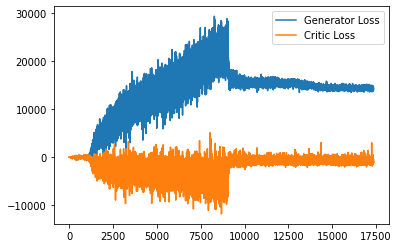

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1035, step 348000: Generator loss: 14407.40966015625, critic loss: -861.502974898474
################FAKE#################


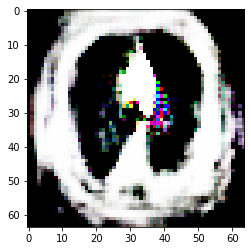

################REAL#################


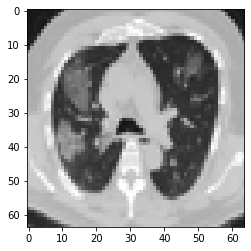

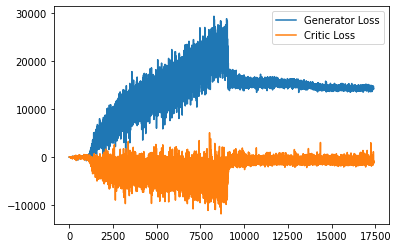

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1038, step 349000: Generator loss: 14351.18116015625, critic loss: -854.1223874572013
################FAKE#################


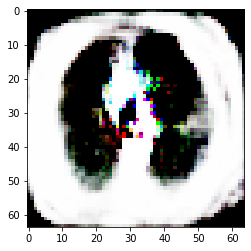

################REAL#################


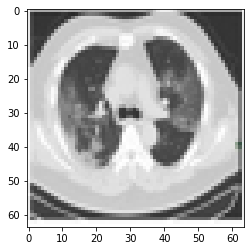

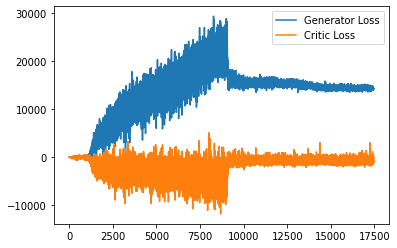

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1041, step 350000: Generator loss: 14319.9100234375, critic loss: -866.8193516080552
################FAKE#################


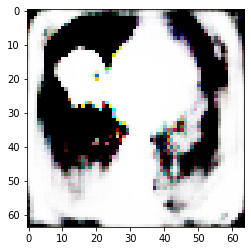

################REAL#################


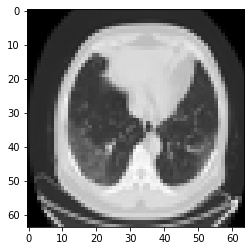

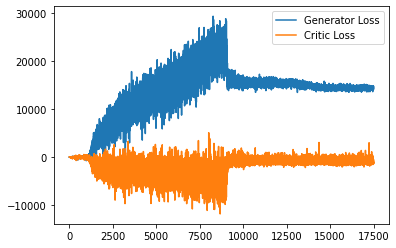

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1044, step 351000: Generator loss: 14344.726106445312, critic loss: -898.8405650877954
################FAKE#################


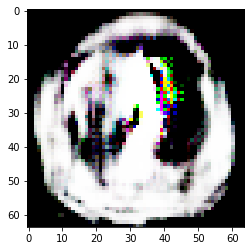

################REAL#################


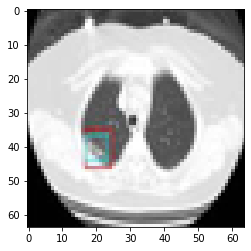

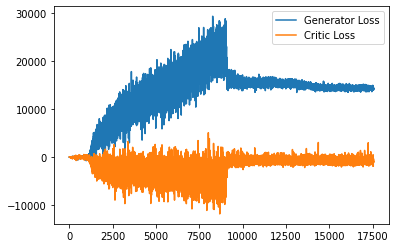

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1047, step 352000: Generator loss: 14301.231657226563, critic loss: -965.4853849711408
################FAKE#################


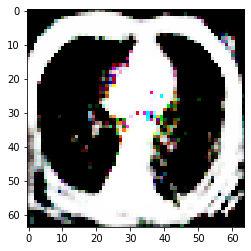

################REAL#################


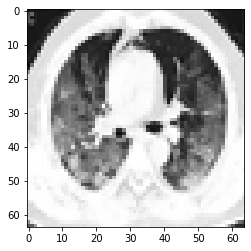

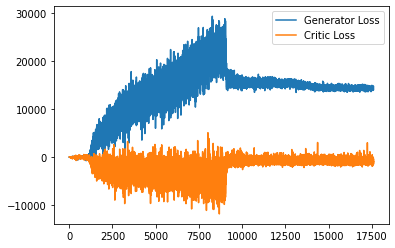

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1050, step 353000: Generator loss: 14359.368850585937, critic loss: -905.4681370713366
################FAKE#################


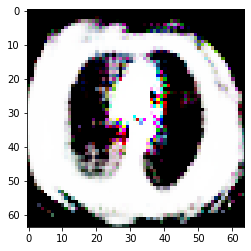

################REAL#################


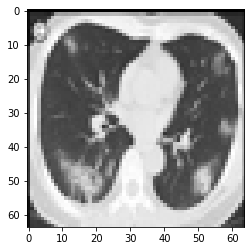

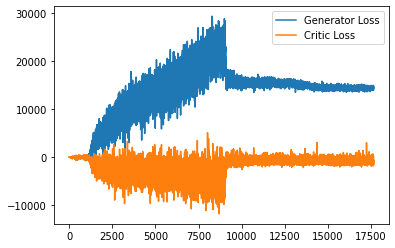

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1053, step 354000: Generator loss: 14206.01833203125, critic loss: -832.8938365022451
################FAKE#################


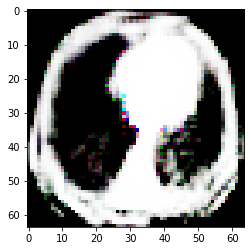

################REAL#################


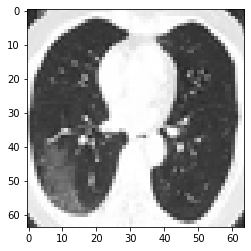

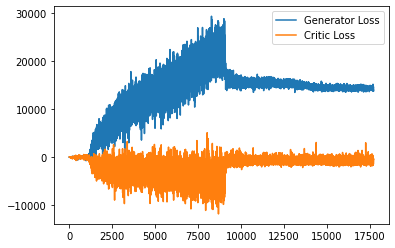

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1056, step 355000: Generator loss: 14134.9977578125, critic loss: -816.4931734580999
################FAKE#################


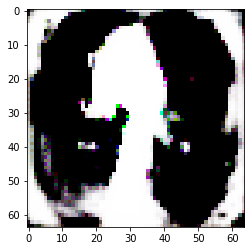

################REAL#################


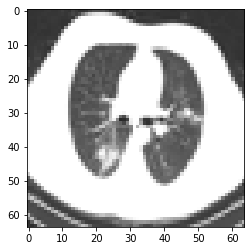

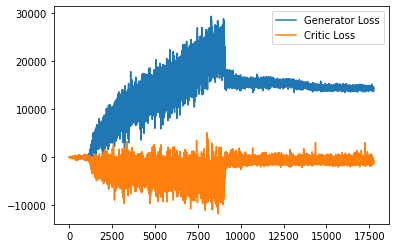

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1059, step 356000: Generator loss: 14150.5289375, critic loss: -846.9927370854441
################FAKE#################


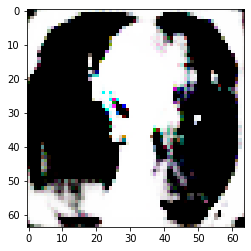

################REAL#################


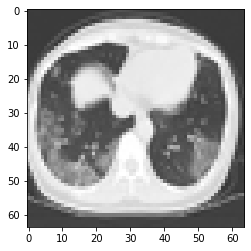

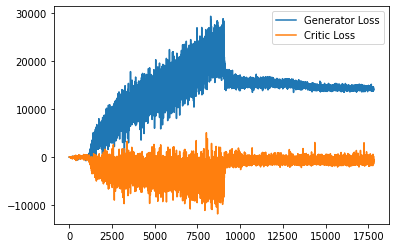

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1062, step 357000: Generator loss: 14137.66548828125, critic loss: -882.2909716754122
################FAKE#################


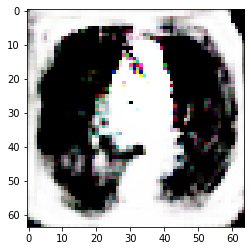

################REAL#################


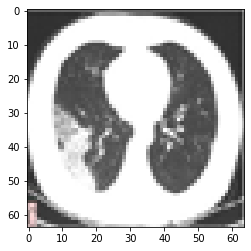

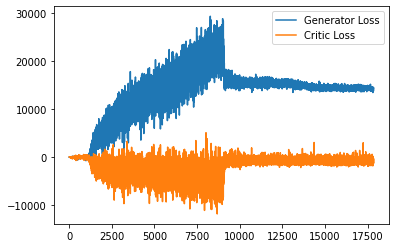

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1065, step 358000: Generator loss: 14008.786256835938, critic loss: -756.2555426860863
################FAKE#################


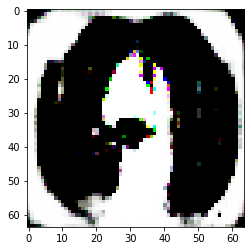

################REAL#################


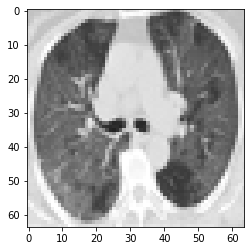

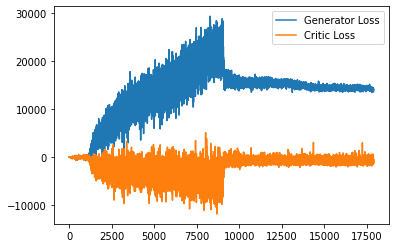

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1068, step 359000: Generator loss: 14128.530716796875, critic loss: -864.3796124976449
################FAKE#################


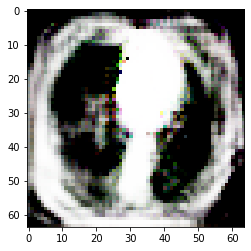

################REAL#################


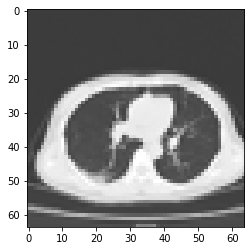

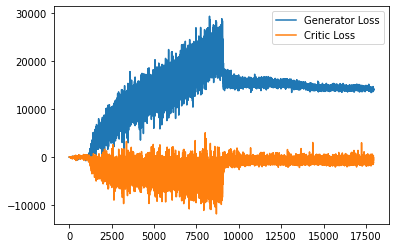

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1071, step 360000: Generator loss: 14001.081356445313, critic loss: -872.8392049457696
################FAKE#################


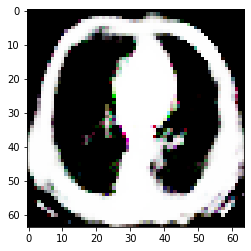

################REAL#################


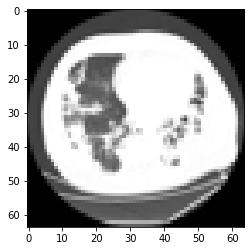

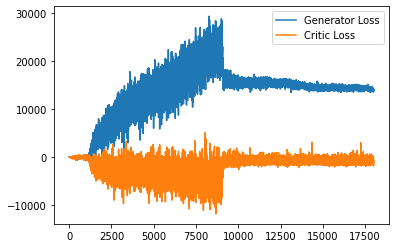

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

  0%|          | 0/336 [00:00<?, ?it/s]

Epoch 1074, step 361000: Generator loss: 13925.8262109375, critic loss: -784.4350355381965
################FAKE#################


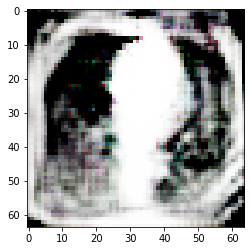

################REAL#################


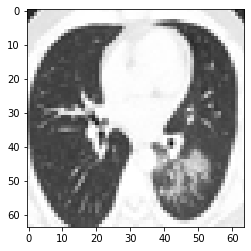

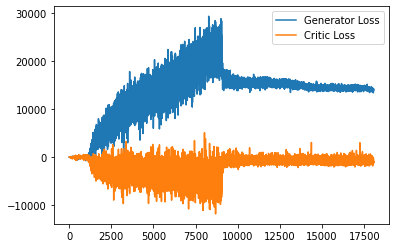

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []


for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _, _ in tqdm(train_dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)

            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)


            if (len(real.shape) > 3) and(real.shape[3] == 3) :
                real = real.permute(0,3,1,2)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss] #.detach() new

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)

        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            torch.save(gen.state_dict(), PATH_GENERATOR)
            torch.save(crit.state_dict(), PATH_CRITIC)
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            print('################FAKE#################')
            show_tensor_images(fake)
            print('################REAL#################')
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1


# Save and Load the model

In [ ]:
#Save model

#torch.save(gen.state_dict(), PATH_GENERATOR)
#torch.save(crit.state_dict(), PATH_CRITIC)

In [ ]:
#Load Model

#myLoadedGenerator = Generator(z_dim).to(device)
#myLoadedGenerator.load_state_dict(torch.load(PATH_GENERATOR))

In [ ]:
#Generate fake image and display it

#predictedFake = myLoadedGenerator.forward(get_noise(cur_batch_size, z_dim, device=device))
#show_tensor_images(predictedFake)
